<a href="https://colab.research.google.com/github/KarimELMERNISSI/MetaboSign/blob/main/Concentrations_et_classif_last_version.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# IA et signature métabolomique de malignité
### (1) Approche sur concentrations des 6 molécules d'intérêt 
--> voir intro

## Importation des librairies nécessaire aux traitements

### installation supp

In [ ]:
!pip install --upgrade scikit-learn

In [ ]:
!pip install xgboost

     ---------------------------------------- 0.0/70.9 MB ? eta -:--:--
     ---------------------------------------- 0.5/70.9 MB 15.7 MB/s eta 0:00:05
     - -------------------------------------- 2.0/70.9 MB 25.5 MB/s eta 0:00:03
     -- ------------------------------------- 3.7/70.9 MB 29.2 MB/s eta 0:00:03
     -- ------------------------------------- 5.3/70.9 MB 30.7 MB/s eta 0:00:03
     --- ------------------------------------ 6.6/70.9 MB 32.4 MB/s eta 0:00:02
     ---- ----------------------------------- 8.0/70.9 MB 33.8 MB/s eta 0:00:02
     ----- ---------------------------------- 9.6/70.9 MB 33.9 MB/s eta 0:00:02
     ------ -------------------------------- 11.4/70.9 MB 36.4 MB/s eta 0:00:02
     ------- ------------------------------- 13.1/70.9 MB 36.4 MB/s eta 0:00:02
     -------- ------------------------------ 14.7/70.9 MB 36.4 MB/s eta 0:00:02
     --------- ----------------------------- 16.6/70.9 MB 36.3 MB/s eta 0:00:02
     ---------- ---------------------------- 18.

In [ ]:
!pip install shap

     ---------------------------------------- 0.0/435.6 kB ? eta -:--:--
     ------------------------------------- 435.6/435.6 kB 13.7 MB/s eta 0:00:00


In [ ]:
#print my nb into pdf files
!pip install nbconvert

### Appel des bibliothèques requises pour nos traitements

In [ ]:
import sys
sys.version

'3.9.16 (main, Mar  8 2023, 10:39:24) [MSC v.1916 64 bit (AMD64)]'

In [ ]:
import sklearn
print(sklearn.__version__)

1.2.2


In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import FunctionTransformer
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import PCA
from sklearn.cluster import FeatureAgglomeration
from sklearn.compose import ColumnTransformer
from sklearn.compose import make_column_selector, make_column_transformer
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import Normalizer
from sklearn import set_config
from sklearn.metrics import classification_report
from sklearn import config_context
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import make_scorer # pour implémenter ses propres métriques
from sklearn.metrics import accuracy_score # importation de la metrique accuracy_score
from sklearn.metrics import f1_score # f1-score
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import learning_curve
from sklearn.tree import plot_tree
import re
from pickle import dump
from pickle import load

In [ ]:
#store my functions to transfer my pipelines to my webapp 
import utils_transformers

## Importation du fichier CSV dans un dataFrame pendas


In [ ]:
data = pd.read_csv("data_metabo.csv", sep=";")

## Création des jeux d'entrainement et de test
- Séparation des variables explicatives $X$ et de la variable cible $y$
- Division de $X$ et $y$ en jeu d'entrainement ($X_{train}$,$y_{train}$) et de test ($X_{test}$,$y_{test}$)

In [ ]:
X, y = data.loc[:, data.columns != 'label'], data.loc[:, data.columns == 'label']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, stratify=y,  random_state=42)

## Description du jeu de données ($X_{train}$,$y_{train}$)
- Visualisation du contenu de $X_{train}$ et de $y_{train}$
- Nature des données (info)
- Statistiques descriptives

NB : Seules 5 variables sont considérées numériques à cause d'irrégularités dans les relevés ("< seuil" si en dessous du seuil de sensibilité de l'appareil pour mesurer la molécule concernée)

In [ ]:
X_train

,id,sexe,age,cortisol,composé S,17OHP,Delta4A,Testostérone,Progestérone
20,21-035,F,49,422.40,2.068,1.852,0.950,0.49,0.557
30,22-009,F,36,401.80,3.410,1.71,1.820,0.48,3.488
0,20-015,F,44,327.00,1.070,0.329,0.566,0.46,0.147
13,20-007,M,75,917.70,43.450,7.1,33.740,10.074,0.563
27,21-042,M,71,429.30,0.940,3.923,0.967,19.46,0.354
6,21-023,F,47,423.20,91.000,19.62,38.440,47.8,0.335
7,20-014,M,58,536.60,12.470,2.55,12.130,3.11,0.44
12,21-029,F,26,574.44,5.099,1.123,3.795,0.749,0.278
23,21-032,M,46,592.80,10.090,4.21,8.852,3.651,0.723
11,20-008,M,65,328.90,10.040,1.17,1.540,7.76,0.386


In [ ]:
y_train

,label
20,0
30,0
0,0
13,1
27,0
6,1
7,1
12,0
23,1
11,1


In [ ]:
X_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 27 entries, 20 to 25
Data columns (total 9 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   id            27 non-null     object 
 1   sexe          27 non-null     object 
 2   age           27 non-null     int64  
 3   cortisol      27 non-null     float64
 4   composé S     27 non-null     float64
 5   17OHP         27 non-null     object 
 6   Delta4A       27 non-null     float64
 7   Testostérone  27 non-null     object 
 8   Progestérone  27 non-null     object 
dtypes: float64(3), int64(1), object(5)
memory usage: 2.1+ KB


In [ ]:
X_train.describe()

,age,cortisol,composé S,Delta4A
count,27.000000,27.000000,27.000000,27.000000
mean,54.629630,525.594074,18.251741,12.958222
std,15.894237,216.313622,29.721558,36.247396
min,26.000000,172.800000,0.408000,0.560000
25%,44.000000,412.100000,2.415500,0.958500
50%,58.000000,501.400000,5.099000,1.930000
75%,65.500000,583.620000,14.520000,9.296000
max,91.000000,1126.400000,118.700000,188.150000


## Création des différents transformers nécessaires à la génération notre Pipeline de préparation des données

### Liste des variables à considérer pour nos différentes étapes de préparation des données

In [ ]:
columns_to_drop = ['id']
categorical_features = ['sexe']
numerical_features = ['age'] # pas de overlap avec le cross features
cross_featuring_candidates = ['cortisol','composé S','17OHP','Delta4A','Testostérone','Progestérone'] 
#columns_to_normalize = ['age','cortisol','composé S','17OHP','Delta4A','Testostérone','Progestérone','cortisolxcomposé S','cortisol/composé S','cortisolx17OHP','cortisol/17OHP','cortisolxDelta4A','cortisol/Delta4A','cortisolxTestostérone','cortisol/Testostérone','cortisolxProgestérone','cortisol/Progestérone','composé Sx17OHP','composé S/17OHP','composé SxDelta4A','composé S/Delta4A','composé SxTestostérone','composé S/Testostérone','composé SxProgestérone','composé S/Progestérone','17OHPxDelta4A','17OHP/Delta4A','17OHPxTestostérone','17OHP/Testostérone','17OHPxProgestérone','17OHP/Progestérone','Delta4AxTestostérone','Delta4A/Testostérone','Delta4AxProgestérone','Delta4A/Progestérone','TestostéronexProgestérone','Testostérone/Progestérone']

# make_column_selector(dtype_include=object)

### Numérisation de variables "catégorielles"
NB : nécessaire pour les modèles

In [ ]:
categorical_transformer = Pipeline(
    steps=[
        ('imp_mode', SimpleImputer(strategy='most_frequent')),
        ('one_hot', OneHotEncoder(handle_unknown="ignore", drop='if_binary'))
    ])

### Traitement et conversion des valeurs "numériques" irrégulières

In [ ]:
def num_encoder(df):
    for col in df.columns:
        df[col] = df[col].replace(to_replace=r'^<(.*)$', value=r'\1', regex=True)
        df[col] = df[col].apply(pd.to_numeric, errors='ignore')
    return df

def num_round(df):
    for col in df.columns:
        df[col] = df[col].round(decimals=4)
    return df

round_transformer = Pipeline(steps=[
    ('round', FunctionTransformer(num_round))
    ])

numerical_transformer = Pipeline(steps=[
    ('num', FunctionTransformer(num_encoder)), 
    ('imputer', SimpleImputer(strategy='mean'))
    ])

### Supression des variables non pertinentes

In [ ]:
def columns_drop(df):
    for col in df.columns:
        df = df.drop(col,axis=1)
        #print('drop ',col)
    return df

#columns_dropper = Pipeline(steps=[('drop', FunctionTransformer(columns_drop))])

### Cross Features - variables synthétiques pour "traduire des intérations" entre nos variables d'entrée

In [ ]:
class DataframeFunctionTransformer():
    def __init__(self, func):
        self.func = func

    def transform(self, input_df, **transform_params):
        return self.func(input_df)

    def fit(self, X, y=None, **fit_params):
        return self

In [ ]:
def cross_features(data, strategy='all'):
    df = pd.DataFrame(data,columns=cross_featuring_candidates)
    df_ref=df.copy()
    for feature_i in df_ref.columns[:-1]:
        for feature_j in df_ref.columns[df_ref.columns.get_loc(feature_i)+1:]:
            if strategy == 'multiply':
                feature_name=feature_i+"x"+feature_j
                df[feature_name] = df[feature_i]*df[feature_j]
            elif strategy == 'divide':
                feature_name = feature_i+"/"+feature_j
                df[feature_name] = df[feature_i]/df[feature_j]
            else :
                feature_name_mult = feature_i+"x"+feature_j
                feature_name_div = feature_i+"/"+feature_j
                df[feature_name_mult] = df[feature_i]*df[feature_j]
                df[feature_name_div] = df[feature_i]/df[feature_j]
    return df

def cross_features_mult(data):
    return cross_features(data, strategy='multiply')

def cross_features_div(data):
    return cross_features(data, strategy='divide')

def cross_features_all(data):
    return cross_features(data, strategy='all')

def cross_features_pipeline(strategy='all'):
    if strategy == 'multiply':
        return Pipeline(steps=[("numerize", numerical_transformer),("cross_features", DataframeFunctionTransformer(cross_features_mult))])
    elif strategy == 'divide':
        return Pipeline(steps=[("numerize", numerical_transformer),("cross_features", DataframeFunctionTransformer(cross_features_div))])      
    else :
        return Pipeline(steps=[("numerize", numerical_transformer),("cross_features", DataframeFunctionTransformer(cross_features_all))])

#NB : for these usecase I limited to the 'all' strategy, further development needed to adapt the other in the pipeline generator (nb: use transform_params={"strategy":x} to pass arg to the function)
crossfeatures_transformer = cross_features_pipeline(strategy='all')

### Relative Scaling
NB : rescaling relatif entre les variables d'un même individu (hypothèse :  Est-il plus discriminant de s'intéresser à la répartition "relative" des concentrations hormonales et variables dérivées d'un individu plutôt qu'à leur valeurs réelles ?)

In [ ]:
relativ_norm_transformer = Pipeline(steps=[('line_norm', Normalizer(norm='l2'))])

### Fonction pour générer les noms des variables correspondant à la sortie de notre pipeline
NB : nécessaire pour reconstituer notre dataframe avec le nom des colonnes / à coupler avec la fonction de création de df

In [ ]:
def column_names_out(X, columns_to_drop=None, categorical_features=None, cf_candidates=None, strategy='multiply', normalize=False):
    columns_in = list(X.columns)
    columns_out = list()
    if columns_to_drop != None:
        for column_drop in columns_to_drop:
            columns_in.remove(column_drop)
    
    if categorical_features != None:
        for column_feature in categorical_features:
            if len(X[column_feature].unique()) > 2:
                for val in X[column_feature].unique():
                    name = column_feature + "_" + val
                    columns_out.append(name)
            else:
                name = column_feature + "_" + X[column_feature].unique()[-1]
                columns_out.append(name)
                #columns_out.insert(columns_out.index(column_feature), name)
            columns_in.remove(column_feature)
    
    if len(columns_in) > 0:
        if normalize == True:
            columns_in = [col + "_norm" for col in columns_in]
        columns_out.extend(columns_in)
        
    if (cf_candidates != None) and (len(cf_candidates)>1):
        for feature_i in cf_candidates[:-1]:
            for feature_j in cf_candidates[cf_candidates.index(feature_i)+1:]:
                if strategy == 'multiply':
                    name=feature_i+"_x_"+feature_j
                    if normalize == True:
                        name+="_norm"
                    columns_out.append(name)
                elif strategy == 'divide':
                    if normalize == True:
                        name+="_norm"
                    name=feature_i+"_/_"+feature_j
                    columns_out.append(name)
                else:
                    name_mult = feature_i+"_x_"+feature_j
                    name_div = feature_i+"_/_"+feature_j
                    if normalize == True:
                        name_mult+="_norm"
                        name_div+="_norm"
                    columns_out.append(name_mult)
                    columns_out.append(name_div)
                   
    return columns_out

### Fonction de reconstitution d'un DataFrame en cours de pipeline
NB : réaligner l'index en fin de traitement avec df.set_index(X)

In [ ]:
features_names = column_names_out(X_train, columns_to_drop=columns_to_drop, categorical_features=categorical_features, cf_candidates=cross_featuring_candidates, strategy='all', normalize=False)

def generate_df(X, columns_names=features_names):
    column_names = features_names
    X_df = pd.DataFrame(X, columns=column_names)
    return X_df

## Génération et visualisation de nos prépocesseurs

### Générateur de préprocesseurs
Dans l'ordre : 
- les 4 premières variables attendent les listes des noms de variables destinnées à chacun des traitements
- strategy : notre stratégie pour générer des variables synthétiques croisant plusieurs variables
- normalize et normalize_strategy : pour appliquer une méthode de normalisation propre à nos besoins
- relative_norm : appliquer un ajustement relatif des variables au niveau de l'individu (idée : obtenir les poids relatifs des valeurs au sein d'un jeu variables pour lequel on souhaite une "mesure comparative") 
- reduce_dim, reducer et n_dim : application d'une reduction de dimension, choix de la méthode utilisée et nombre de dimensions souhaité

In [ ]:
def preprocessing(columns_to_drop, categorical_features, numerical_features, cross_featuring_candidates, strategy='all', normalize=False, relative_norm=False, normalize_strategy='standardscaler', reduce_dim = False, reducer='PCA', n_dim=10): #NB : default value if not specified
    
    features_names = column_names_out(X_train, columns_to_drop=columns_to_drop, categorical_features=categorical_features, cf_candidates=cross_featuring_candidates, strategy=strategy, normalize=False)
    crossfeatures_transformer = cross_features_pipeline(strategy=strategy) #flexible stuff for cross featuring
    preprocessor = None
    
    if normalize_strategy == 'minmax': 
        normalize_transformer = Pipeline([('norm', MinMaxScaler())])
    elif normalize_strategy == 'standardscaler':
        normalize_transformer = Pipeline([('norm', StandardScaler())])
    elif  normalize_strategy == 'yeo-johnson':
        normalize_transformer = Pipeline([('norm', PowerTransformer(method="yeo-johnson"))]) #box-cox generalisation
    elif  normalize_strategy == 'box-cox':
        normalize_transformer = Pipeline([('norm', PowerTransformer(method="box-cox"))]) #only positive values
    elif  normalize_strategy == 'robustscaler':
        normalize_transformer = Pipeline([('norm', RobustScaler())])  
    elif  normalize_strategy == 'uniform_quant':
        normalize_transformer = Pipeline([('norm', QuantileTransformer(output_distribution="uniform"))])
    elif  normalize_strategy == 'normal_quant':
        normalize_transformer = Pipeline([('norm', QuantileTransformer(output_distribution="normal"))])
    else: #add other strat there
        normalize_transformer = Pipeline([('norm', StandardScaler())])
    
    if reducer == 'FeatureAgglomeration':
        reducer_transformer = FeatureAgglomeration(n_clusters=n_dim)
    elif reducer == 'PCA':
        reducer_transformer = PCA(n_components=n_dim)
    else:
        reducer_transformer = PCA(n_components=n_dim)
    
    if (normalize == True) and (relative_norm == False): #piepline with normalization on numerical and cross features
        preprocessor = ColumnTransformer(
            remainder='passthrough', 
            transformers=
                [
                ('drop', FunctionTransformer(columns_drop), columns_to_drop),
                ('categorical', categorical_transformer, categorical_features),
                ('numerical_and_norm', Pipeline(steps=[
                    ('numerical', numerical_transformer),
                    ('nomalize', normalize_transformer),
                    ]), numerical_features),
                ('cross_features_and_norm', Pipeline(steps=[
                    ('cross_features', crossfeatures_transformer),
                    ('nomalize', normalize_transformer),
                    ]), cross_featuring_candidates)
                ],       
                )        
    else: #no normalization
        preprocessor = ColumnTransformer(
            remainder='passthrough', 
            transformers=
                [
                ('drop', FunctionTransformer(columns_drop), columns_to_drop),
                ('categorical', categorical_transformer, categorical_features),
                ('numerical', numerical_transformer, numerical_features),
                ('cross_features', crossfeatures_transformer, cross_featuring_candidates),
                ],       
                )
        
    if relative_norm == True:
        if normalize == True: 
            relativ = ColumnTransformer(
                remainder='passthrough',
                transformers=
                [
                    ('scale_and_norm', Pipeline([('scale', relativ_norm_transformer),('nomalize', normalize_transformer),]), cross_featuring_candidates),
                    ('scale_and_norm_p', Pipeline([('scale', relativ_norm_transformer),('nomalize', normalize_transformer),]), [x for x in features_names if re.match(r'.*_._.*',x)]),
                    #('scale_and_norm_d', Pipeline([('scale', relativ_norm_transformer),('nomalize', StandardScaler()),]), [x for x in features_names if re.match(r'.*_/_.*',x)]),
                    ],       
                    ).set_output(transform='pandas')
        else:
            relativ = ColumnTransformer(
                remainder='passthrough',
                transformers=
                [
                    ('scale', relativ_norm_transformer, cross_featuring_candidates),
                    ('scale_p', relativ_norm_transformer, [x for x in features_names if re.match(r'.*_._.*',x)]),
                    #('scale_d', relativ_norm_transformer, [x for x in features_names if re.match(r'.*_/_.*',x)]),
                    ],       
                    ).set_output(transform='pandas')
            
        if reduce_dim == True:
            full_process = Pipeline(steps=[('prepocessor', preprocessor),('convert', DataframeFunctionTransformer(generate_df)),('relative_scale', relativ), ('reduce_dim', reducer_transformer)])
        else:
            full_process = Pipeline(steps=[('prepocessor', preprocessor),('convert', DataframeFunctionTransformer(generate_df)),('relative_scale', relativ)])
                
        return full_process
    else:
        if reduce_dim == True:
            full_process = Pipeline(steps=[('prepocessor', preprocessor),('reduce_dim', reducer_transformer)])
        else:
            full_process = preprocessor
        return full_process

### Génération, visualisation et tests de préprocesseurs

#### Création des préprocesseurs

In [ ]:
preprocessor = preprocessing(columns_to_drop, categorical_features, numerical_features, cross_featuring_candidates, reduce_dim=True, reducer="FeatureAgglomeration", n_dim=10) # test sans norm
preprocessor_norm = preprocessing(columns_to_drop, categorical_features, numerical_features, cross_featuring_candidates, normalize=True, relative_norm=True, normalize_strategy='standardscaler', reduce_dim=True, n_dim=10)# test avec norm

#### Tests de persistance et de fonctionnement

In [ ]:
set_config(display="diagram")
preprocessor

Pipeline(steps=[('prepocessor',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('drop',
                                                  FunctionTransformer(func=<function columns_drop at 0x000001CB44575A60>),
                                                  ['id']),
                                                 ('categorical',
                                                  Pipeline(steps=[('imp_mode',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('one_hot',
                                                                   OneHotEncoder(drop='if_binary',
                                                                                 handle_unknown='ignore'))]),
                                                  ['sexe']),
                                                 ('numerical',
                                                  P...
                                                  Pipeline(steps=[('numerize',
                                                                   Pipeline(steps=[('num',
                                                                                    FunctionTransformer(func=<function num_encoder at 0x000001CB44573DC0>)),
                                                                                   ('imputer',
                                                                                    SimpleImputer())])),
                                                                  ('cross_features',
                                                                   <__main__.DataframeFunctionTransformer object at 0x000001CB4AB6DEB0>)]),
                                                  ['cortisol', 'composé S',
                                                   '17OHP', 'Delta4A',
                                                   'Testostérone',
                                                   'Progestérone'])])),
                ('reduce_dim', FeatureAgglomeration(n_clusters=10))])

In [ ]:
# entrainement, puis test de persistance et d'application à X_train du preprocessor_norm
prep = preprocessor_norm.fit(X_train,y_train)

In [ ]:
with open('transformer_norm.pkl', 'wb') as f:
    dump(prep, f)

In [ ]:
with open('transformer_norm.pkl', 'rb') as f:
    loaded_norm_transformer = load(f)

In [ ]:
set_config(display="diagram")
loaded_norm_transformer

Pipeline(steps=[('prepocessor',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('drop',
                                                  FunctionTransformer(func=<function columns_drop at 0x000001CB44575A60>),
                                                  ['id']),
                                                 ('categorical',
                                                  Pipeline(steps=[('imp_mode',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('one_hot',
                                                                   OneHotEncoder(drop='if_binary',
                                                                                 handle_unknown='ignore'))]),
                                                  ['sexe']),
                                                 ('numerical',
                                                  P...
                                                   'composé S_/_Progestérone',
                                                   '17OHP_x_Delta4A',
                                                   '17OHP_/_Delta4A',
                                                   '17OHP_x_Testostérone',
                                                   '17OHP_/_Testostérone',
                                                   '17OHP_x_Progestérone',
                                                   '17OHP_/_Progestérone',
                                                   'Delta4A_x_Testostérone',
                                                   'Delta4A_/_Testostérone',
                                                   'Delta4A_x_Progestérone',
                                                   'Delta4A_/_Progestérone',
                                                   'Testostérone_x_Progestérone',
                                                   'Testostérone_/_Progestérone'])])),
                ('reduce_dim', PCA(n_components=10))])

In [ ]:
dft = pd.DataFrame(loaded_norm_transformer.transform(X_train), index=X_train.index)
dft

,0,1,2,3,4,5,6,7,8,9
20,-5.764778,-3.075361,2.183905,1.583438,0.851354,0.392844,0.192390,-1.454908,-1.656243,0.588488
30,-18.868868,-1.042447,9.856429,-2.980803,-1.700136,0.820650,0.653537,1.056740,1.761831,-0.205370
0,-10.742090,-2.541699,-2.231035,0.504316,1.492601,-0.100709,1.509012,1.291313,0.722594,-0.947628
13,20.487623,1.516341,-0.637272,-1.661449,-0.456699,-1.023160,-0.358928,-0.867571,-0.297953,-0.008451
27,16.439830,0.829904,-0.454888,3.107367,-3.926694,-2.526296,1.954149,0.629749,1.066000,1.006076
6,-7.328755,10.612224,-0.112803,4.220390,1.256740,3.514151,0.387201,-2.153519,1.955042,0.419877
7,3.441638,1.070547,-0.768389,-1.511074,-0.328792,-1.151222,-1.806798,-0.405203,0.049701,-0.170261
12,-28.632207,0.024315,-1.576434,-1.184284,0.659391,-0.266000,-1.745920,-0.484755,-0.038495,-0.167491
23,-8.544613,1.663747,0.338556,-1.162906,-1.258987,-1.613276,-0.900675,-1.057068,-0.639475,-0.270254
11,10.363230,0.195742,-1.066576,1.171156,-3.401957,1.879215,-0.525181,2.617672,-0.142241,0.510521


##### tests supplémentaires ...

In [ ]:
X_train_prep = preprocessor.fit_transform(X_train)

In [ ]:
pd.options.display.max_columns = None
dft = pd.DataFrame(X_train_prep, index=X_train.index)
dft

,0,1,2,3,4,5,6,7,8,9
20,810.194555,306.928290,1.877534,3.938439,0.465500,873.52320,782.28480,401.2800,1.964600,206.97600
30,476.139144,475.369661,2.850225,4.484854,0.873600,1370.13800,687.07800,731.2760,6.206200,192.86400
0,1467.679681,450.467193,0.295446,3.496230,0.260360,349.89000,107.58300,185.0820,0.605620,150.42000
13,860.556826,322.387724,264.322425,19.411819,339.896760,39874.06500,6515.67000,30963.1980,1466.003000,9244.90980
27,617.386251,318.271249,25.528785,8.743119,18.817820,403.54200,1684.14390,415.1331,0.908980,8354.17800
6,636.068569,120.440348,1956.812200,43.258055,1837.432000,38511.20000,8303.18400,16267.8080,3498.040000,20228.96000
7,696.042824,214.080815,27.360550,8.887880,37.724300,6691.40200,1368.33000,6508.9580,151.261100,1668.82600
12,1416.636763,301.936400,3.662060,4.681783,2.842455,2929.06956,645.09612,2179.9998,19.350705,430.25556
23,491.141744,257.584231,32.988780,6.729995,32.318652,5981.35200,2495.68800,5247.4656,89.316680,2164.31280
11,447.228280,196.659381,25.134550,7.878621,11.950400,3302.15600,384.81300,506.5060,15.461600,2552.26400


In [ ]:
X_train.head()

,id,sexe,age,cortisol,composé S,17OHP,Delta4A,Testostérone,Progestérone
20,21-035,F,49,422.4,2.068,1.852,0.950,0.49,0.557
30,22-009,F,36,401.8,3.410,1.71,1.820,0.48,3.488
0,20-015,F,44,327.0,1.070,0.329,0.566,0.46,0.147
13,20-007,M,75,917.7,43.450,7.1,33.740,10.074,0.563
27,21-042,M,71,429.3,0.940,3.923,0.967,19.46,0.354


In [ ]:
X_train_prep_norm = preprocessor_norm.fit_transform(X_train)

In [ ]:
pd.options.display.max_columns = None
dft = pd.DataFrame(X_train_prep_norm, index=X_train.index)
dft

,0,1,2,3,4,5,6,7,8,9
20,-5.764778,-3.075361,2.183905,1.583438,0.851354,0.392844,0.192390,-1.454908,-1.656243,0.588488
30,-18.868868,-1.042447,9.856429,-2.980803,-1.700136,0.820650,0.653537,1.056740,1.761831,-0.205370
0,-10.742090,-2.541699,-2.231035,0.504316,1.492601,-0.100709,1.509012,1.291313,0.722594,-0.947628
13,20.487623,1.516341,-0.637272,-1.661449,-0.456699,-1.023160,-0.358928,-0.867571,-0.297953,-0.008451
27,16.439830,0.829904,-0.454888,3.107367,-3.926694,-2.526296,1.954149,0.629749,1.066000,1.006076
6,-7.328755,10.612224,-0.112803,4.220390,1.256740,3.514151,0.387201,-2.153519,1.955042,0.419877
7,3.441638,1.070547,-0.768389,-1.511074,-0.328792,-1.151222,-1.806798,-0.405203,0.049701,-0.170261
12,-28.632207,0.024315,-1.576434,-1.184284,0.659391,-0.266000,-1.745920,-0.484755,-0.038495,-0.167491
23,-8.544613,1.663747,0.338556,-1.162906,-1.258987,-1.613276,-0.900675,-1.057068,-0.639475,-0.270254
11,10.363230,0.195742,-1.066576,1.171156,-3.401957,1.879215,-0.525181,2.617672,-0.142241,0.510521


### Application de preprocessing pour la préparation des données d'entrainement et récupération du préprocesseur entrainé pour les données test 
NB : DataFrame en sortie

In [ ]:
def preprocessing_df(X, columns_to_drop=None, categorical_features=None, numerical_features=None, cross_featuring_candidates=None, strategy=None, normalize=False, relative_norm=False, fit_preprocessor=None, fit_feature_names=None, normalize_strategy='standardscaler', reduce_dim=False, reducer='PCA', n_dim=10):
    if reduce_dim == False:
        if fit_preprocessor == None:
            preprocessor = preprocessing(columns_to_drop, categorical_features, numerical_features, cross_featuring_candidates, strategy, normalize, relative_norm, normalize_strategy=normalize_strategy)
            preprocessor.fit(X)
            column_names = column_names_out(X, columns_to_drop, categorical_features, cross_featuring_candidates, strategy=strategy, normalize=normalize)
        else:
            column_names = fit_feature_names
            preprocessor = fit_preprocessor

        if relative_norm == False:
            X_prep = preprocessor.transform(X)
            X_prep = pd.DataFrame(X_prep, columns=column_names).set_index(X.index)
        else:
            X_prep = preprocessor.transform(X)
            X_prep = X_prep.set_index(X.index)
            column_names = X_prep.columns
    else:
        preprocessor = preprocessing(columns_to_drop, categorical_features, numerical_features, cross_featuring_candidates, strategy, normalize, relative_norm, normalize_strategy=normalize_strategy, reduce_dim=reduce_dim, reducer=reducer, n_dim=n_dim)
        preprocessor.fit(X)
        column_names = [reducer+"_"+str(x+1) for x in range(n_dim)]
        #print(column_names)
        X_prep = preprocessor.transform(X)
        X_prep = pd.DataFrame(X_prep, columns=column_names).set_index(X.index)
        
    return X_prep, preprocessor, column_names

#### Génération et visualisation de plusieurs Dataframes préparés et des pipelines entrainées associées

In [ ]:
# préparation sans normalisation et sans relative scaling
X_train_prep, preprocessor_fit, fit_names = preprocessing_df(X_train, columns_to_drop, categorical_features, numerical_features, cross_featuring_candidates, strategy='all', normalize=False, relative_norm=False)

# préparation avec relative scaling et normalisation
X_train_prep_norm, preprocessor_fit_norm, fit_norm_names = preprocessing_df(X_train, columns_to_drop, categorical_features, numerical_features, cross_featuring_candidates, strategy='all', normalize=True, relative_norm=True)

#minmax norm
X_train_prep_minmax, preprocessor_fit_minmax, fit_minmax_names = preprocessing_df(X_train, columns_to_drop, categorical_features, numerical_features, cross_featuring_candidates, strategy='all', normalize=True, relative_norm=False, normalize_strategy='minmax')

#avec rédurection de dim (approche sur cluster hierarchique)
X_train_prep_reduce, preprocessor_fit_reduce, fit_reduce_names = preprocessing_df(X_train, columns_to_drop, categorical_features, numerical_features, cross_featuring_candidates, strategy='all', normalize=True,normalize_strategy='minmax', relative_norm=False, reduce_dim=True, reducer='FeatureAgglomeration',n_dim=20)

In [ ]:
preprocessor_fit_norm

Pipeline(steps=[('prepocessor',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('drop',
                                                  FunctionTransformer(func=<function columns_drop at 0x0000020C88B2A9D0>),
                                                  ['id']),
                                                 ('categorical',
                                                  Pipeline(steps=[('imp_mode',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('one_hot',
                                                                   OneHotEncoder(drop='if_binary',
                                                                                 handle_unknown='ignore'))]),
                                                  ['sexe']),
                                                 ('numerical',
                                                  P...
                                                   'composé S_/_Testostérone',
                                                   'composé S_x_Progestérone',
                                                   'composé S_/_Progestérone',
                                                   '17OHP_x_Delta4A',
                                                   '17OHP_/_Delta4A',
                                                   '17OHP_x_Testostérone',
                                                   '17OHP_/_Testostérone',
                                                   '17OHP_x_Progestérone',
                                                   '17OHP_/_Progestérone',
                                                   'Delta4A_x_Testostérone',
                                                   'Delta4A_/_Testostérone',
                                                   'Delta4A_x_Progestérone',
                                                   'Delta4A_/_Progestérone',
                                                   'Testostérone_x_Progestérone',
                                                   'Testostérone_/_Progestérone'])]))])

In [ ]:
X_train_prep.head()

,sexe_M,age,cortisol,composé S,17OHP,Delta4A,Testostérone,Progestérone,cortisol_x_composé S,cortisol_/_composé S,...,17OHP_x_Testostérone,17OHP_/_Testostérone,17OHP_x_Progestérone,17OHP_/_Progestérone,Delta4A_x_Testostérone,Delta4A_/_Testostérone,Delta4A_x_Progestérone,Delta4A_/_Progestérone,Testostérone_x_Progestérone,Testostérone_/_Progestérone
20,0.0,49.0,422.4,2.068,1.852,0.950,0.490,0.557,873.5232,204.255319,...,0.90748,3.779592,1.031564,3.324955,0.46550,1.938776,0.529150,1.705566,0.272930,0.879713
30,0.0,36.0,401.8,3.410,1.710,1.820,0.480,3.488,1370.1380,117.829912,...,0.82080,3.562500,5.964480,0.490252,0.87360,3.791667,6.348160,0.521789,1.674240,0.137615
0,0.0,44.0,327.0,1.070,0.329,0.566,0.460,0.147,349.8900,305.607477,...,0.15134,0.715217,0.048363,2.238095,0.26036,1.230435,0.083202,3.850340,0.067620,3.129252
13,1.0,75.0,917.7,43.450,7.100,33.740,10.074,0.563,39874.0650,21.120829,...,71.52540,0.704785,3.997300,12.611012,339.89676,3.349216,18.995620,59.928952,5.671662,17.893428
27,1.0,71.0,429.3,0.940,3.923,0.967,19.460,0.354,403.5420,456.702128,...,76.34158,0.201593,1.388742,11.081921,18.81782,0.049692,0.342318,2.731638,6.888840,54.971751


In [ ]:
X_train_prep_norm.head()

,scale_and_norm__cortisol,scale_and_norm__composé S,scale_and_norm__17OHP,scale_and_norm__Delta4A,scale_and_norm__Testostérone,scale_and_norm__Progestérone,scale_and_norm_p__cortisol_x_composé S,scale_and_norm_p__cortisol_/_composé S,scale_and_norm_p__cortisol_x_17OHP,scale_and_norm_p__cortisol_/_17OHP,...,scale_and_norm_p__17OHP_x_Progestérone,scale_and_norm_p__17OHP_/_Progestérone,scale_and_norm_p__Delta4A_x_Testostérone,scale_and_norm_p__Delta4A_/_Testostérone,scale_and_norm_p__Delta4A_x_Progestérone,scale_and_norm_p__Delta4A_/_Progestérone,scale_and_norm_p__Testostérone_x_Progestérone,scale_and_norm_p__Testostérone_/_Progestérone,remainder__sexe_M,remainder__age
20,0.351129,-0.507522,-0.246439,-0.330028,-0.480811,0.065938,-0.179057,0.720451,2.408820,0.261634,...,0.667852,0.778261,-0.375501,0.824448,-0.192260,-0.514434,-0.314736,-0.494843,0.0,49.0
30,0.346533,-0.445956,-0.260693,-0.294976,-0.479321,4.827799,0.121519,-0.043900,1.091806,-0.018812,...,4.729955,-0.753582,-0.366805,1.704323,3.846534,-1.151483,1.857862,-0.737066,0.0,36.0
0,0.352292,-0.535362,-0.620007,-0.337993,-0.470157,-0.496238,-1.385801,0.739458,-1.119917,2.707423,...,-0.504374,-0.158809,-0.388557,-0.235393,-0.641262,-0.075658,-0.814043,-0.107453,0.0,44.0
13,0.225757,0.218887,0.122658,0.199521,-0.057769,-0.390930,0.794085,-0.626379,-0.355427,-0.965670,...,-0.379688,-0.717664,0.137418,-0.923629,-0.067400,-0.330675,-0.481137,-0.575191,1.0,75.0
27,0.280407,-0.553965,0.278151,-0.330011,1.424406,-0.254198,-1.676213,-0.002201,0.261045,-0.865320,...,-0.203609,0.250430,-0.219614,-1.025440,-0.627152,-1.066296,2.237560,2.801675,1.0,71.0


In [ ]:
X_train_prep_minmax.head()

,sexe_M,age_norm,cortisol_norm,composé S_norm,17OHP_norm,Delta4A_norm,Testostérone_norm,Progestérone_norm,cortisol_x_composé S_norm,cortisol_/_composé S_norm,...,17OHP_x_Testostérone_norm,17OHP_/_Testostérone_norm,17OHP_x_Progestérone_norm,17OHP_/_Progestérone_norm,Delta4A_x_Testostérone_norm,Delta4A_/_Testostérone_norm,Delta4A_x_Progestérone_norm,Delta4A_/_Progestérone_norm,Testostérone_x_Progestérone_norm,Testostérone_/_Progestérone_norm
20,0.0,0.353846,0.261745,0.014033,0.080331,0.002079,0.006092,0.128975,0.013508,0.414111,...,0.000891,0.837368,0.064883,0.048809,0.000061,0.227335,0.002345,0.006480,0.007811,0.005206
30,0.0,0.153846,0.240143,0.025378,0.072981,0.006717,0.005882,1.000000,0.021863,0.235190,...,0.000798,0.787273,0.386663,0.000000,0.000132,0.450315,0.032472,0.000000,0.052603,0.000000
0,0.0,0.276923,0.161703,0.005596,0.001501,0.000032,0.005462,0.007132,0.004700,0.623933,...,0.000085,0.130248,0.000748,0.030095,0.000025,0.142092,0.000036,0.018220,0.001249,0.020987
13,1.0,0.753846,0.781145,0.363862,0.351967,0.176875,0.207437,0.130758,0.669579,0.034980,...,0.076196,0.127841,0.258341,0.208702,0.059230,0.397070,0.097950,0.325195,0.180379,0.124559
27,1.0,0.692308,0.268981,0.004497,0.187526,0.002170,0.404622,0.068648,0.005602,0.936734,...,0.081331,0.011727,0.088182,0.182373,0.003260,0.000000,0.001378,0.012097,0.219286,0.384669


In [ ]:
X_train_prep_reduce.head()

,FeatureAgglomeration_1,FeatureAgglomeration_2,FeatureAgglomeration_3,FeatureAgglomeration_4,FeatureAgglomeration_5,FeatureAgglomeration_6,FeatureAgglomeration_7,FeatureAgglomeration_8,FeatureAgglomeration_9,FeatureAgglomeration_10,FeatureAgglomeration_11,FeatureAgglomeration_12,FeatureAgglomeration_13,FeatureAgglomeration_14,FeatureAgglomeration_15,FeatureAgglomeration_16,FeatureAgglomeration_17,FeatureAgglomeration_18,FeatureAgglomeration_19,FeatureAgglomeration_20
20,0.011983,0.002788,0.137907,0.064883,0.011415,0.043411,0.030445,0.161685,0.130062,0.470149,0.837368,0.0,0.414111,0.261745,0.227335,0.208902,0.357082,0.353846,0.082325,0.010105
30,0.046682,0.012469,1.000000,0.386663,0.000846,0.051094,0.027691,0.000000,0.134403,0.216233,0.787273,0.0,0.235190,0.240143,0.450315,0.202791,0.176197,0.153846,0.070708,0.000000
0,0.003630,0.002519,0.008508,0.000748,0.010253,0.052960,0.003021,0.530266,0.612403,0.126151,0.130248,0.0,0.623933,0.161703,0.142092,0.171888,0.464635,0.276923,0.000000,0.023281
13,0.408329,0.172063,0.241726,0.258341,0.136538,0.070605,0.337833,0.380819,0.067821,0.032913,0.127841,1.0,0.034980,0.781145,0.397070,0.020137,0.019789,0.753846,0.781893,0.281523
27,0.004024,0.030311,0.077272,0.088182,0.130887,0.010466,0.333991,0.275910,0.055337,1.000000,0.011727,1.0,0.936734,0.268981,0.000000,0.003234,0.356532,0.692308,0.192367,0.006199


### Explorations suplémentaires sur nos variables explicatives obtenues

#### Correlations de pearson & clustermap
NB : relations linéaires entre nos variables...

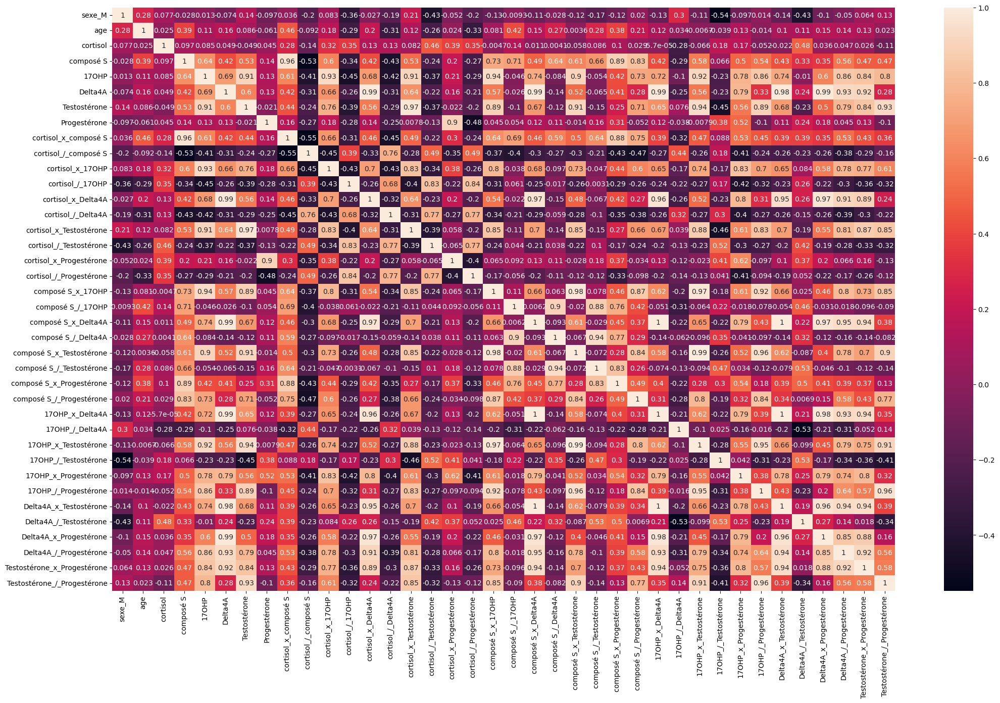

In [ ]:
test_pearson = X_train_prep.corr(method='pearson', min_periods=1)
plt.subplots(figsize=(25,15))
sns.heatmap(test_pearson, annot = True)
plt.show()

##### Cluster maps pour différentes prép...

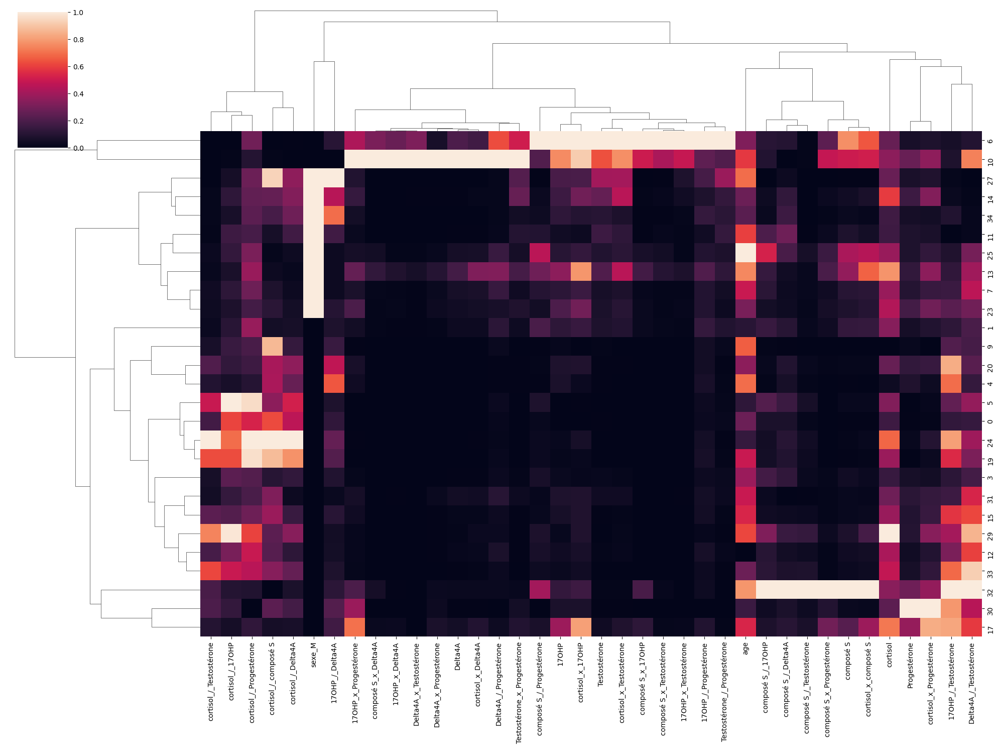

In [ ]:
sns.clustermap(X_train_prep, metric='correlation',standard_scale=1,figsize=(20,15)) #équivaut à la clustermap de X_train_prep_minmax (sc=1)

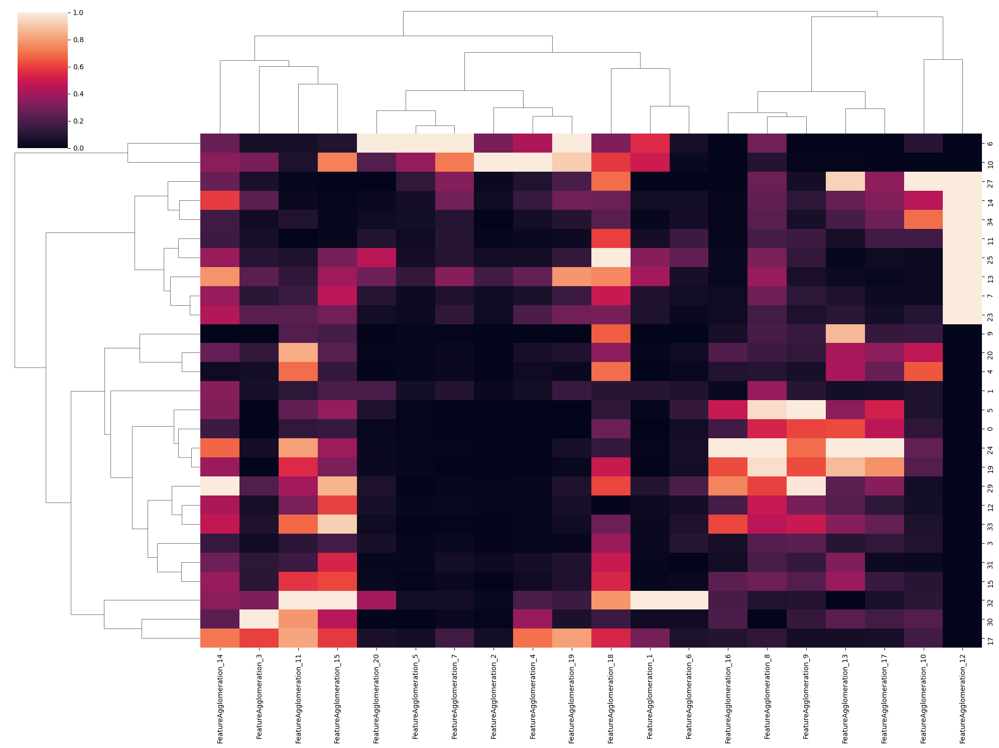

In [ ]:
sns.clustermap(X_train_prep_reduce, metric='correlation',standard_scale=1, figsize=(20,15))

##### Statistiques descriptives et graphiques de distributions : 

In [ ]:
X_train_prep_minmax.describe()

,sexe_M,age_norm,cortisol_norm,composé S_norm,17OHP_norm,Delta4A_norm,Testostérone_norm,Progestérone_norm,cortisol_x_composé S_norm,cortisol_/_composé S_norm,cortisol_x_17OHP_norm,cortisol_/_17OHP_norm,cortisol_x_Delta4A_norm,cortisol_/_Delta4A_norm,cortisol_x_Testostérone_norm,cortisol_/_Testostérone_norm,cortisol_x_Progestérone_norm,cortisol_/_Progestérone_norm,composé S_x_17OHP_norm,composé S_/_17OHP_norm,composé S_x_Delta4A_norm,composé S_/_Delta4A_norm,composé S_x_Testostérone_norm,composé S_/_Testostérone_norm,composé S_x_Progestérone_norm,composé S_/_Progestérone_norm,17OHP_x_Delta4A_norm,17OHP_/_Delta4A_norm,17OHP_x_Testostérone_norm,17OHP_/_Testostérone_norm,17OHP_x_Progestérone_norm,17OHP_/_Progestérone_norm,Delta4A_x_Testostérone_norm,Delta4A_/_Testostérone_norm,Delta4A_x_Progestérone_norm,Delta4A_/_Progestérone_norm,Testostérone_x_Progestérone_norm,Testostérone_/_Progestérone_norm
count,27.000000,27.000000,27.000000,27.000000,27.000000,27.000000,27.000000,27.000000,27.000000,27.000000,27.000000,27.000000,27.000000,27.000000,27.000000,27.000000,27.000000,27.000000,27.000000,27.000000,27.000000,27.000000,27.000000,27.000000,27.000000,27.000000,27.000000,27.000000,27.000000,27.000000,27.000000,27.000000,27.000000,27.000000,27.000000,27.000000,27.000000,27.000000
mean,0.296296,0.440456,0.369960,0.150845,0.156328,0.066092,0.120042,0.134269,0.170244,0.303741,0.209446,0.254126,0.073660,0.230236,0.143632,0.193606,0.200232,0.341429,0.079991,0.140044,0.059740,0.122273,0.062317,0.066083,0.102263,0.125820,0.053481,0.205854,0.066248,0.345395,0.145848,0.111910,0.052763,0.371403,0.053897,0.109785,0.103218,0.094051
std,0.465322,0.244527,0.226839,0.251256,0.231866,0.193227,0.228139,0.194062,0.262186,0.306417,0.295434,0.285213,0.197171,0.240460,0.254193,0.264938,0.238872,0.268455,0.211756,0.205014,0.198366,0.186595,0.204390,0.189156,0.212315,0.211608,0.196417,0.241883,0.208819,0.314628,0.235932,0.186791,0.199147,0.285482,0.190761,0.219990,0.211364,0.199853
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.276923,0.250944,0.016971,0.025181,0.002124,0.005987,0.055572,0.018941,0.058185,0.040282,0.071459,0.002901,0.055345,0.003485,0.023825,0.058828,0.181205,0.001701,0.038331,0.000144,0.042435,0.000166,0.009956,0.005271,0.021755,0.000466,0.067226,0.000575,0.100355,0.016094,0.040682,0.000075,0.160073,0.001251,0.016714,0.005052,0.008051
50%,0.000000,0.492308,0.344589,0.039656,0.078675,0.007303,0.021639,0.081426,0.038599,0.234416,0.084455,0.133776,0.012422,0.150795,0.016007,0.065420,0.125189,0.275910,0.003113,0.077585,0.000936,0.086403,0.001590,0.022501,0.014062,0.047949,0.001281,0.109258,0.001882,0.212182,0.051933,0.058660,0.000576,0.314931,0.005723,0.029452,0.034137,0.020992
75%,1.000000,0.607692,0.430810,0.119298,0.145367,0.046570,0.095483,0.129866,0.158716,0.400052,0.177412,0.272190,0.048581,0.334755,0.107257,0.205847,0.308930,0.417715,0.023872,0.145696,0.011484,0.130215,0.015705,0.041548,0.074738,0.096792,0.007646,0.217096,0.015336,0.631461,0.168809,0.091585,0.004210,0.560003,0.028282,0.087506,0.087677,0.101130
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [ ]:
def plot_one_feature_repartition(data,feature_name, rot=45, head=30):
    title = 'Répartition de' + ' ' + feature_name +' :'
    return data[feature_name].value_counts().head(head).plot(kind='bar', rot=rot, title=title)

In [ ]:
def plot_all_features_repartition(data):
    for feature_name in data.columns:
        if data[feature_name].nunique()<100 :
            #plt.figure()
            plt.subplots(figsize=(15,4))
            plot_one_feature_repartition(data,feature_name)
            plt.show()

<Axes: title={'center': 'Répartition de sexe_M :'}>

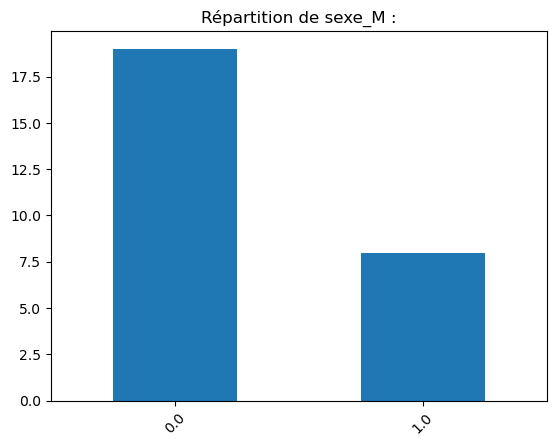

In [ ]:
plot_one_feature_repartition(X_train_prep_minmax, 'sexe_M')

In [ ]:
def plot_distrib(data,feature_name):
    sns.distplot(data[feature_name])

In [ ]:
y_train['label'].unique()

array([0, 1], dtype=int64)

In [ ]:
def plot_all_features_dist(X, y, features_to_plot):
    data=X.copy()
    data['label']=y
    for feature_name in features_to_plot:
        #if data[feature_name].nunique()<102 :
            #plt.figure()
        sns.displot(data=data,x=feature_name,kind="hist",hue='label',kde=True)
        plt.show()          

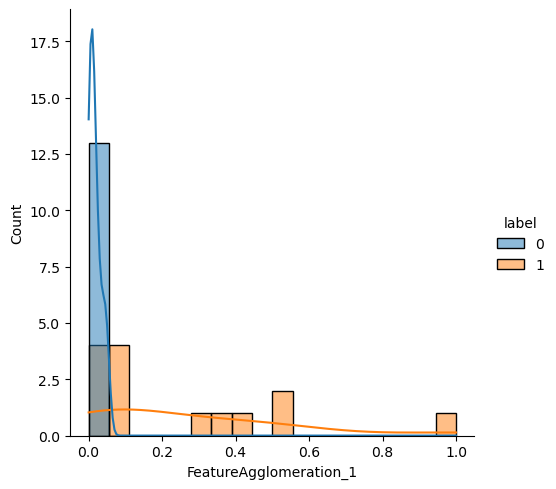

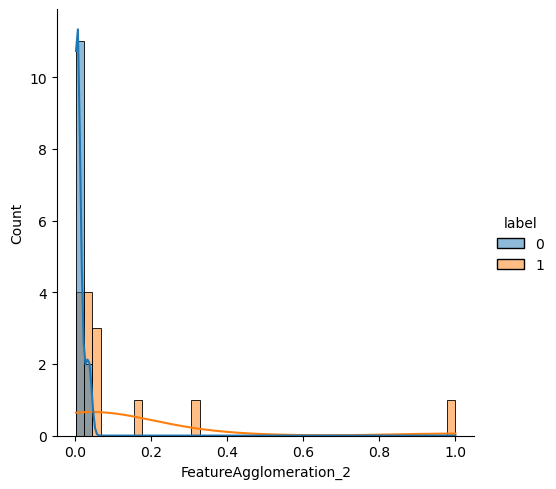

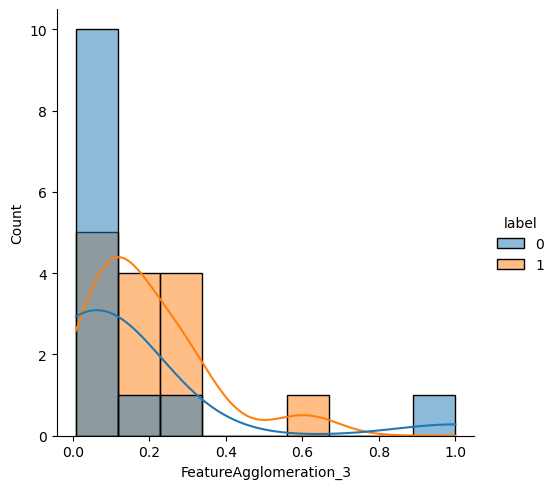

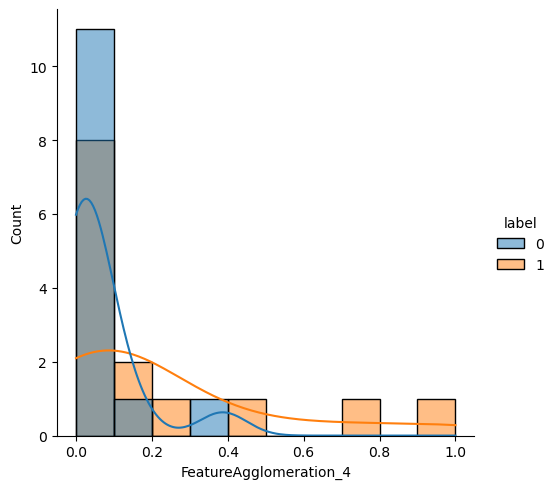

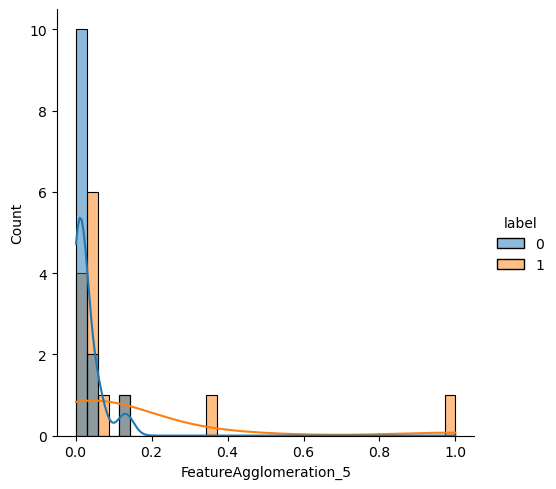

...

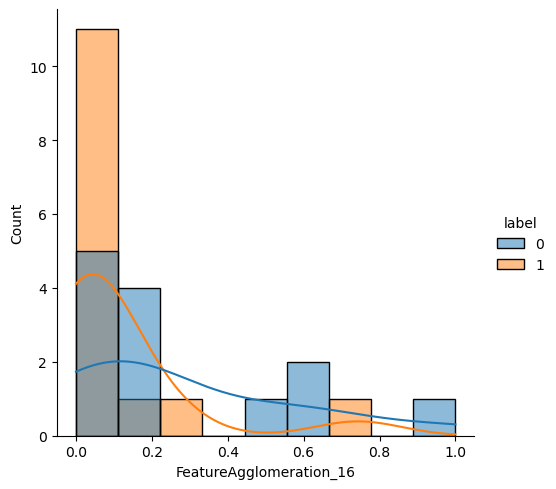

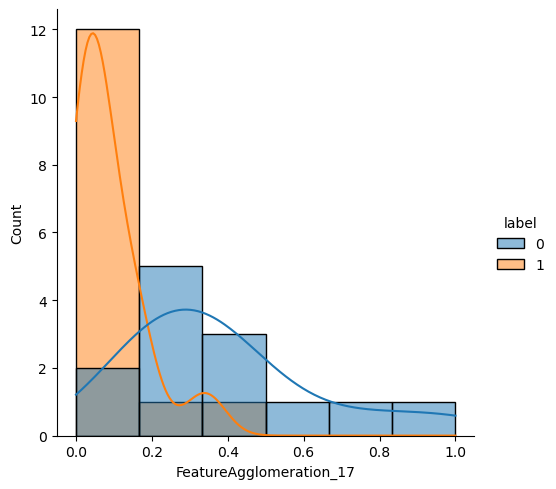

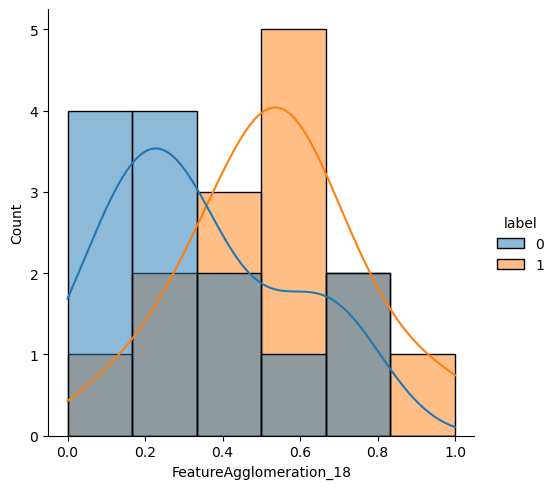

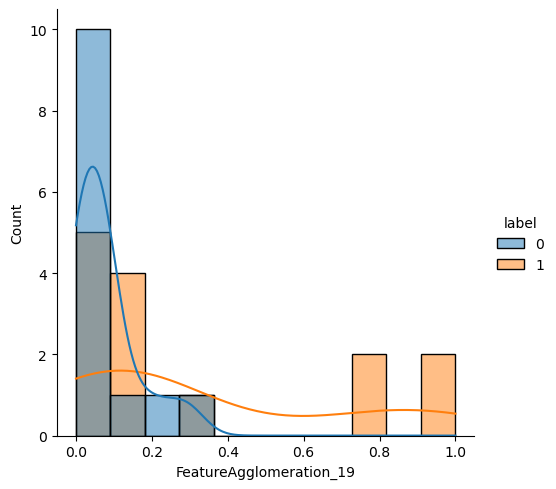

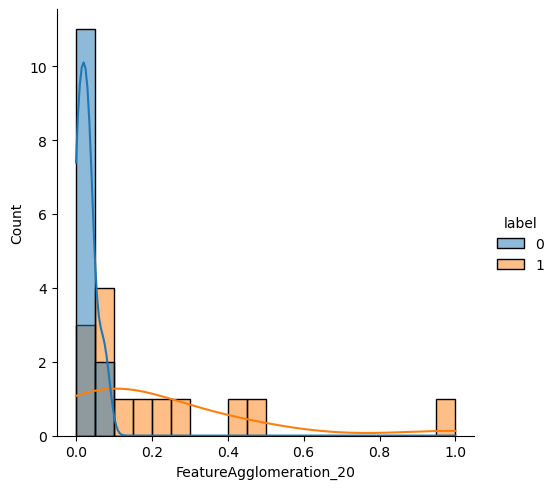

In [ ]:
plot_all_features_dist(X=X_train_prep_reduce, features_to_plot=X_train_prep_reduce.columns, y=y_train)

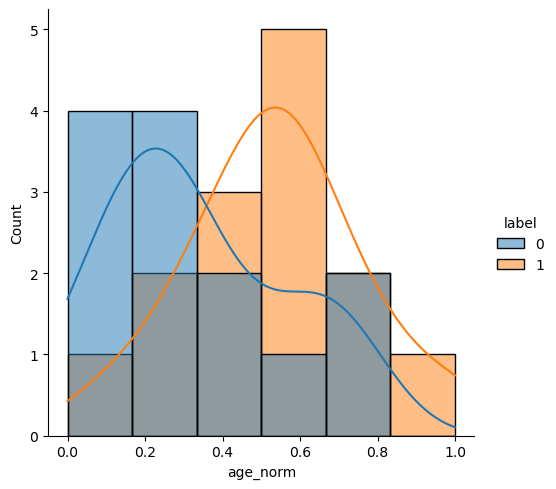

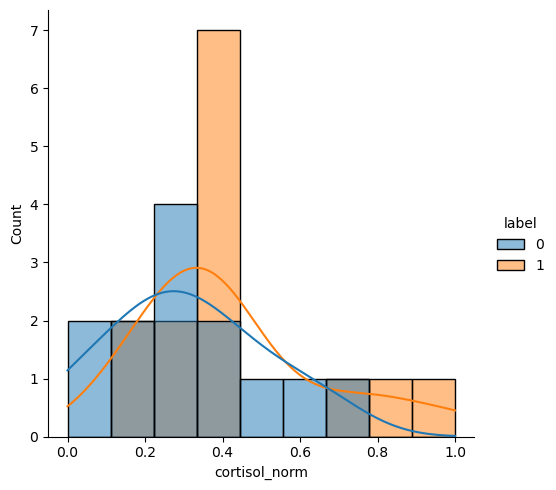

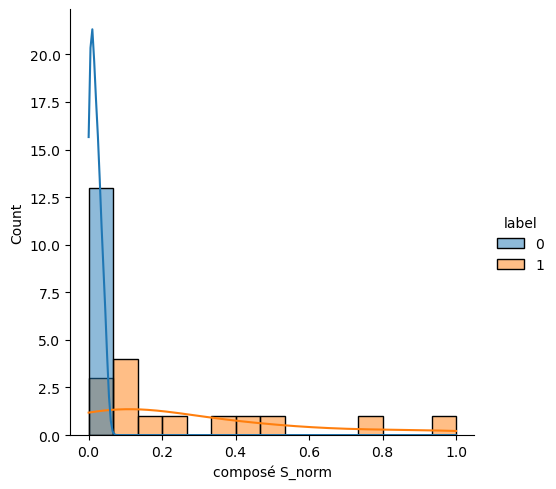

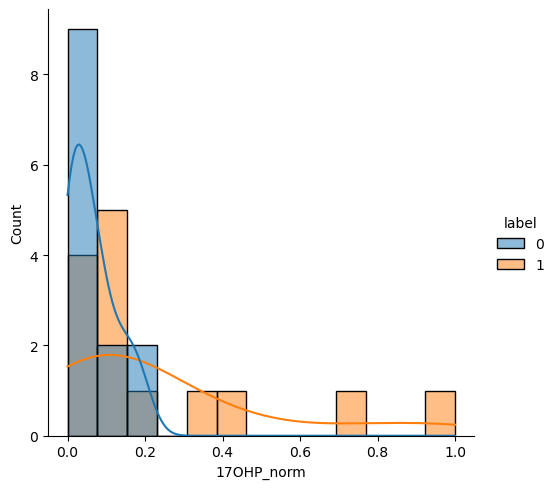

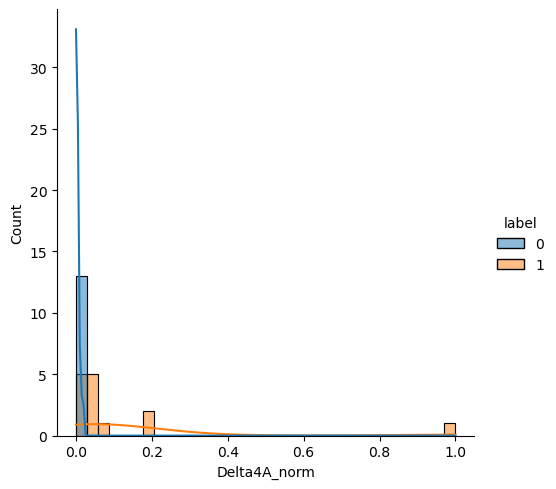

...

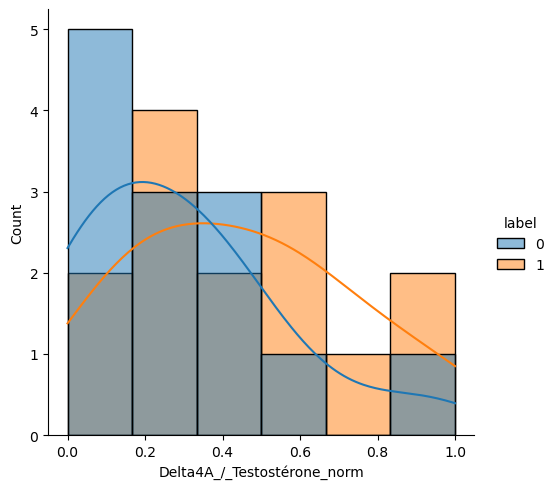

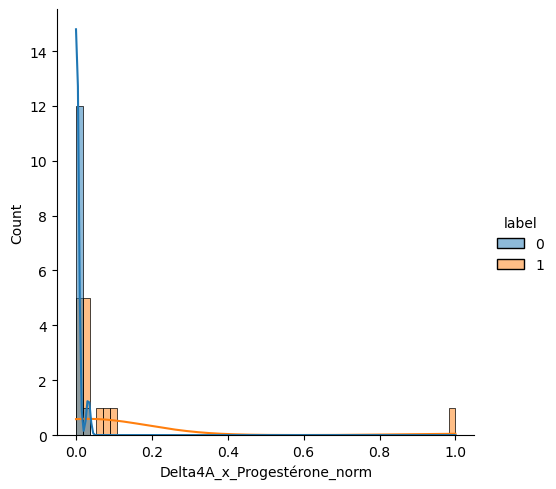

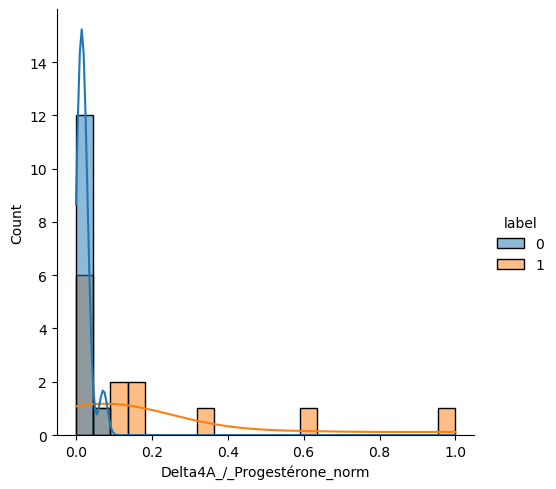

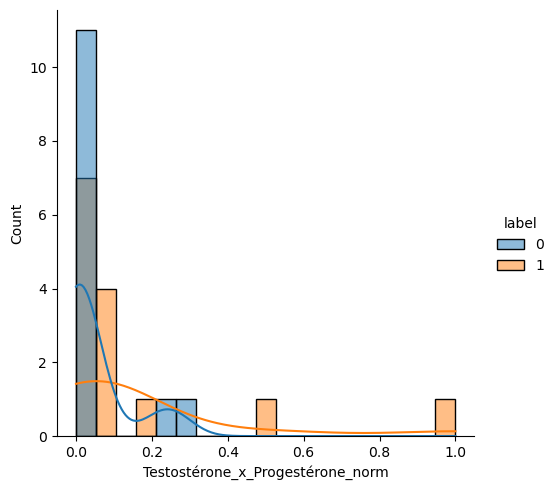

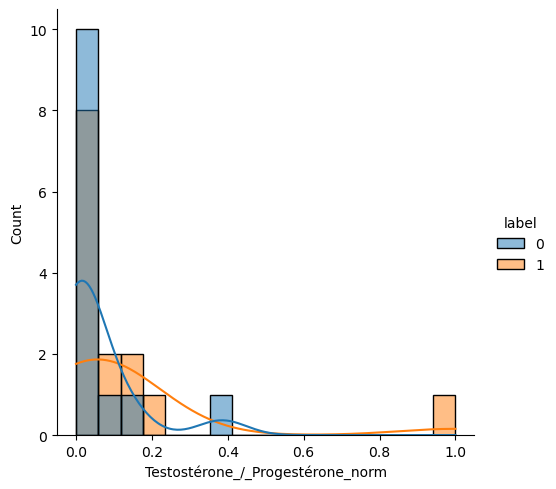

In [ ]:
plot_all_features_dist(X=X_train_prep_minmax, features_to_plot=X_train_prep_minmax.columns[1:], y=y_train)

def plot_all_features_box_and_dist(df, features_to_plot):
    for i in features_to_plot:
        plt.figure()
        plt.tight_layout()
        sns.set(rc={"figure.figsize":(8, 5)})    
        f, (ax_box, ax_hist) = plt.subplots(2, sharex=True)
        plt.gca().set(xlabel= i,ylabel='Frequency')
        sns.boxplot(data=df[i], ax=ax_box , linewidth= 1.0, orient='h')
        sns.histplot(data=df[i], ax=ax_hist , kde=True)
    plt.close()
        #sns.displot(df[i], ax=ax_hist , bins = 10,kde=True)

 plot_all_features_box_and_dist(X_train_prep, features_to_plot)

### Distribution par rapport à la cible (tumeur maligne ou pas)

#### Préparation dfs pour explo supp

In [ ]:
X_train_prep_labeled = X_train_prep.copy()
X_train_prep_labeled['label_malignant'] =y_train['label']
X_train_prep_labeled

,sexe_M,age,cortisol,composé S,17OHP,Delta4A,Testostérone,Progestérone,cortisol_x_composé S,cortisol_/_composé S,cortisol_x_17OHP,cortisol_/_17OHP,cortisol_x_Delta4A,cortisol_/_Delta4A,cortisol_x_Testostérone,cortisol_/_Testostérone,cortisol_x_Progestérone,cortisol_/_Progestérone,composé S_x_17OHP,composé S_/_17OHP,composé S_x_Delta4A,composé S_/_Delta4A,composé S_x_Testostérone,composé S_/_Testostérone,composé S_x_Progestérone,composé S_/_Progestérone,17OHP_x_Delta4A,17OHP_/_Delta4A,17OHP_x_Testostérone,17OHP_/_Testostérone,17OHP_x_Progestérone,17OHP_/_Progestérone,Delta4A_x_Testostérone,Delta4A_/_Testostérone,Delta4A_x_Progestérone,Delta4A_/_Progestérone,Testostérone_x_Progestérone,Testostérone_/_Progestérone,label_malignant
20,0.0,49.0,422.40,2.068,1.852,0.950,0.490,0.557,873.52320,204.255319,782.28480,228.077754,401.2800,444.631579,206.97600,862.040816,235.27680,758.348294,3.829936,1.116631,1.964600,2.176842,1.013320,4.220408,1.151876,3.712747,1.759400,1.949474,0.907480,3.779592,1.031564,3.324955,0.465500,1.938776,0.529150,1.705566,0.272930,0.879713,0
30,0.0,36.0,401.80,3.410,1.710,1.820,0.480,3.488,1370.13800,117.829912,687.07800,234.970760,731.2760,220.769231,192.86400,837.083333,1401.47840,115.194954,5.831100,1.994152,6.206200,1.873626,1.636800,7.104167,11.894080,0.977638,3.112200,0.939560,0.820800,3.562500,5.964480,0.490252,0.873600,3.791667,6.348160,0.521789,1.674240,0.137615,0
0,0.0,44.0,327.00,1.070,0.329,0.566,0.460,0.147,349.89000,305.607477,107.58300,993.920973,185.0820,577.738516,150.42000,710.869565,48.06900,2224.489796,0.352030,3.252280,0.605620,1.890459,0.492200,2.326087,0.157290,7.278912,0.186214,0.581272,0.151340,0.715217,0.048363,2.238095,0.260360,1.230435,0.083202,3.850340,0.067620,3.129252,0
13,1.0,75.0,917.70,43.450,7.100,33.740,10.074,0.563,39874.06500,21.120829,6515.67000,129.253521,30963.1980,27.199170,9244.90980,91.095890,516.66510,1630.017762,308.495000,6.119718,1466.003000,1.287789,437.715300,4.313083,24.462350,77.175844,239.554000,0.210433,71.525400,0.704785,3.997300,12.611012,339.896760,3.349216,18.995620,59.928952,5.671662,17.893428,1
27,1.0,71.0,429.30,0.940,3.923,0.967,19.460,0.354,403.54200,456.702128,1684.14390,109.431557,415.1331,443.950362,8354.17800,22.060637,151.97220,1212.711864,3.687620,0.239613,0.908980,0.972079,18.292400,0.048304,0.332760,2.655367,3.793541,4.056877,76.341580,0.201593,1.388742,11.081921,18.817820,0.049692,0.342318,2.731638,6.888840,54.971751,0
6,0.0,47.0,423.20,91.000,19.620,38.440,47.800,0.335,38511.20000,4.650549,8303.18400,21.569827,16267.8080,11.009365,20228.96000,8.853556,141.77200,1263.283582,1785.420000,4.638124,3498.040000,2.367326,4349.800000,1.903766,30.485000,271.641791,754.192800,0.510406,937.836000,0.410460,6.572700,58.567164,1837.432000,0.804184,12.877400,114.746269,16.013000,142.686567,1
7,1.0,58.0,536.60,12.470,2.550,12.130,3.110,0.440,6691.40200,43.031275,1368.33000,210.431373,6508.9580,44.237428,1668.82600,172.540193,236.10400,1219.545455,31.798500,4.890196,151.261100,1.028030,38.781700,4.009646,5.486800,28.340909,30.931500,0.210223,7.930500,0.819936,1.122000,5.795455,37.724300,3.900322,5.337200,27.568182,1.368400,7.068182,1
12,0.0,26.0,574.44,5.099,1.123,3.795,0.749,0.278,2929.06956,112.657384,645.09612,511.522707,2179.9998,151.367589,430.25556,766.942590,159.69432,2066.330935,5.726177,4.540516,19.350705,1.343610,3.819151,6.807744,1.417522,18.341727,4.261785,0.295916,0.841127,1.499332,0.312194,4.039568,2.842455,5.066756,1.055010,13.651079,0.208222,2.694245,0
23,1.0,46.0,592.80,10.090,4.210,8.852,3.651,0.723,5981.35200,58.751239,2495.68800,140.807601,5247.4656,66.967917,2164.31280,162.366475,428.59440,819.917012,42.478900,2.396675,89.316680,1.139855,36.838590,2.763626,7.295070,13.955740,37.266920,0.475599,15.370710,1.153109,3.043830,5.822960,32.318652,2.424541,6.399996,12.243430,2.639673,5.049793,1
11,1.0,65.0,328.90,10.040,1.170,1.540,7.760,0.386,3302.15600,32.758964,384.81300,281.111111,506.5060,213.571429,2552.26400,42.384021,126.95540,852.072539

In [ ]:
X_train_norm_labeled = X_train_prep_norm.copy()
X_train_norm_labeled['label_malignant'] =y_train
X_train_norm_labeled

,scale_and_norm__cortisol,scale_and_norm__composé S,scale_and_norm__17OHP,scale_and_norm__Delta4A,scale_and_norm__Testostérone,scale_and_norm__Progestérone,scale_and_norm_p__cortisol_x_composé S,scale_and_norm_p__cortisol_/_composé S,scale_and_norm_p__cortisol_x_17OHP,scale_and_norm_p__cortisol_/_17OHP,scale_and_norm_p__cortisol_x_Delta4A,scale_and_norm_p__cortisol_/_Delta4A,scale_and_norm_p__cortisol_x_Testostérone,scale_and_norm_p__cortisol_/_Testostérone,scale_and_norm_p__cortisol_x_Progestérone,scale_and_norm_p__cortisol_/_Progestérone,scale_and_norm_p__composé S_x_17OHP,scale_and_norm_p__composé S_/_17OHP,scale_and_norm_p__composé S_x_Delta4A,scale_and_norm_p__composé S_/_Delta4A,scale_and_norm_p__composé S_x_Testostérone,scale_and_norm_p__composé S_/_Testostérone,scale_and_norm_p__composé S_x_Progestérone,scale_and_norm_p__composé S_/_Progestérone,scale_and_norm_p__17OHP_x_Delta4A,scale_and_norm_p__17OHP_/_Delta4A,scale_and_norm_p__17OHP_x_Testostérone,scale_and_norm_p__17OHP_/_Testostérone,scale_and_norm_p__17OHP_x_Progestérone,scale_and_norm_p__17OHP_/_Progestérone,scale_and_norm_p__Delta4A_x_Testostérone,scale_and_norm_p__Delta4A_/_Testostérone,scale_and_norm_p__Delta4A_x_Progestérone,scale_and_norm_p__Delta4A_/_Progestérone,scale_and_norm_p__Testostérone_x_Progestérone,scale_and_norm_p__Testostérone_/_Progestérone,remainder__sexe_M,remainder__age,label_malignant
20,0.351129,-0.507522,-0.246439,-0.330028,-0.480811,0.065938,-0.179057,0.720451,2.408820,0.261634,-0.351584,1.756280,-0.398244,1.396886,0.690043,0.384123,-0.258295,-0.184603,-0.454524,1.364684,-0.369550,1.116167,-0.050715,-0.359857,-0.320219,1.269155,-0.379653,2.063252,0.667852,0.778261,-0.375501,0.824448,-0.192260,-0.514434,-0.314736,-0.494843,0.0,49.0,0
30,0.346533,-0.445956,-0.260693,-0.294976,-0.479321,4.827799,0.121519,-0.043900,1.091806,-0.018812,-0.018655,0.109381,-0.532868,0.783771,4.917133,-0.970193,-0.213689,0.124044,-0.391875,0.525919,-0.362481,1.705489,4.502646,-1.204280,-0.263186,0.128807,-0.419713,1.282325,4.729955,-0.753582,-0.366805,1.704323,3.846534,-1.151483,1.857862,-0.737066,0.0,36.0,0
0,0.352292,-0.535362,-0.620007,-0.337993,-0.470157,-0.496238,-1.385801,0.739458,-1.119917,2.707423,-0.965693,1.442300,-0.627389,0.389924,-0.354398,1.895200,-0.543217,0.686349,-0.490450,0.383481,-0.391435,-0.261846,-0.660349,-0.013565,-0.479493,-0.159317,-0.491138,-0.283986,-0.504374,-0.158809,-0.388557,-0.235393,-0.641262,-0.075658,-0.814043,-0.107453,0.0,44.0,0
13,0.225757,0.218887,0.122658,0.199521,-0.057769,-0.390930,0.794085,-0.626379,-0.355427,-0.965670,1.152387,-0.868938,-0.148351,-0.877579,-0.429683,-1.030854,0.289018,-0.908355,0.678627,-0.971233,0.087938,-1.005359,-0.226349,-0.651731,0.320671,-0.514382,-0.160815,-0.611854,-0.379688,-0.717664,0.137418,-0.923629,-0.067400,-0.330675,-0.481137,-0.575191,1.0,75.0,1
27,0.280407,-0.553965,0.278151,-0.330011,1.424406,-0.254198,-1.676213,-0.002201,0.261045,-0.865320,-1.052604,-0.327816,2.943769,-0.873809,-0.359287,-0.636169,-0.501254,-1.038848,-0.495565,-0.798635,-0.279596,-1.078299,-0.682130,-1.256404,-0.414801,0.254305,1.695410,-0.599425,-0.203609,0.250430,-0.219614,-1.025440,-0.627152,-1.066296,2.237560,2.801675,1.0,71.0,0
6,-1.875492,2.974131,4.226231,0.985653,4.185518,-0.291871,0.927104,-0.630076,0.079880,-0.985866,0.125128,-0.872071,0.819780,-0.885082,-0.494634,-1.048799,4.796318,-0.938280,2.559054,-0.922183,4.895788,-1.046003,-0.049922,1.502234,2.290619,-0.503371,4.408587,-0.618254,-0.251024,0.203300,2.743232,-1.006179,-0.232153,0.764598,0.417043,0.915335,0.0,47.0,1
7,0.315477,-0.193198,-0.206060,-0.017292,-0.280770,-0.256908,0.528615,-0.578183,-0.214429,-0.775128,1.454961,-0.825768,-0.171443,-0.800837,-0.295601,-0.686954,-0.092115,-0.349170,0.151541,-0.810448,-0.169535,-0.694165,-0.126298,0.084895,0.070230,-0.485133,-0.300690,-0.520484,-0.297496,-0.385343,-0.079041,-0.338266,0.249617,1.150747,-0.354255,-0.358383,1.0,58.0,1
12,0.348533,-0.439270,-0.515097,-0.263050,-0.474602,-0.473998,0.452643,-0.32411

In [ ]:
X_train_prep_minmax_labeled = X_train_prep_minmax.copy()
X_train_prep_minmax_labeled['label_malignant'] =y_train
X_train_prep_minmax_labeled

,sexe_M,age_norm,cortisol_norm,composé S_norm,17OHP_norm,Delta4A_norm,Testostérone_norm,Progestérone_norm,cortisol_x_composé S_norm,cortisol_/_composé S_norm,cortisol_x_17OHP_norm,cortisol_/_17OHP_norm,cortisol_x_Delta4A_norm,cortisol_/_Delta4A_norm,cortisol_x_Testostérone_norm,cortisol_/_Testostérone_norm,cortisol_x_Progestérone_norm,cortisol_/_Progestérone_norm,composé S_x_17OHP_norm,composé S_/_17OHP_norm,composé S_x_Delta4A_norm,composé S_/_Delta4A_norm,composé S_x_Testostérone_norm,composé S_/_Testostérone_norm,composé S_x_Progestérone_norm,composé S_/_Progestérone_norm,17OHP_x_Delta4A_norm,17OHP_/_Delta4A_norm,17OHP_x_Testostérone_norm,17OHP_/_Testostérone_norm,17OHP_x_Progestérone_norm,17OHP_/_Progestérone_norm,Delta4A_x_Testostérone_norm,Delta4A_/_Testostérone_norm,Delta4A_x_Progestérone_norm,Delta4A_/_Progestérone_norm,Testostérone_x_Progestérone_norm,Testostérone_/_Progestérone_norm,label_malignant
20,0.0,0.353846,0.261745,0.014033,0.080331,0.002079,0.006092,0.128975,0.013508,0.414111,0.082325,0.130062,0.002829,0.357082,0.004911,0.208902,0.146839,0.161685,0.001992,0.021329,0.000139,0.086403,0.000174,0.022501,0.008409,0.010105,0.000559,0.470149,0.000891,0.837368,0.064883,0.048809,0.000061,0.227335,0.002345,0.006480,0.007811,0.005206,0
30,0.0,0.153846,0.240143,0.025378,0.072981,0.006717,0.005882,1.000000,0.021863,0.235190,0.070708,0.134403,0.006275,0.176197,0.004209,0.202791,1.000000,0.000000,0.003113,0.042670,0.000514,0.072559,0.000318,0.038053,0.092804,0.000000,0.001039,0.216233,0.000798,0.787273,0.386663,0.000000,0.000132,0.450315,0.032472,0.000000,0.052603,0.000000,0
0,0.0,0.276923,0.161703,0.005596,0.001501,0.000032,0.005462,0.007132,0.004700,0.623933,0.000000,0.612403,0.000571,0.464635,0.002100,0.171888,0.009883,0.530266,0.000044,0.073267,0.000018,0.073328,0.000054,0.012284,0.000595,0.023281,0.000000,0.126151,0.000085,0.130248,0.000748,0.030095,0.000025,0.142092,0.000036,0.018220,0.001249,0.020987,0
13,1.0,0.753846,0.781145,0.363862,0.351967,0.176875,0.207437,0.130758,0.669579,0.034980,0.781893,0.067821,0.322011,0.019789,0.454094,0.020137,0.352695,0.380819,0.172659,0.143001,0.129830,0.045812,0.100576,0.023001,0.191547,0.281523,0.085030,0.032913,0.076196,0.127841,0.258341,0.208702,0.059230,0.397070,0.097950,0.325195,0.180379,0.124559,1
27,1.0,0.692308,0.268981,0.004497,0.187526,0.002170,0.404622,0.068648,0.005602,0.936734,0.192367,0.055337,0.002974,0.356532,0.409825,0.003234,0.085896,0.275910,0.001913,0.000000,0.000045,0.031397,0.004147,0.000000,0.001973,0.006199,0.001281,1.000000,0.081331,0.011727,0.088182,0.182373,0.003260,0.000000,0.001378,0.012097,0.219286,0.384669,0
6,0.0,0.323077,0.262584,0.765834,1.000000,0.201930,1.000000,0.063001,0.646653,0.000883,1.000000,0.000000,0.168535,0.006707,1.000000,0.000000,0.078433,0.288624,1.000000,0.106970,0.309838,0.095100,1.000000,0.010007,0.238864,1.000000,0.267843,0.108333,1.000000,0.059924,0.426338,1.000000,0.320281,0.090797,0.066275,0.625265,0.510935,1.000000,1
7,1.0,0.492308,0.381502,0.101968,0.116460,0.061677,0.061134,0.094205,0.111377,0.080340,0.153832,0.118948,0.066616,0.033556,0.077564,0.040079,0.147444,0.277628,0.017660,0.113100,0.013364,0.033952,0.008858,0.021364,0.042466,0.101097,0.010922,0.032860,0.008380,0.154413,0.070782,0.091348,0.006556,0.463391,0.027238,0.148052,0.042827,0.048619,1
12,0.0,0.000000,0.421183,0.039656,0.042598,0.017245,0.011534,0.046062,0.048087,0.224482,0.065586,0.308581,0.021405,0.120119,0.016007,0.185617,0.091545,0.490506,0.003055,0.104596,0.001679,0.048360,0.000819,0.036455,0.010496,0.064154,0.001448,0.054405,0.000820,0.311187,0.017958,0.061114,0.000475,0.603761,0.005068,0.071870,0.005743,0.017935,0
23,1.0,0.307692,0.440436,0.081848,0.202381,0.044203,0.072500,0.178306,0.099433,0.112884,0.291389,0.075098,0.053441,0.051923,0.102190,0.037588,0.288265,0.177164,0.023643,0.052459,0.007877,0.039058,0.008411,0.014644,0.056672,0.047949,0.013172,0.099582,0.016314,0.231294,0.196145,0.091821,0.005613,0.285793,0.032740,0.064164,0.083463,0.034460,1
11,

In [ ]:
X_train_prep_reduce_labeled = X_train_prep_reduce.copy()
X_train_prep_reduce_labeled['label_malignant'] =y_train['label']
X_train_prep_reduce_labeled

,FeatureAgglomeration_1,FeatureAgglomeration_2,FeatureAgglomeration_3,FeatureAgglomeration_4,FeatureAgglomeration_5,FeatureAgglomeration_6,FeatureAgglomeration_7,FeatureAgglomeration_8,FeatureAgglomeration_9,FeatureAgglomeration_10,FeatureAgglomeration_11,FeatureAgglomeration_12,FeatureAgglomeration_13,FeatureAgglomeration_14,FeatureAgglomeration_15,FeatureAgglomeration_16,FeatureAgglomeration_17,FeatureAgglomeration_18,FeatureAgglomeration_19,FeatureAgglomeration_20,label_malignant
20,0.011983,0.002788,0.137907,0.064883,0.011415,0.043411,0.030445,0.161685,0.130062,0.470149,0.837368,0.0,0.414111,0.261745,0.227335,0.208902,0.357082,0.353846,0.082325,0.010105,0
30,0.046682,0.012469,1.000000,0.386663,0.000846,0.051094,0.027691,0.000000,0.134403,0.216233,0.787273,0.0,0.235190,0.240143,0.450315,0.202791,0.176197,0.153846,0.070708,0.000000,0
0,0.003630,0.002519,0.008508,0.000748,0.010253,0.052960,0.003021,0.530266,0.612403,0.126151,0.130248,0.0,0.623933,0.161703,0.142092,0.171888,0.464635,0.276923,0.000000,0.023281,0
13,0.408329,0.172063,0.241726,0.258341,0.136538,0.070605,0.337833,0.380819,0.067821,0.032913,0.127841,1.0,0.034980,0.781145,0.397070,0.020137,0.019789,0.753846,0.781893,0.281523,1
27,0.004024,0.030311,0.077272,0.088182,0.130887,0.010466,0.333991,0.275910,0.055337,1.000000,0.011727,1.0,0.936734,0.268981,0.000000,0.003234,0.356532,0.692308,0.192367,0.006199,0
6,0.550450,0.308863,0.070717,0.426338,1.000000,0.070692,1.000000,0.288624,0.000000,0.108333,0.059924,0.0,0.000883,0.262584,0.090797,0.000000,0.006707,0.323077,1.000000,1.000000,1
7,0.085270,0.047156,0.120825,0.070782,0.034973,0.056139,0.085053,0.277628,0.118948,0.032860,0.154413,1.0,0.080340,0.381502,0.463391,0.040079,0.033556,0.492308,0.153832,0.101097,1
12,0.032746,0.015617,0.068804,0.017958,0.016749,0.063137,0.023380,0.490506,0.308581,0.054405,0.311187,0.0,0.224482,0.421183,0.603761,0.185617,0.120119,0.000000,0.065586,0.064154,0
23,0.079318,0.038084,0.233285,0.196145,0.034930,0.035387,0.125690,0.177164,0.075098,0.099582,0.231294,1.0,0.112884,0.440436,0.285793,0.037588,0.051923,0.307692,0.291389,0.047949,1
11,0.055198,0.016203,0.072876,0.027053,0.043540,0.164752,0.108442,0.185247,0.163463,0.171022,0.000000,1.0,0.059074,0.163695,0.017902,0.008210,0.170381,0.600000,0.033827,0.092486,1


#### Visualisation des clustermaps par rapport à la cible
NB : Features selection pour la pipeline avec reduction dans cette section

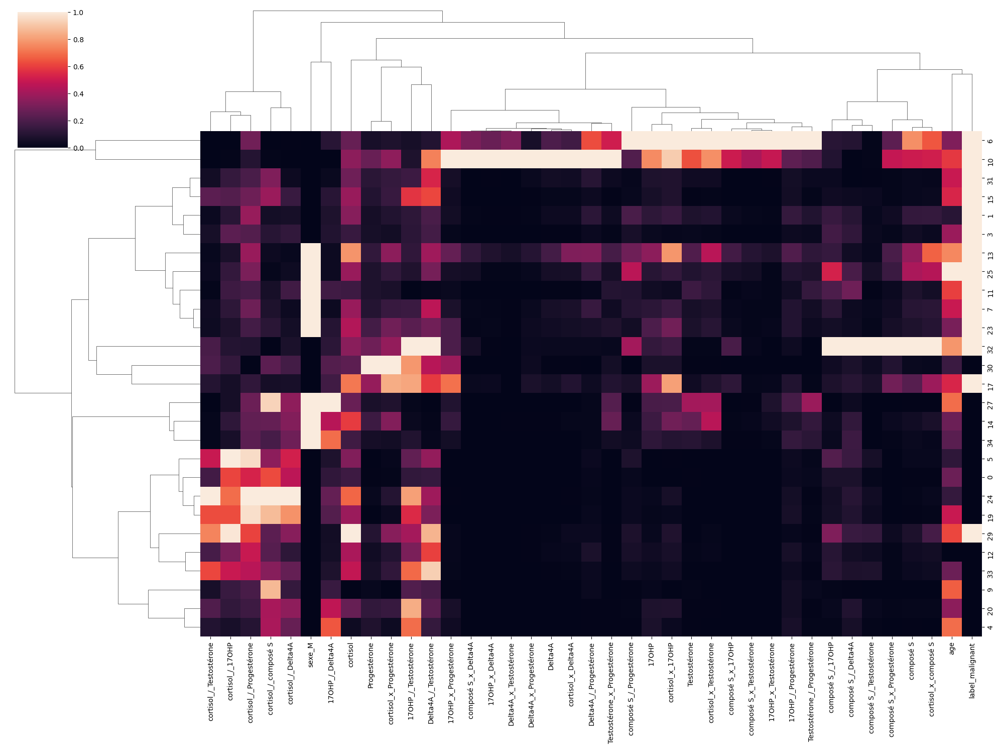

In [ ]:
sns.clustermap(X_train_prep_labeled, metric='correlation',standard_scale=1,figsize=(20,15))

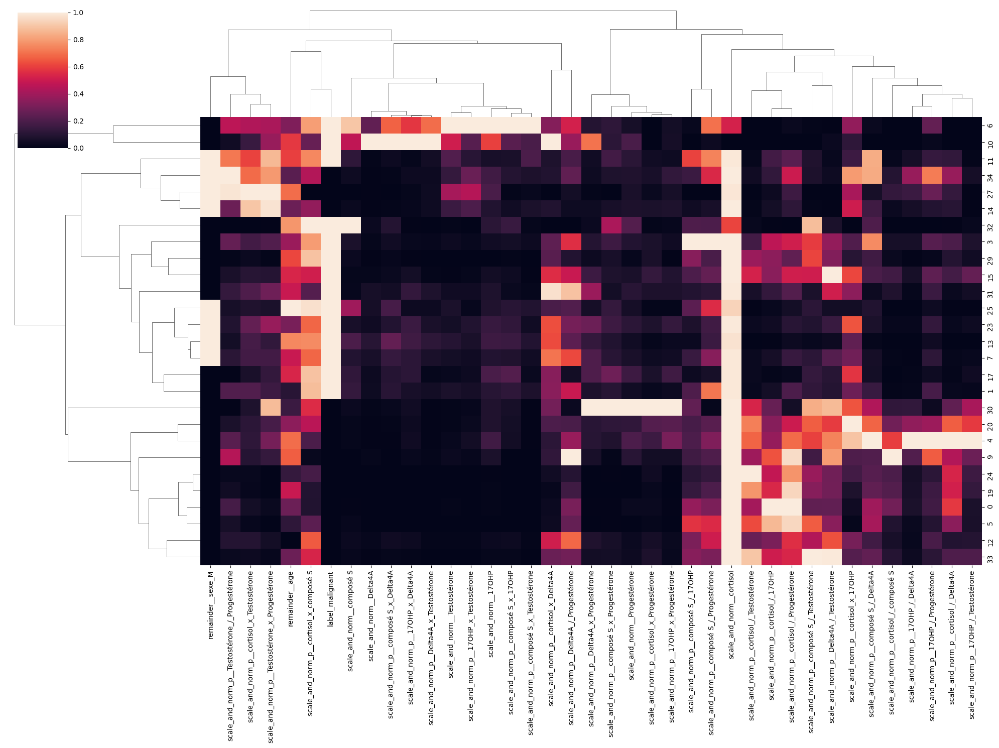

In [ ]:
sns.clustermap(X_train_norm_labeled, metric='correlation',standard_scale=1,figsize=(20,15))

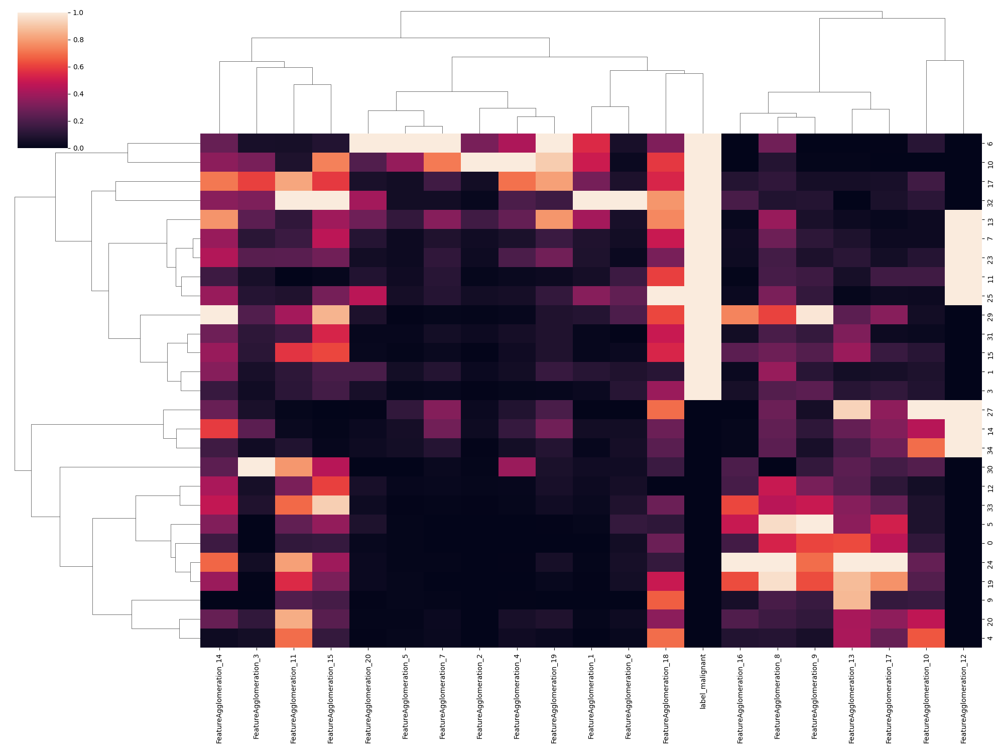

In [ ]:
sns.clustermap(X_train_prep_reduce_labeled, metric='correlation',standard_scale=1,figsize=(20,15))

Selection de features "prometteuses"
- 'FeatureAgglomeration_18' --> la plus proche de la cible dans la hierarchie
- 'FeatureAgglomeration_1' --> seconde plus proche et plus intéressante visuellement que la 6
- 'FeatureAgglomeration_10', 'FeatureAgglomeration_13','FeatureAgglomeration_17' --> plus éloignées et visuellement intéressantes

In [ ]:
select_red = ['FeatureAgglomeration_1','FeatureAgglomeration_10','FeatureAgglomeration_13','FeatureAgglomeration_17','FeatureAgglomeration_18']

#### Pairplot par rapport à la cible

In [ ]:
sns.pairplot(X_train_prep_labeled, hue="label_malignant")

In [ ]:
g2 = sns.PairGrid(X_train_norm_labeled, hue="label_malignant")
g2.map_diag(sns.histplot)
g2.map_offdiag(sns.scatterplot)
g2.add_legend()

In [ ]:
sns.pairplot(X_train_prep_minmax_labeled, hue="label_malignant")

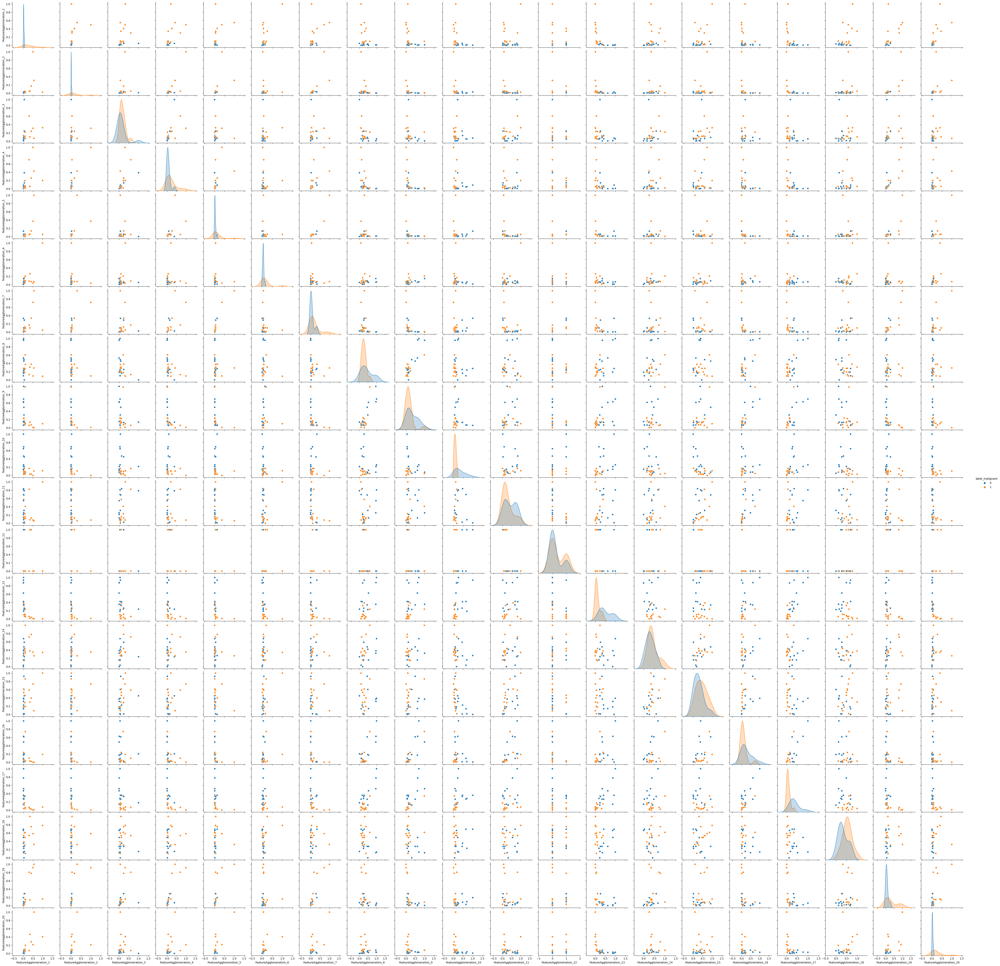

In [ ]:
sns.pairplot(X_train_prep_reduce_labeled, hue="label_malignant")

NB : Test normalize() pour normaliser niveau ligne --> avoir des valeurs relatives aux individus de 0 à 1 --> si hypothèse que ce qui est stable d'un individu à l'autre est son équilibre entre les différentes molécules et que les concentration absolues peuvent varier ... à creuser

### Preprocessing des données test

In [ ]:
feature_names = ['cortisol', 'composé S', '17OHP', 'Delta4A','Testostérone', 'Progestérone', 'cortisolxcomposé S',
        'cortisol/composé S', 'cortisolx17OHP', 'cortisol/17OHP','cortisolxDelta4A', 'cortisol/Delta4A', 
        'cortisolxTestostérone', 'cortisol/Testostérone', 'cortisolxProgestérone','cortisol/Progestérone', 
        'composé Sx17OHP', 'composé S/17OHP','composé SxDelta4A', 'composé S/Delta4A', 'composé SxTestostérone',
        'composé S/Testostérone', 'composé SxProgestérone','composé S/Progestérone', '17OHPxDelta4A', '17OHP/Delta4A',
        '17OHPxTestostérone', '17OHP/Testostérone', '17OHPxProgestérone','17OHP/Progestérone', 'Delta4AxTestostérone', 
        'Delta4A/Testostérone','Delta4AxProgestérone', 'Delta4A/Progestérone','TestostéronexProgestérone', 'Testostérone/Progestérone']

In [ ]:
X_test_prep_norm, preprocfn, col_namesfn = preprocessing_df(X_test, fit_preprocessor=preprocessor_fit_norm, fit_feature_names=fit_norm_names,relative_norm=True)
X_test_prep, preprocf, col_namesf = preprocessing_df(X_test, fit_preprocessor=preprocessor_fit, fit_feature_names=fit_names, relative_norm=False)
X_test_prep_minmax, preprocmx, col_namesmx = preprocessing_df(X_test, fit_preprocessor=preprocessor_fit_minmax, fit_feature_names=fit_minmax_names, normalize=True,relative_norm=False, normalize_strategy='minmax')
X_test_prep_reduce, preprocred, col_namesred = preprocessing_df(X_test, fit_preprocessor=preprocessor_fit_reduce, fit_feature_names=fit_reduce_names)

In [ ]:
X_test

,id,sexe,age,cortisol,composé S,17OHP,Delta4A,Testostérone,Progestérone
21,21-033,F,24,495.30,3.920,2.33,1.940,0.63,3.83
2,19-035,F,42,493.10,14.290,0.82,2.780,0.535,0.495
35,22-026,F,75,289.20,9.450,0.9,1.650,0.44,0.333
16,21-003,F,63,247.45,0.990,0.144,0.278,<0.2,<0.2
36,22-xxx,F,54,323.70,8.130,2.09,4.190,1.51,0.23
8,20-002,F,68,656.40,6.750,1.132,1.346,0.31,1.108
18,21-018,F,67,381.75,1.670,<0.53,0.700,0.45,0.161
28,21-043,F,38,409.20,1.030,<0.53,0.730,0.22,1.28
26,21-041,F,59,271.10,0.740,<0.53,0.470,<0.2,<0.2
22,21-031,F,26,545.80,5.493,3.30,9.120,1.25,1.001


In [ ]:
X_test_prep

,sexe_M,age,cortisol,composé S,17OHP,Delta4A,Testostérone,Progestérone,cortisol_x_composé S,cortisol_/_composé S,...,17OHP_x_Testostérone,17OHP_/_Testostérone,17OHP_x_Progestérone,17OHP_/_Progestérone,Delta4A_x_Testostérone,Delta4A_/_Testostérone,Delta4A_x_Progestérone,Delta4A_/_Progestérone,Testostérone_x_Progestérone,Testostérone_/_Progestérone
21,0.0,24.0,495.30,3.920,2.330,1.940,0.630,3.830,1941.5760,126.352041,...,1.46790,3.698413,8.923900,0.608355,1.22220,3.079365,7.430200,0.506527,2.412900,0.164491
2,0.0,42.0,493.10,14.290,0.820,2.780,0.535,0.495,7046.3990,34.506648,...,0.43870,1.532710,0.405900,1.656566,1.48730,5.196262,1.376100,5.616162,0.264825,1.080808
35,0.0,75.0,289.20,9.450,0.900,1.650,0.440,0.333,2732.9400,30.603175,...,0.39600,2.045455,0.299700,2.702703,0.72600,3.750000,0.549450,4.954955,0.146520,1.321321
16,0.0,63.0,247.45,0.990,0.144,0.278,0.200,0.200,244.9755,249.949495,...,0.02880,0.720000,0.028800,0.720000,0.05560,1.390000,0.055600,1.390000,0.040000,1.000000
36,0.0,54.0,323.70,8.130,2.090,4.190,1.510,0.230,2631.6810,39.815498,...,3.15590,1.384106,0.480700,9.086957,6.32690,2.774834,0.963700,18.217391,0.347300,6.565217
8,0.0,68.0,656.40,6.750,1.132,1.346,0.310,1.108,4430.7000,97.244444,...,0.35092,3.651613,1.254256,1.021661,0.41726,4.341935,1.491368,1.214801,0.343480,0.279783
18,0.0,67.0,381.75,1.670,0.530,0.700,0.450,0.161,637.5225,228.592814,...,0.23850,1.177778,0.085330,3.291925,0.31500,1.555556,0.112700,4.347826,0.072450,2.795031
28,0.0,38.0,409.20,1.030,0.530,0.730,0.220,1.280,421.4760,397.281553,...,0.11660,2.409091,0.678400,0.414062,0.16060,3.318182,0.934400,0.570312,0.281600,0.171875
26,0.0,59.0,271.10,0.740,0.530,0.470,0.200,0.200,200.6140,366.351351,...,0.10600,2.650000,0.106000,2.650000,0.09400,2.350000,0.094000,2.350000,0.040000,1.000000
22,0.0,26.0,545.80,5.493,3.300,9.120,1.250,1.001,2998.0794,99.362825,...,4.12500,2.640000,3.303300,3.296703,11.40000,7.296000,9.129120,9.110889,1.251250,1.248751


In [ ]:
X_test_prep_norm

,scale_and_norm__cortisol,scale_and_norm__composé S,scale_and_norm__17OHP,scale_and_norm__Delta4A,scale_and_norm__Testostérone,scale_and_norm__Progestérone,scale_and_norm_p__cortisol_x_composé S,scale_and_norm_p__cortisol_/_composé S,scale_and_norm_p__cortisol_x_17OHP,scale_and_norm_p__cortisol_/_17OHP,...,scale_and_norm_p__17OHP_x_Progestérone,scale_and_norm_p__17OHP_/_Progestérone,scale_and_norm_p__Delta4A_x_Testostérone,scale_and_norm_p__Delta4A_/_Testostérone,scale_and_norm_p__Delta4A_x_Progestérone,scale_and_norm_p__Delta4A_/_Progestérone,scale_and_norm_p__Testostérone_x_Progestérone,scale_and_norm_p__Testostérone_/_Progestérone,remainder__sexe_M,remainder__age
21,0.347408,-0.455769,-0.211110,-0.304394,-0.475981,4.214537,0.212643,-0.166092,1.710934,-0.341215,...,5.283532,-0.769570,-0.365817,0.607901,3.230845,-1.205479,2.036367,-0.740859,0.0,24.0
2,0.323277,-0.094750,-0.547453,-0.277971,-0.484071,-0.137957,1.437559,-0.575304,-0.989931,-0.181766,...,-0.426151,-0.734659,-0.380071,0.185648,-0.374675,-0.674532,-0.772180,-0.686786,0.0,42.0
35,0.315283,-0.031459,-0.387324,-0.276943,-0.465240,-0.042611,1.256516,-0.510408,-0.710129,0.062058,...,-0.332980,-0.109234,-0.376962,1.110908,-0.383470,0.092629,-0.722603,-0.523359,0.0,75.0
16,0.352224,-0.522868,-0.666912,-0.347331,-0.496001,-0.264210,-1.517887,0.499615,-1.361447,5.458612,...,-0.519735,-0.689849,-0.394811,-0.123758,-0.658717,-0.881003,-0.854680,-0.556030,0.0,63.0
36,0.323758,-0.160978,-0.017597,-0.165703,-0.329554,-0.327607,0.811614,-0.491476,0.302520,-0.539372,...,-0.243581,1.553160,-0.244933,0.376582,-0.209319,3.347908,-0.509769,0.317532,0.0,54.0
8,0.348945,-0.415146,-0.540571,-0.333080,-0.510509,0.304808,1.079295,-0.407983,-0.200308,0.113917,...,-0.032150,-0.761270,-0.389989,0.409613,-0.203426,-1.137691,-0.652814,-0.739124,0.0,68.0
18,0.351984,-0.516459,-0.577741,-0.336413,-0.480001,-0.514221,-1.053982,0.346677,-0.831997,1.565607,...,-0.478104,0.157949,-0.387330,-0.070729,-0.625625,0.021929,-0.811832,-0.205465,0.0,67.0
28,0.352144,-0.548310,-0.588039,-0.337177,-0.507686,1.236367,-1.205815,1.440055,-0.632673,2.348632,...,0.084440,-0.775897,-0.390813,1.472368,0.004347,-1.124163,-0.427027,-0.727155,0.0,38.0
26,0.352343,-0.544665,-0.515080,-0.337950,-0.499045,-0.309818,-1.511999,1.430303,-0.874857,1.397236,...,-0.437056,0.222900,-0.392918,0.881537,-0.618904,-0.372359,-0.840023,-0.504012,0.0,59.0
22,0.338491,-0.418932,-0.062817,-0.107789,-0.432027,0.399067,-0.181084,-0.439890,1.124685,-0.726144,...,0.585357,-0.447760,-0.246678,1.001330,1.828292,-0.055411,-0.114245,-0.655997,0.0,26.0


In [ ]:
X_test_prep_minmax

,sexe_M,age_norm,cortisol_norm,composé S_norm,17OHP_norm,Delta4A_norm,Testostérone_norm,Progestérone_norm,cortisol_x_composé S_norm,cortisol_/_composé S_norm,...,17OHP_x_Testostérone_norm,17OHP_/_Testostérone_norm,17OHP_x_Progestérone_norm,17OHP_/_Progestérone_norm,Delta4A_x_Testostérone_norm,Delta4A_/_Testostérone_norm,Delta4A_x_Progestérone_norm,Delta4A_/_Progestérone_norm,Testostérone_x_Progestérone_norm,Testostérone_/_Progestérone_norm
21,0.0,-0.030769,0.338192,0.029689,0.105072,0.007356,0.009034,1.101634,0.031475,0.252833,...,0.001489,0.818635,0.579709,0.002034,0.000193,0.364596,0.038073,-0.000084,0.076214,0.000189
2,0.0,0.246154,0.335885,0.117354,0.026915,0.011834,0.007038,0.110550,0.117349,0.062692,...,0.000391,0.318889,0.024070,0.020082,0.000239,0.619346,0.006730,0.027887,0.007552,0.006617
35,0.0,0.753846,0.122064,0.076438,0.031056,0.005811,0.005042,0.062407,0.044788,0.054611,...,0.000346,0.437207,0.017143,0.038095,0.000106,0.445301,0.002450,0.024267,0.003771,0.008304
16,0.0,0.569231,0.078282,0.004920,-0.008075,-0.001503,0.000000,0.022883,0.002935,0.508708,...,-0.000046,0.131352,-0.000528,0.003956,-0.000011,0.161295,-0.000106,0.004753,0.000366,0.006050
36,0.0,0.430769,0.158242,0.065279,0.092650,0.019351,0.027521,0.031798,0.043084,0.073682,...,0.003289,0.284598,0.028950,0.148023,0.001082,0.327948,0.004595,0.096866,0.010188,0.045090
8,0.0,0.646154,0.507131,0.053613,0.043064,0.004190,0.002311,0.292719,0.073348,0.192574,...,0.000297,0.807836,0.079410,0.009150,0.000052,0.516535,0.007327,0.003794,0.010066,0.000997
18,0.0,0.630769,0.219117,0.010669,0.011905,0.000746,0.005252,0.011293,0.009538,0.464495,...,0.000178,0.236986,0.003159,0.048241,0.000034,0.181218,0.000189,0.020944,0.001403,0.018642
28,0.0,0.184615,0.247903,0.005258,0.011905,0.000906,0.000420,0.343834,0.005904,0.813720,...,0.000048,0.521118,0.041846,-0.001312,0.000007,0.393335,0.004443,0.000266,0.008088,0.000240
26,0.0,0.507692,0.103083,0.002807,0.011905,-0.000480,0.000000,0.022883,0.002189,0.749687,...,0.000036,0.576709,0.004507,0.037188,-0.000004,0.276823,0.000092,0.010008,0.000366,0.006050
22,0.0,0.000000,0.391149,0.042987,0.155280,0.045631,0.022059,0.260921,0.049248,0.196959,...,0.004322,0.574401,0.213071,0.048323,0.001967,0.872032,0.046869,0.047017,0.039083,0.007795


In [ ]:
X_test_prep_reduce

,FeatureAgglomeration_1,FeatureAgglomeration_2,FeatureAgglomeration_3,FeatureAgglomeration_4,FeatureAgglomeration_5,FeatureAgglomeration_6,FeatureAgglomeration_7,FeatureAgglomeration_8,FeatureAgglomeration_9,FeatureAgglomeration_10,FeatureAgglomeration_11,FeatureAgglomeration_12,FeatureAgglomeration_13,FeatureAgglomeration_14,FeatureAgglomeration_15,FeatureAgglomeration_16,FeatureAgglomeration_17,FeatureAgglomeration_18,FeatureAgglomeration_19,FeatureAgglomeration_20
21,0.059493,0.016576,1.232072,0.579709,0.001837,0.049218,0.041413,0.003551,0.120298,0.281973,0.818635,0.0,0.252833,0.338192,0.364596,0.190330,0.204106,-0.030769,0.127686,0.000169
2,0.096545,0.008928,0.131916,0.024070,0.007040,0.261160,0.013896,0.221471,0.365150,0.054166,0.318889,0.0,0.062692,0.335885,0.619346,0.223505,0.141133,0.246154,0.036210,0.103047
35,0.048436,0.005229,0.053789,0.017143,0.010451,0.204534,0.012349,0.189369,0.188796,0.117145,0.437207,0.0,0.054611,0.122064,0.445301,0.158765,0.139435,0.753846,0.018632,0.101235
16,0.002923,0.000349,0.016902,-0.000528,0.001975,0.112470,-0.003664,0.282079,1.068694,0.110239,0.131352,0.0,0.508708,0.078282,0.161295,0.300772,0.717036,0.569231,-0.008779,0.014676
36,0.040804,0.018864,0.030491,0.028950,0.041706,0.064385,0.046363,0.324852,0.083961,0.105417,0.284598,0.0,0.073682,0.158242,0.327948,0.050321,0.060235,0.430769,0.069421,0.126985
8,0.061693,0.004317,0.399751,0.079410,0.002999,0.157445,0.016704,0.119972,0.351620,0.191455,0.807836,0.0,0.192574,0.507131,0.516535,0.516281,0.391856,0.646154,0.077537,0.018896
18,0.007226,0.003110,0.015487,0.003159,0.013503,0.062165,0.006773,0.567128,0.440061,0.170369,0.236986,0.0,0.464495,0.219117,0.181218,0.205546,0.438470,0.630769,0.011560,0.034711
28,0.006960,0.001946,0.350865,0.041846,-0.000176,0.039287,0.003808,0.051408,0.472681,0.162546,0.521118,0.0,0.813720,0.247903,0.393335,0.453252,0.450745,0.184615,0.013336,-0.000639
26,0.001839,0.001246,0.018633,0.004507,0.008663,0.035574,0.003074,0.311806,0.308572,0.263525,0.576709,0.0,0.749687,0.103083,0.276823,0.329725,0.463884,0.507692,0.004405,0.010058
22,0.044931,0.030777,0.317665,0.213071,0.014392,0.024202,0.068623,0.108115,0.090583,0.070981,0.574401,0.0,0.196959,0.391149,0.872032,0.104743,0.046169,0.000000,0.206642,0.016662


# Benchmarker nos classifiers

Mesurer les performances de notre modèle

## Vue synthétique des notions utiles

Liste des mesures envisageables pour des algos de classification : 
- $accuracy = \frac{TP+TN}{TP+TN+FP+FN}$ # taux d'éléments bien classés (vue macro sur la qualité de la classification --> limite sur des jeux de donénes déséquilibrés)
- $recall = \frac{TP}{TP+FN}$ # taux de vrais positifs, proportion de positifs correctement identifiés (manque t'on des individus?)
- $precision = \frac{TP}{TP+FP}$ # proportion de prédictions correctes parmis les points prédits positifs (identifie-t-on à tort des individus?)
- $F1-score = 2 \times \frac{precision \times recall}{precision + recall} = \frac{2 \times TP}{2 \times TP + FP + FN}$ # moyenne harmonique precision et recall (quel est le meilleur compromis dans le cas où le recall et la précision ont une importance équivalente?)
- $specificity = \frac{TN}{FP+TN}$ # taux de vrais négatifs
- courbe ROC et mesure AUROC # AUROC = aire sous la courbe ROC (s'appuie sur sensibilité et spécificité)
- matrice de confusion (Ici il s'agit plutôt de visualiser pour se faire un ordre d'idée sur les prédiction du modèle)

Eléments importants à considérer : 
- Performance de l'estimateur en fonction du volume de données (Quel volume de données est nécessaire avant d'atteindre des performances acceptabes?)
- Temps d'apprentissage en fonction du volume de données (l'estimateur est-il scalable?)
- Performance en fonction du temps d'apprentissage (Quel délai d'apprentissage est nécessaire avant d'atteindre des performances acceptabes??)
- Compromis temps de prédiction / performance (Problèmatique des contraintes temps réel?)

Plus de métriques : https://scikit-learn.org/stable/modules/model_evaluation.html 

## Fonctions pour évaluer nos {Pipeline x Modèle}

In [ ]:
from sklearn import metrics
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.metrics import RocCurveDisplay

def eval_algo(X_test,y_test, model):
    titles_options = [("Confusion matrix, without normalization", None),("Normalized confusion matrix", "true")]
    y_true, y_pred = y_test['label'], model.predict(X_test)
    
    for title, normalize in titles_options:
        cm = confusion_matrix(y_true, y_pred, labels=model.classes_,normalize=normalize)
        disp =  ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=['benign','malignant'])
        disp.plot(cmap=plt.cm.Blues)
        disp.ax_.set_title(title)
    
    plt.show()

    print("Detailed classification report:")
    print()
    print("The model is trained on the full development set.")
    print("The scores are computed on the full evaluation set.")
    print()

    print(classification_report(y_true, y_pred))
    print()

In [ ]:
from sklearn.metrics import RocCurveDisplay

def roc_curve_train_test(X_test,y_test, X_train, y_train, model):
    ax = plt.gca()
    model_disp_train = RocCurveDisplay.from_estimator(model, X_train, y_train, ax=ax, alpha=0.8,name=type(model).__name__+" on train dataset")
    model_disp_test = RocCurveDisplay.from_estimator(model, X_test, y_test, ax=ax, alpha=0.8,name=type(model).__name__+" on test dataset")
    plt.figure(figsize=(20,5))
    plt.show()

In [ ]:
from sklearn import metrics
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay


def eval_algo_train_and_test(X_test,y_test, X_train, y_train, model):

    y_test_true, y_test_pred = y_test['label'], model.predict(X_test)
    y_train_true, y_train_pred = y_train['label'], model.predict(X_train)
    titles_options = [("Confusion matrix (X_train, y_train)", y_train_true, y_train_pred),("Confusion matrix (X_test, y_test)", y_test_true, y_test_pred)]   
    
    f, axes = plt.subplots(1, 2, figsize=(10, 5), sharey='row')
    
    for i, (title, y_true, y_pred) in enumerate(titles_options):
        cm = confusion_matrix(y_true, y_pred, labels=model.classes_,normalize="true")
        disp =  ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=['benign','malignant'])
        disp.plot(ax=axes[i], cmap=plt.cm.Blues)# , xticks_rotation=45
        disp.ax_.set_title(title)
        disp.im_.colorbar.remove()     

    plt.subplots_adjust(wspace=0.30, hspace=0.1)
    f.colorbar(disp.im_, ax=axes)
    plt.show()
    
    roc_curve_train_test(X_test, y_test, X_train, y_train, model)
    
    print("Detailed classification report:")
    print()
    print("The model is trained on the full development set.")
    print("The scores are computed on the full evaluation set.")
    print()

    print(classification_report(y_true, y_pred))
    print()

In [ ]:
from sklearn.feature_selection import SelectKBest

# for classification, we use these three
from sklearn.feature_selection import chi2, f_classif, mutual_info_classif

# this function will take in X, y variables 
# with criteria, and return a dataframe
# with most important columns
# based on that criteria
def featureSelect_dataframe(X, y, criteria, k):

    # initialize our function/method
    reg = SelectKBest(criteria, k=k).fit(X,y)
    
    # transform after creating the reg (so we can use getsupport)
    X_transformed = reg.transform(X)

    # filter down X based on kept columns
    X = X[[val for i,val in enumerate(X.columns) if reg.get_support()[i]]]

    # return that dataframe
    return X

## Logistic Regression Classifier (LR)

Méthode statistique utile pour gérer des classifications binaires (mais peut être adapté pour gérer plus de classes).

Il s'agit d'un cas spécial de régression linéaire où la cible $y$ à prédire est qualitative et qui utilise le log d'un score de proba comme variable dépendante. 


Quelques propriétés : 
- la variable $y$ prédite par régression logistique suit une distribution de Bernouilli
- l'estimation se fait en maximisant la vraissemblance
- l'erreur d'apprentissage du modèle est calculée avec la concordance ou KS-statistics


Plus précisément, le modèle de régression logistique a pour objectif de prédire la probabilité d'occurrence d'un événement binaire. 

Pour ce faire, il utilise le logit de la probabilité ($p$) de la réalisation de la variable à expliquer ($y$) et est exprimé en fonction d’un intercept (ou ordonnée à l’origine) $\beta_0$ , des variables explicatives ($X_i$) rattachées à leurs coefficients $\beta_i$ et à un terme de bruit $\epsilon$ de la façon suivante : 

**$logit(p) = \ln{ (\frac{p}{1-p} )} = \beta_0 + \beta_1X_1 + \beta_2X_2 + ... + \beta_nX_n + \epsilon$**

**$\ln{ (\frac{p}{1-p} )} = \beta_0 + \sum_{i=1}^{n}\beta_iX_i + \epsilon$**

**$\frac{p}{1-p} = e^{\beta_0 + \sum_{i=1}^{n}\beta_iX_i + \epsilon}$** 

**$p \times (1 + e^{\beta_0 + \sum_{i=1}^{n}\beta_iX_i + \epsilon}) = e^{\beta_0 + \sum_{i=1}^{n}\beta_iX_i + \epsilon}$**

**$p = \frac{e^{\beta_0 + \sum_{i=1}^{n}\beta_iX_i + \epsilon}}{1 + e^{\beta_0 + \sum_{i=1}^{n}\beta_iX_i + \epsilon}}$**

**$p = \frac{1}{1 + e^{-(\beta_0 + \sum_{i=1}^{n}\beta_iX_i + \epsilon)}}$** (forme Sigmoid)

En succinct pour le calcul de **p** en pratique (par simplification on ignore le terme $\epsilon$ qui représente grossomodo l'erreur de prédiction à minimiser lors de l'entrainement du modèle):

- On prend la variable dépendante $y$ et ses variables explicatives $X_1, X_2, ..., X_n$ pour obtenir l'équation de régression linéaire suivante : $y = \beta_0 + \beta_1X_1 + \beta_2X_2 + ... + \beta_nX_n$
- puis on lui applique la fonction Sigmoid(p) : $P(y=1|{X_1,...,X_n}) = \frac{1}{1+e^{-y}} = \frac{1}{1+e^{-(\beta_0 + \beta_1X_1 + \beta_2X_2 + ... + \beta_nX_n)}}$
- et on fixe un certain seuil $s$ tel que 
$  
y = 
\Bigg\{
\begin{aligned}
{1\ si\ P(y=1|{X_1,...,X_n}) > s \\ 
0\ sinon\\ }
\end{aligned}
$

Quelles variables inclure dans cette régression logistique multivariée?
- une méthode possible et de faire des analyses univariées successives sur les variables candidates et de ne retenir que celles qui sont liées de façon suffisamment forte à la variable à expliquer (par exemple au delà de 20% de significativité, checker les fonctions de ranking des variables explicatives), approche backward avec retrait progressif des variables avec le moins de pouvoir explicatif également possible
- il n'est pas non plus utile d'inclure des variables redondantes (trop liées entre elles - cf. colinéarité) -> l'analyse exploratoire donnera les pistes
- garder en tête le principe de parcimonie -> ne pas utiliser plus de variables que nécessaire et pas de modèle trop complexe au vu de caractéristique de notre problème.

Principaux paramètres retenus sous scikit-learn: 

- penalty - {‘l1’, ‘l2’, ‘elasticnet’, ‘none’}, default=’l2’ : spécifie la norme utilisée pour la pénalisation
- C - float, default=1.0 : inverse de la force de régularisation, comme dans svm, un petit C implique une plus forte régularisation.
- fit_intercept - bool, default=True : spécifie si une constante (biais ou intercept) doit être ajouté à la fonction de décision
- class_weight - dict or ‘balanced’, default=None : poids associés aux classes sous la forme d'un dict {class_label: weight}, si pas spécifié toutes les classes ont un poids à 1. Le mode 'balanced' utilise les valeurs de y pour déterminer automatiquement ces poids.
- solver - {‘newton-cg’, ‘lbfgs’, ‘liblinear’, ‘sag’, ‘saga’}, default=’lbfgs’ : choix de l'algo à utiliser pour résoudre le problème d'optimisation (déterminer les $\beta$ qui minimisent $\epsilon$)
- max_iter - int, default=100 : nombre d'itérations max laissé au solver pour converger

In [ ]:
#from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LogisticRegressionCV # utilisation de la cross validation pour faciliter la generalisation avec peu de données

### Test sur régression logistique avec line scaling + standard scaler

In [ ]:
# EXAMINER PLUS EN DETAILS LES HYPER PARAMETRES DE L'ESTIMATEUR
# instantiate the model (using the default parameters)
log_reg_norm = LogisticRegressionCV(max_iter=500, class_weight='balanced', cv=5)
# fit the model with data
log_reg_norm.fit(X_train_prep_norm,y_train['label'])

LogisticRegressionCV(class_weight='balanced', cv=5, max_iter=500)

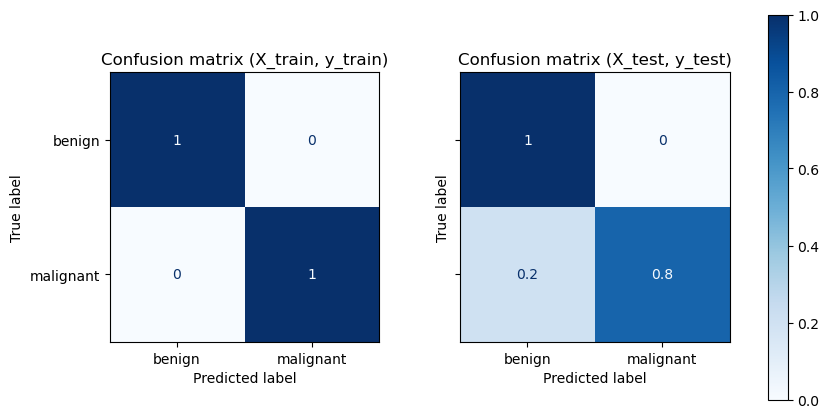

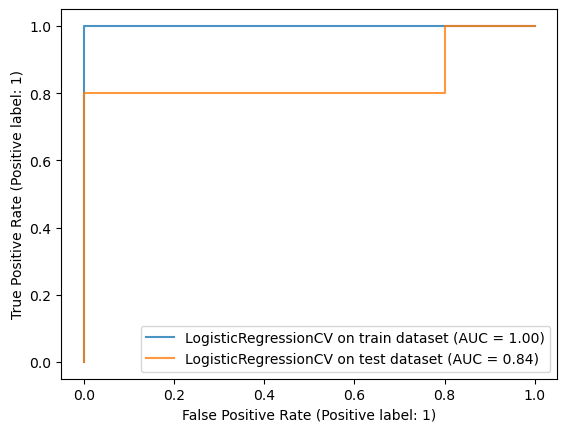

<Figure size 2000x500 with 0 Axes>

Detailed classification report:

The model is trained on the full development set.
The scores are computed on the full evaluation set.

              precision    recall  f1-score   support

           0       0.83      1.00      0.91         5
           1       1.00      0.80      0.89         5

    accuracy                           0.90        10
   macro avg       0.92      0.90      0.90        10
weighted avg       0.92      0.90      0.90        10




In [ ]:
eval_algo_train_and_test(X_test_prep_norm, y_test, X_train_prep_norm, y_train, log_reg_norm)

In [ ]:
verif_norm = X_test_prep_norm.copy()
verif_norm['y_true'] = y_test['label']
verif_norm['y_pred'] = log_reg_norm.predict(X_test_prep_norm)
verif_norm['y_pred_prob_ben'], verif_norm['y_pred_prob_mal']= log_reg_norm.predict_proba(X_test_prep_norm)[:,0], log_reg_norm.predict_proba(X_test_prep_norm)[:,1]
verif_norm

,scale_and_norm__cortisol,scale_and_norm__composé S,scale_and_norm__17OHP,scale_and_norm__Delta4A,scale_and_norm__Testostérone,scale_and_norm__Progestérone,scale_and_norm_p__cortisol_x_composé S,scale_and_norm_p__cortisol_/_composé S,scale_and_norm_p__cortisol_x_17OHP,scale_and_norm_p__cortisol_/_17OHP,...,scale_and_norm_p__Delta4A_x_Progestérone,scale_and_norm_p__Delta4A_/_Progestérone,scale_and_norm_p__Testostérone_x_Progestérone,scale_and_norm_p__Testostérone_/_Progestérone,remainder__sexe_M,remainder__age,y_true,y_pred,y_pred_prob_ben,y_pred_prob_mal
21,0.347408,-0.455769,-0.211110,-0.304394,-0.475981,4.214537,0.212643,-0.166092,1.710934,-0.341215,...,3.230845,-1.205479,2.036367,-0.740859,0.0,24.0,1,0,0.999795,2.050600e-04
2,0.323277,-0.094750,-0.547453,-0.277971,-0.484071,-0.137957,1.437559,-0.575304,-0.989931,-0.181766,...,-0.374675,-0.674532,-0.772180,-0.686786,0.0,42.0,1,1,0.063428,9.365721e-01
35,0.315283,-0.031459,-0.387324,-0.276943,-0.465240,-0.042611,1.256516,-0.510408,-0.710129,0.062058,...,-0.383470,0.092629,-0.722603,-0.523359,0.0,75.0,1,1,0.000002,9.999981e-01
16,0.352224,-0.522868,-0.666912,-0.347331,-0.496001,-0.264210,-1.517887,0.499615,-1.361447,5.458612,...,-0.658717,-0.881003,-0.854680,-0.556030,0.0,63.0,0,0,0.999331,6.690602e-04
36,0.323758,-0.160978,-0.017597,-0.165703,-0.329554,-0.327607,0.811614,-0.491476,0.302520,-0.539372,...,-0.209319,3.347908,-0.509769,0.317532,0.0,54.0,1,1,0.000012,9.999875e-01
8,0.348945,-0.415146,-0.540571,-0.333080,-0.510509,0.304808,1.079295,-0.407983,-0.200308,0.113917,...,-0.203426,-1.137691,-0.652814,-0.739124,0.0,68.0,1,1,0.003870,9.961295e-01
18,0.351984,-0.516459,-0.577741,-0.336413,-0.480001,-0.514221,-1.053982,0.346677,-0.831997,1.565607,...,-0.625625,0.021929,-0.811832,-0.205465,0.0,67.0,0,0,0.619277,3.807229e-01
28,0.352144,-0.548310,-0.588039,-0.337177,-0.507686,1.236367,-1.205815,1.440055,-0.632673,2.348632,...,0.004347,-1.124163,-0.427027,-0.727155,0.0,38.0,0,0,1.000000,3.722094e-07
26,0.352343,-0.544665,-0.515080,-0.337950,-0.499045,-0.309818,-1.511999,1.430303,-0.874857,1.397236,...,-0.618904,-0.372359,-0.840023,-0.504012,0.0,59.0,0,0,0.999748,2.523365e-04
22,0.338491,-0.418932,-0.062817,-0.107789,-0.432027,0.399067,-0.181084,-0.439890,1.124685,-0.726144,...,1.828292,-0.055411,-0.114245,-0.655997,0.0,26.0,0,0,0.890554,1.094455e-01


##### Test explainer shap (XAI) on logreg norm

In [ ]:
import shap
#pd.options.display.float_format = "{:.3f}".format
#sns.set(style='darkgrid', context='talk', palette='rainbow')
shap.initjs()

explainer = shap.Explainer(log_reg_norm.predict, X_test_prep_norm, feature_names=X_test_prep_norm.columns)
shap_values = explainer(X_test_prep_norm)
print(f"Shap values length: {len(shap_values)}\n")
print(f"Sample shap value:\n{shap_values[0]}")

Shap values length: 10

Sample shap value:
.values =
array([ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00, -1.66666667e-02,  8.33333333e-03, -8.33333333e-03,
        3.33333333e-02,  5.83333333e-02,  4.16666667e-02,  1.66666667e-02,
        0.00000000e+00, -4.62592927e-18, -4.16666667e-02,  2.50000000e-02,
        0.00000000e+00, -8.33333333e-03,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  1.66666667e-02,  8.33333333e-03, -8.33333333e-02,
        2.50000000e-02, -1.66666667e-02, -8.33333333e-03, -8.33333333e-03,
        0.00000000e+00,  8.33333333e-03,  0.00000000e+00, -8.33333333e-03,
        4.16666667e-02, -3.33333333e-02, -3.33333333e-02,  8.33333333e-03,
        0.00000000e+00, -4.25000000e-01])

.base_values =
0.4

.data =
array([ 0.34740797, -0.45576896, -0.21111017, -0.30439433, -0.47598091,
        4.21453675,  0.21264283, -0.16609193,  1.71093365, -0.34121529,
       -0.05491789, -0.03418272, -0.47109364,  0.2722298 

shap.plots.beeswarm(shap_values)

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


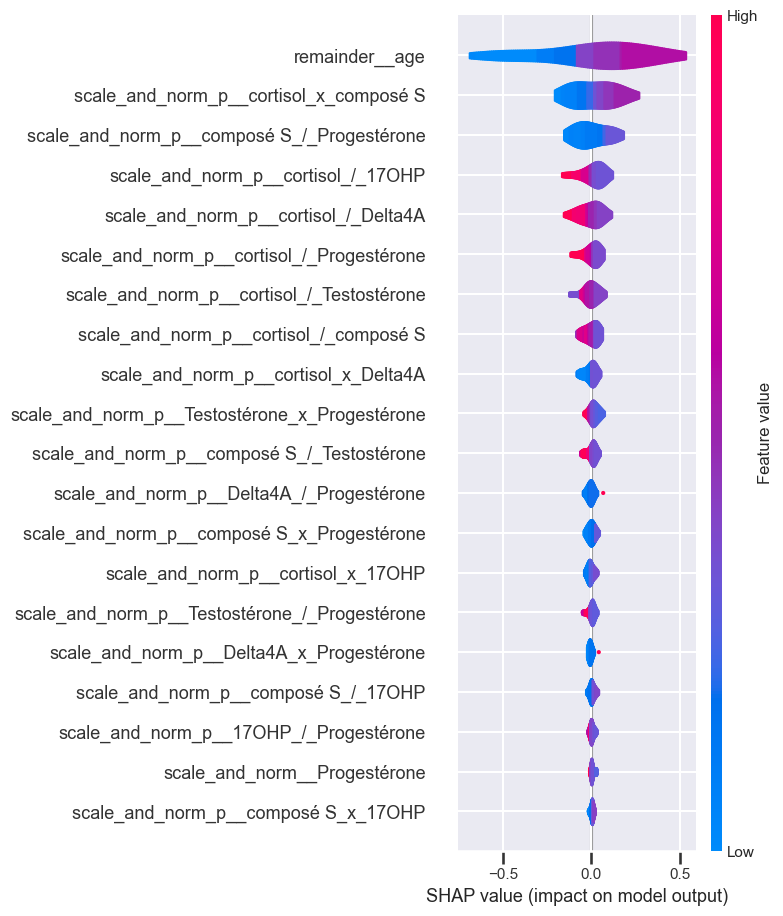

In [ ]:
shap.summary_plot(shap_values, plot_type='violin')

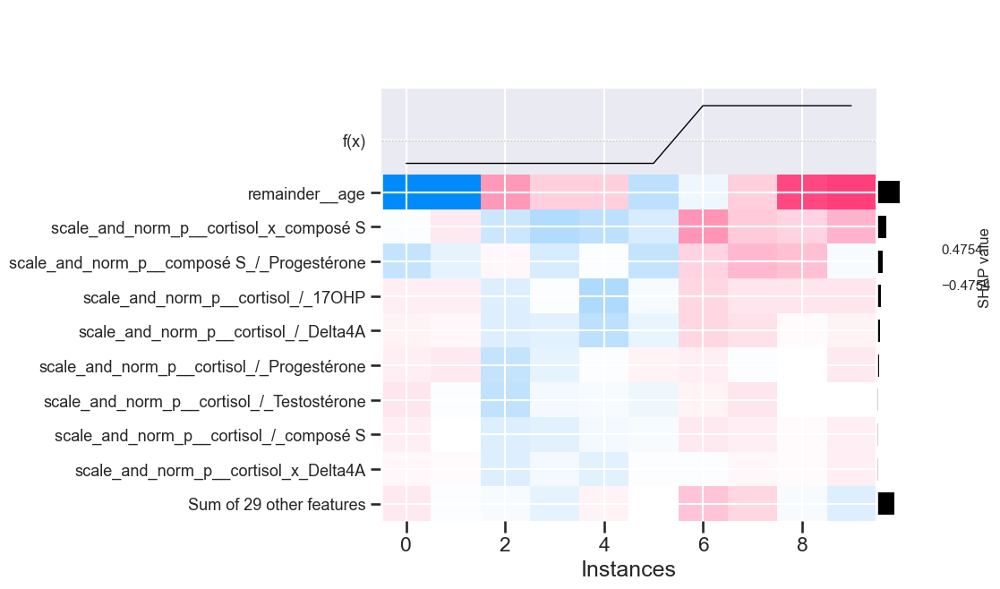

In [ ]:
shap.plots.heatmap(shap_values)

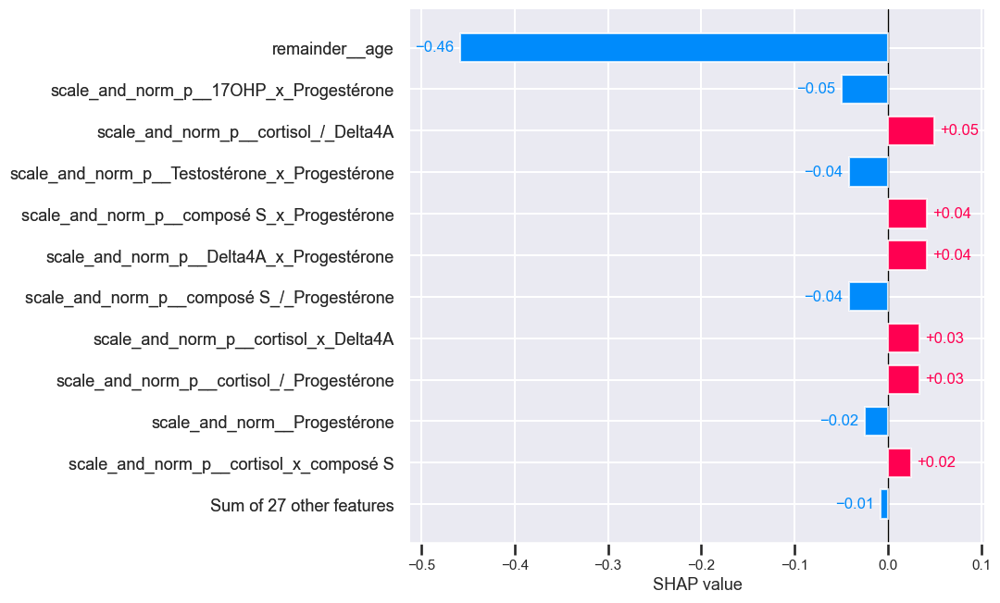

In [ ]:
shap.plots.bar(shap_values[0], max_display=12)

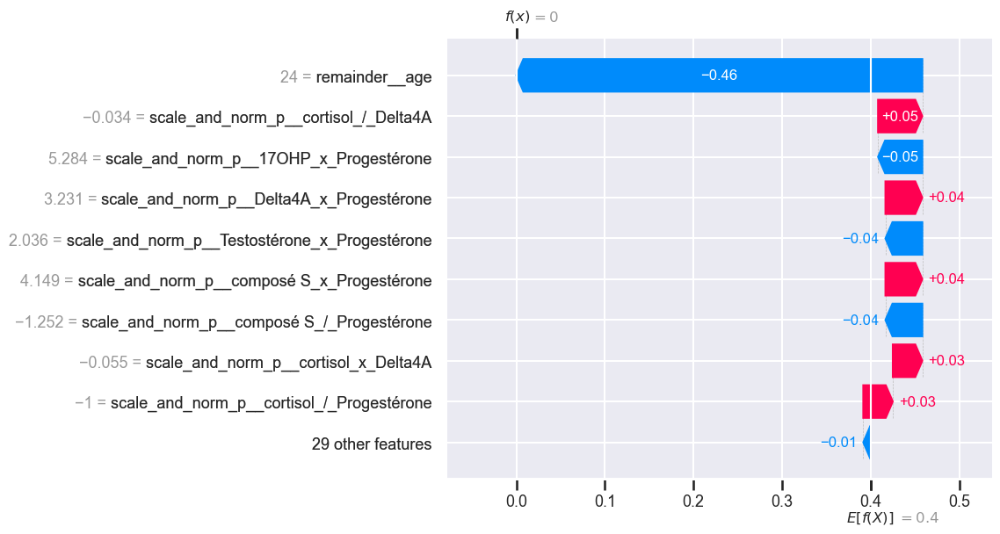

In [ ]:
shap.plots.waterfall(shap_values[0])

In [ ]:
shap.plots.force(shap_values[0])

### Test sur régression logistique avec minmax scaling

In [ ]:
log_reg_minmax = LogisticRegressionCV(max_iter=500, class_weight='balanced', cv=5)
# fit the model with data
log_reg_minmax.fit(X_train_prep_minmax,y_train['label'])

LogisticRegressionCV(class_weight='balanced', cv=5, max_iter=500)

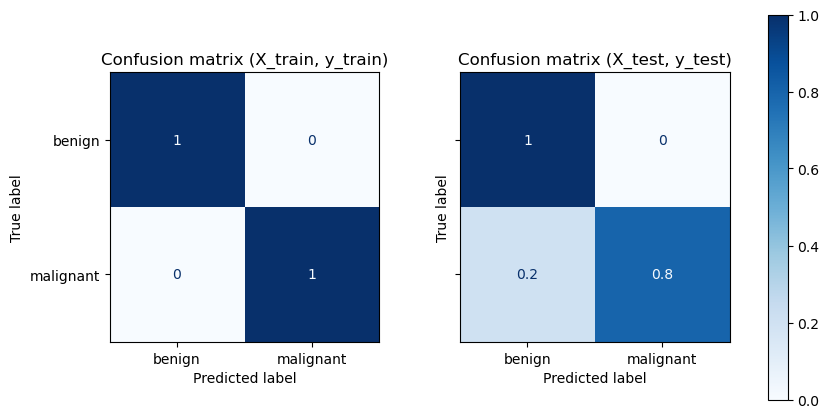

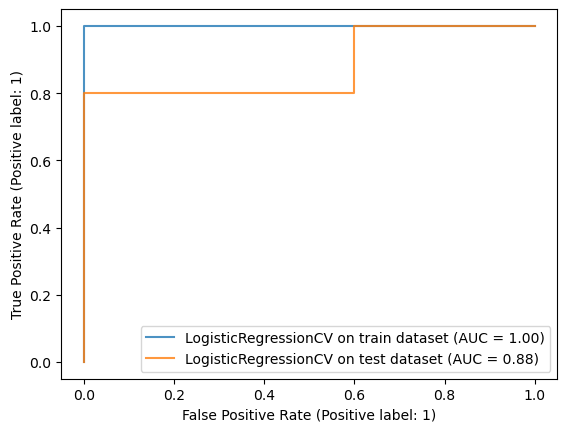

<Figure size 2000x500 with 0 Axes>

Detailed classification report:

The model is trained on the full development set.
The scores are computed on the full evaluation set.

              precision    recall  f1-score   support

           0       0.83      1.00      0.91         5
           1       1.00      0.80      0.89         5

    accuracy                           0.90        10
   macro avg       0.92      0.90      0.90        10
weighted avg       0.92      0.90      0.90        10




In [ ]:
eval_algo_train_and_test(X_test_prep_minmax,y_test,X_train_prep_minmax,y_train,log_reg_minmax)

##### Test explainer shap (XAI) on logreg minmax_scaling

In [ ]:
explainer = shap.Explainer(log_reg_minmax.predict, X_test_prep_minmax, feature_names=X_test_prep_minmax.columns)
shap_values_prep_minmax = explainer(X_test_prep_minmax)
print(f"Shap values length: {len(shap_values_prep_minmax)}\n")
print(f"Sample shap value:\n{shap_values_prep_minmax[0]}")

Shap values length: 10

Sample shap value:
.values =
array([ 0.00000000e+00, -3.41666667e-01,  1.66666667e-02, -8.33333333e-03,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00, -3.33333333e-02,
       -8.33333333e-03, -2.31296463e-18,  8.33333333e-03,  2.50000000e-02,
        0.00000000e+00,  8.33333333e-03,  0.00000000e+00, -8.33333333e-03,
       -8.33333333e-03,  4.16666667e-02,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        8.33333333e-03,  0.00000000e+00,  0.00000000e+00, -5.83333333e-02,
        0.00000000e+00, -2.50000000e-02,  0.00000000e+00, -1.66666667e-02,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00])

.base_values =
0.4

.data =
array([ 0.00000000e+00, -3.07692308e-02,  3.38192114e-01,  2.96892436e-02,
        1.05072464e-01,  7.35646889e-03,  9.03361345e-03,  1.10163447e+00,
        3.14753515e-02,  2.52833099e-01,  1.2768630

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


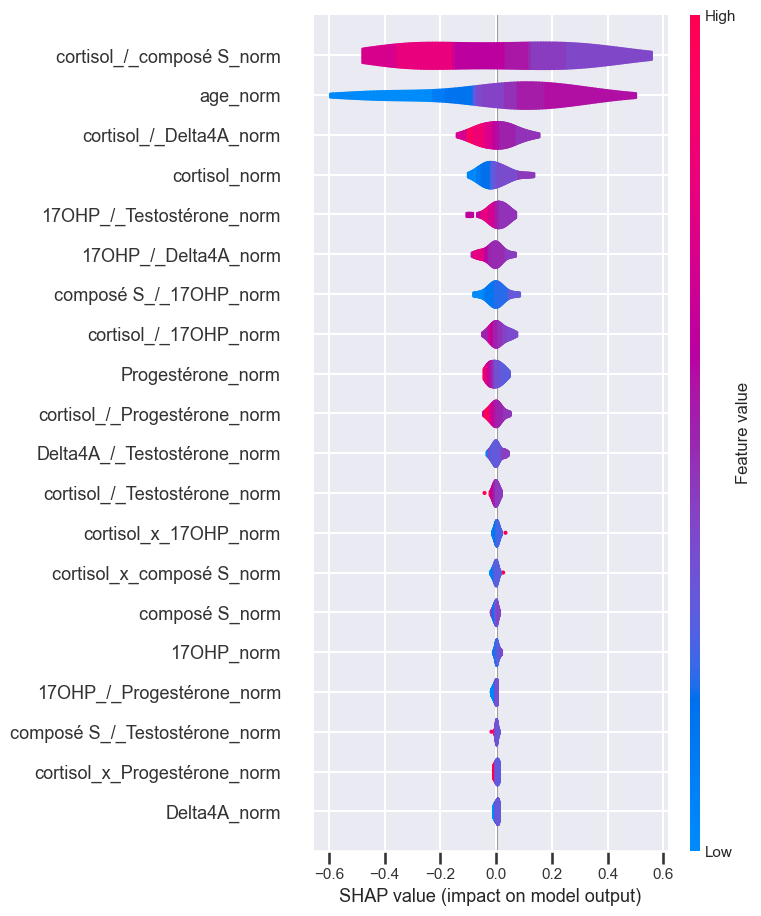

In [ ]:
shap.summary_plot(shap_values_prep_minmax, plot_type='violin')

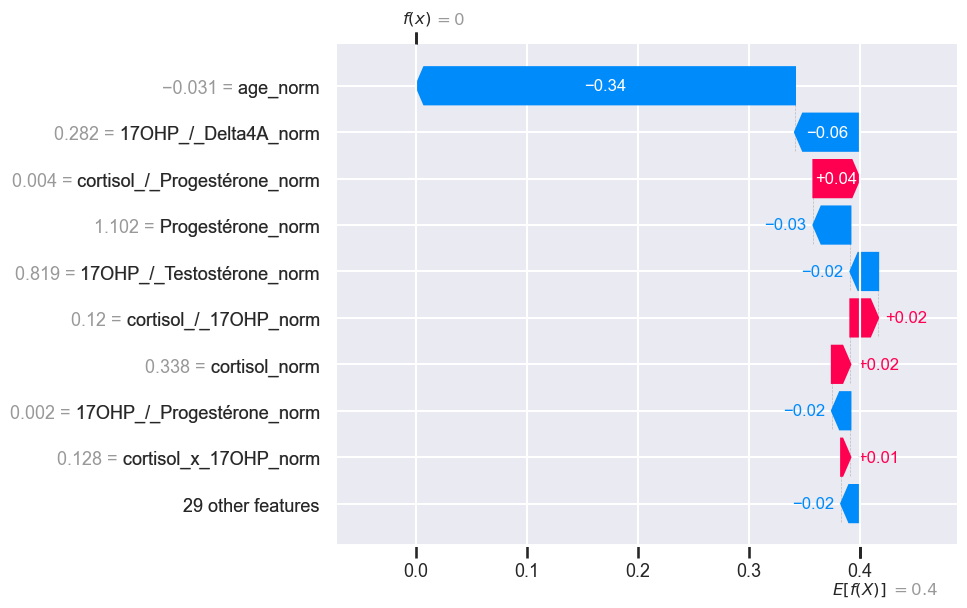

In [ ]:
shap.plots.waterfall(shap_values_prep_minmax[0])

In [ ]:
shap.plots.force(shap_values_prep_minmax[0])

### Test sur régression logistique sans normalisation

In [ ]:
# EXAMINER PLUS EN DETAILS LES HYPER PARAMETRES DE L'ESTIMATEUR
# instantiate the model (using the default parameters)
log_reg = LogisticRegressionCV(max_iter=500, class_weight='balanced', cv=5)
# fit the model with data
log_reg.fit(X_train_prep,y_train['label'])

LogisticRegressionCV(class_weight='balanced', cv=5, max_iter=500)

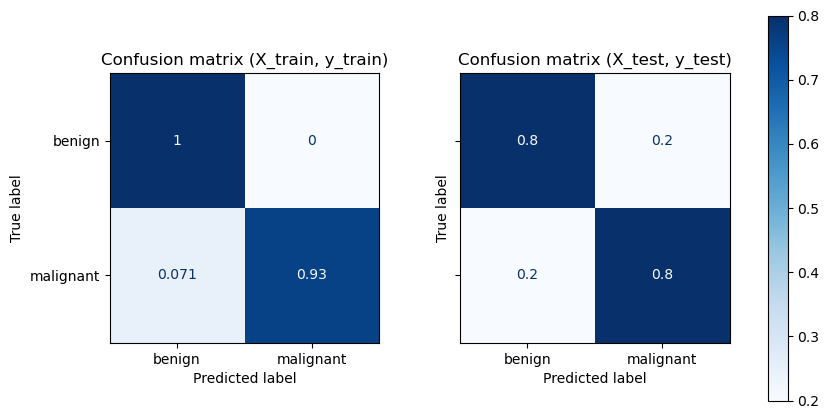

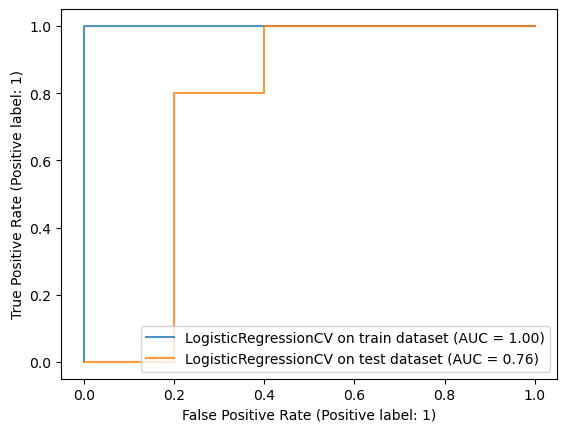

<Figure size 2000x500 with 0 Axes>

Detailed classification report:

The model is trained on the full development set.
The scores are computed on the full evaluation set.

              precision    recall  f1-score   support

           0       0.80      0.80      0.80         5
           1       0.80      0.80      0.80         5

    accuracy                           0.80        10
   macro avg       0.80      0.80      0.80        10
weighted avg       0.80      0.80      0.80        10




In [ ]:
eval_algo_train_and_test(X_test_prep,y_test,X_train_prep, y_train,log_reg)

##### Test explainer shap (XAI) on logreg

In [ ]:
explainer = shap.Explainer(log_reg.predict, X_test_prep, feature_names=X_test_prep.columns)
shap_values_prep = explainer(X_test_prep)
print(f"Shap values length: {len(shap_values_prep)}\n")
print(f"Sample shap value:\n{shap_values_prep[0]}")

Shap values length: 10

Sample shap value:
.values =
array([ 0.        ,  0.        ,  0.00833333,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        , -0.03333333,  0.        ,
       -0.01666667, -0.025     , -0.06666667,  0.01666667,  0.        ,
        0.        , -0.575     ,  0.19166667,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ])

.base_values =
0.5

.data =
array([0.00000000e+00, 2.40000000e+01, 4.95300000e+02, 3.92000000e+00,
       2.33000000e+00, 1.94000000e+00, 6.30000000e-01, 3.83000000e+00,
       1.94157600e+03, 1.26352041e+02, 1.15404900e+03, 2.12575107e+02,
       9.60882000e+02, 2.55309278e+02, 3.12039000e+02, 7.86190476e+02,
       1.89699900e+03, 1.29321149e+02, 9.13360000e+00, 1.68240343e+00,
       7.604

shap.plots.beeswarm(shap_values_prep)

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


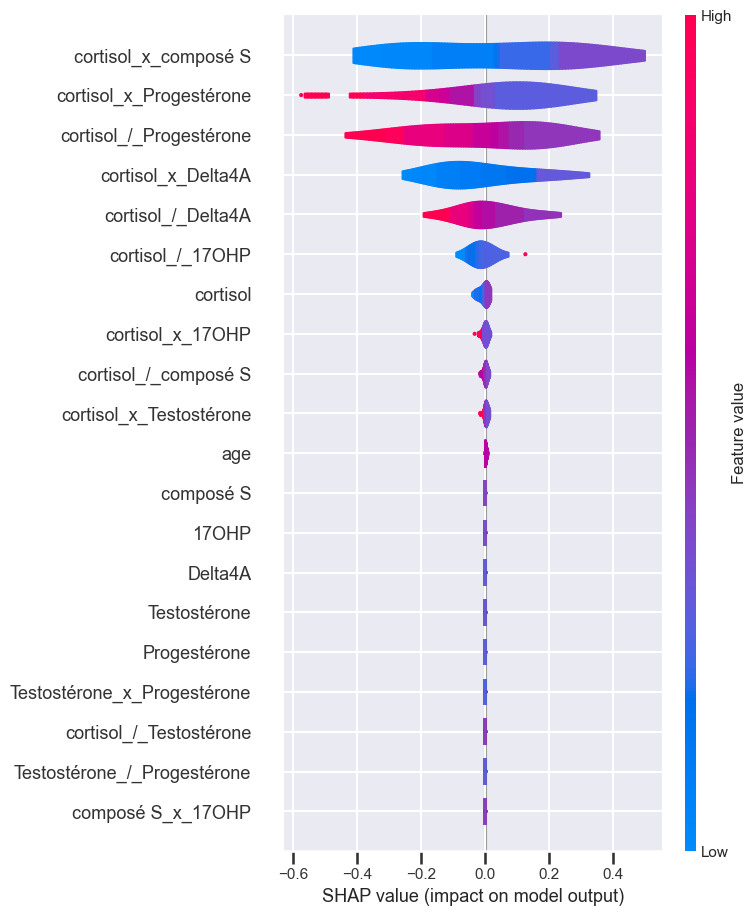

In [ ]:
shap.summary_plot(shap_values_prep, plot_type='violin')

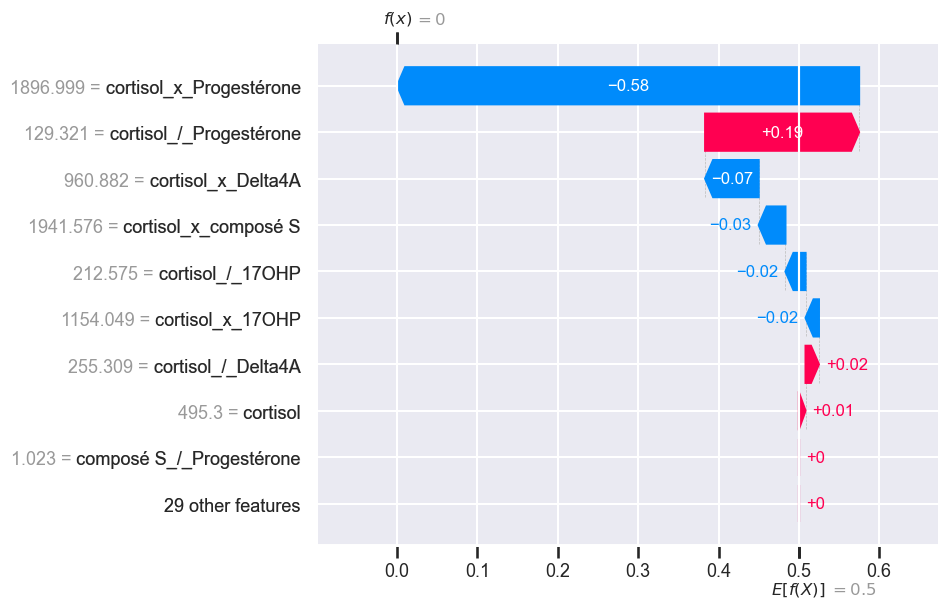

In [ ]:
shap.plots.waterfall(shap_values_prep[0])

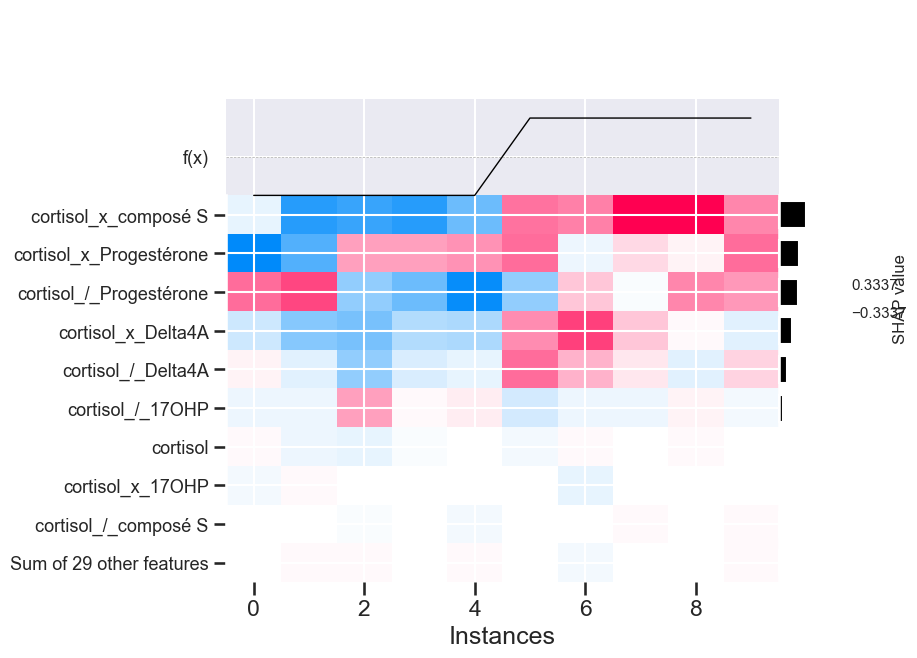

In [ ]:
shap.plots.heatmap(shap_values_prep)

In [ ]:
shap.plots.force(shap_values_prep[0])

### Test sur régression logistique, minmax scaling et features sélection

In [ ]:
X_train_prep_minmax.shape

(27, 38)

In [ ]:
New_X = featureSelect_dataframe(X_train_prep_minmax, y_train, chi2, 22)
selected_features = New_X.columns
X_train_prep_minmax[selected_features].head()

,composé S_norm,17OHP_norm,Delta4A_norm,cortisol_x_composé S_norm,cortisol_/_composé S_norm,cortisol_x_17OHP_norm,cortisol_x_Delta4A_norm,cortisol_/_Delta4A_norm,cortisol_/_Testostérone_norm,composé S_x_17OHP_norm,...,composé S_x_Testostérone_norm,composé S_x_Progestérone_norm,composé S_/_Progestérone_norm,17OHP_x_Delta4A_norm,17OHP_/_Delta4A_norm,17OHP_x_Testostérone_norm,17OHP_x_Progestérone_norm,Delta4A_x_Testostérone_norm,Delta4A_x_Progestérone_norm,Delta4A_/_Progestérone_norm
20,0.014033,0.080331,0.002079,0.013508,0.414111,0.082325,0.002829,0.357082,0.208902,0.001992,...,0.000174,0.008409,0.010105,0.000559,0.470149,0.000891,0.064883,0.000061,0.002345,0.006480
30,0.025378,0.072981,0.006717,0.021863,0.235190,0.070708,0.006275,0.176197,0.202791,0.003113,...,0.000318,0.092804,0.000000,0.001039,0.216233,0.000798,0.386663,0.000132,0.032472,0.000000
0,0.005596,0.001501,0.000032,0.004700,0.623933,0.000000,0.000571,0.464635,0.171888,0.000044,...,0.000054,0.000595,0.023281,0.000000,0.126151,0.000085,0.000748,0.000025,0.000036,0.018220
13,0.363862,0.351967,0.176875,0.669579,0.034980,0.781893,0.322011,0.019789,0.020137,0.172659,...,0.100576,0.191547,0.281523,0.085030,0.032913,0.076196,0.258341,0.059230,0.097950,0.325195
27,0.004497,0.187526,0.002170,0.005602,0.936734,0.192367,0.002974,0.356532,0.003234,0.001913,...,0.004147,0.001973,0.006199,0.001281,1.000000,0.081331,0.088182,0.003260,0.001378,0.012097


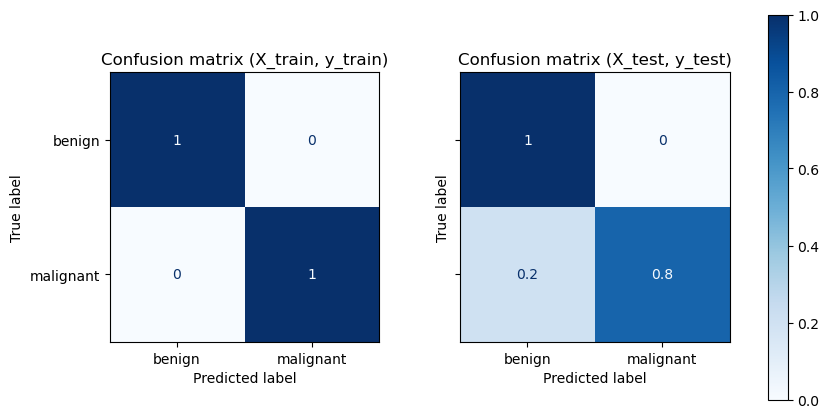

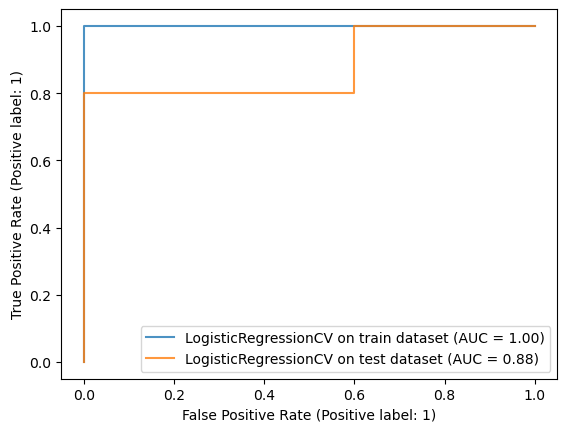

<Figure size 2000x500 with 0 Axes>

Detailed classification report:

The model is trained on the full development set.
The scores are computed on the full evaluation set.

              precision    recall  f1-score   support

           0       0.83      1.00      0.91         5
           1       1.00      0.80      0.89         5

    accuracy                           0.90        10
   macro avg       0.92      0.90      0.90        10
weighted avg       0.92      0.90      0.90        10




In [ ]:
New_X = featureSelect_dataframe(X_train_prep_minmax, y_train, chi2, 27)
selected_features = New_X.columns
log_reg_select = LogisticRegressionCV(max_iter=10000, class_weight='balanced', cv=5)
# fit the model with data
log_reg_select.fit(X_train_prep_minmax[selected_features],y_train['label'])
    
eval_algo_train_and_test(X_test_prep_minmax[selected_features],y_test, X_train_prep_minmax[selected_features], y_train ,log_reg_select)

#### interpreter les résultats...

In [ ]:
verif = X_test_prep_minmax[selected_features].copy()
verif['y_true'] = y_test['label']
verif['y_pred'] = log_reg_select.predict(X_test_prep_minmax[selected_features])
verif['y_pred_prob_ben'], verif['y_pred_prob_mal']= log_reg_select.predict_proba(X_test_prep_minmax[selected_features])[:,0], log_reg_select.predict_proba(X_test_prep_minmax[selected_features])[:,1]

In [ ]:
verif.columns

Index(['age_norm', 'composé S_norm', '17OHP_norm', 'Delta4A_norm',
       'Testostérone_norm', 'cortisol_x_composé S_norm',
       'cortisol_/_composé S_norm', 'cortisol_x_17OHP_norm',
       'cortisol_/_17OHP_norm', 'cortisol_x_Delta4A_norm',
       'cortisol_/_Delta4A_norm', 'cortisol_x_Testostérone_norm',
       'cortisol_/_Testostérone_norm', 'composé S_x_17OHP_norm',
       'composé S_/_17OHP_norm', 'composé S_x_Delta4A_norm',
       'composé S_x_Testostérone_norm', 'composé S_x_Progestérone_norm',
       'composé S_/_Progestérone_norm', '17OHP_x_Delta4A_norm',
       '17OHP_/_Delta4A_norm', '17OHP_x_Testostérone_norm',
       '17OHP_x_Progestérone_norm', 'Delta4A_x_Testostérone_norm',
       'Delta4A_x_Progestérone_norm', 'Delta4A_/_Progestérone_norm',
       'Testostérone_x_Progestérone_norm', 'y_true', 'y_pred',
       'y_pred_prob_ben', 'y_pred_prob_mal'],
      dtype='object')

In [ ]:
verif

,age_norm,composé S_norm,17OHP_norm,Delta4A_norm,Testostérone_norm,cortisol_x_composé S_norm,cortisol_/_composé S_norm,cortisol_x_17OHP_norm,cortisol_/_17OHP_norm,cortisol_x_Delta4A_norm,...,17OHP_x_Testostérone_norm,17OHP_x_Progestérone_norm,Delta4A_x_Testostérone_norm,Delta4A_x_Progestérone_norm,Delta4A_/_Progestérone_norm,Testostérone_x_Progestérone_norm,y_true,y_pred,y_pred_prob_ben,y_pred_prob_mal
21,-0.030769,0.029689,0.105072,0.007356,0.009034,0.031475,0.252833,0.127686,0.120298,0.008673,...,0.001489,0.579709,0.000193,0.038073,-0.000084,0.076214,1,0,0.997371,0.002629
2,0.246154,0.117354,0.026915,0.011834,0.007038,0.117349,0.062692,0.036210,0.365150,0.012955,...,0.000391,0.024070,0.000239,0.006730,0.027887,0.007552,1,1,0.046042,0.953958
35,0.753846,0.076438,0.031056,0.005811,0.005042,0.044788,0.054611,0.018632,0.188796,0.003622,...,0.000346,0.017143,0.000106,0.002450,0.024267,0.003771,1,1,0.000558,0.999442
16,0.569231,0.004920,-0.008075,-0.001503,0.000000,0.002935,0.508708,-0.008779,1.068694,-0.000644,...,-0.000046,-0.000528,-0.000011,-0.000106,0.004753,0.000366,0,0,0.958446,0.041554
36,0.430769,0.065279,0.092650,0.019351,0.027521,0.043084,0.073682,0.069421,0.083961,0.012803,...,0.003289,0.028950,0.001082,0.004595,0.096866,0.010188,1,1,0.010099,0.989901
8,0.646154,0.053613,0.043064,0.004190,0.002311,0.073348,0.192574,0.077537,0.351620,0.007865,...,0.000297,0.079410,0.000052,0.007327,0.003794,0.010066,1,1,0.131472,0.868528
18,0.630769,0.010669,0.011905,0.000746,0.005252,0.009538,0.464495,0.011560,0.440061,0.001429,...,0.000178,0.003159,0.000034,0.000189,0.020944,0.001403,0,0,0.688618,0.311382
28,0.184615,0.005258,0.011905,0.000906,0.000420,0.005904,0.813720,0.013336,0.472681,0.001758,...,0.000048,0.041846,0.000007,0.004443,0.000266,0.008088,0,0,0.999941,0.000059
26,0.507692,0.002807,0.011905,-0.000480,0.000000,0.002189,0.749687,0.004405,0.308572,-0.000031,...,0.000036,0.004507,-0.000004,0.000092,0.010008,0.000366,0,0,0.998096,0.001904
22,0.000000,0.042987,0.155280,0.045631,0.022059,0.049248,0.196959,0.206642,0.090583,0.050624,...,0.004322,0.213071,0.001967,0.046869,0.047017,0.039083,0,0,0.758893,0.241107


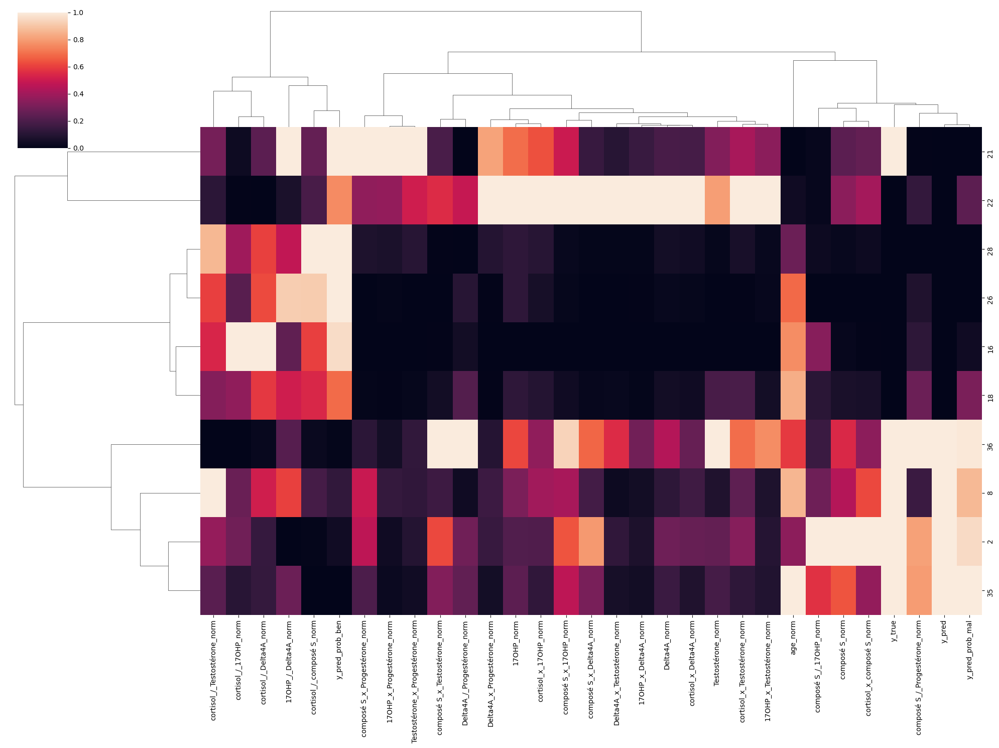

In [ ]:
sns.clustermap(verif, metric='correlation',standard_scale=1,figsize=(20,15))

### Test sur régression logistique et reduction de dimension avec features sélection

In [ ]:
log_reg_red = LogisticRegressionCV(max_iter=500, class_weight='balanced', cv=5)
# fit the model with data
log_reg_red.fit(X_train_prep_reduce[select_red],y_train['label'])

LogisticRegressionCV(class_weight='balanced', cv=5, max_iter=500)

In [ ]:
X_train_prep_reduce[select_red].columns

Index(['FeatureAgglomeration_1', 'FeatureAgglomeration_10',
       'FeatureAgglomeration_13', 'FeatureAgglomeration_17',
       'FeatureAgglomeration_18'],
      dtype='object')

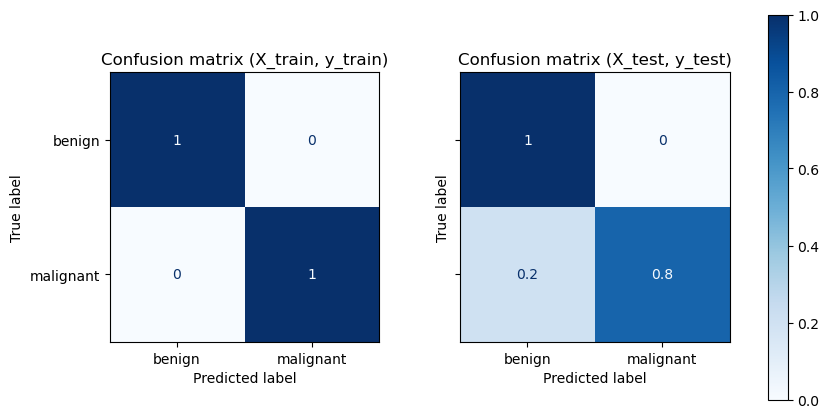

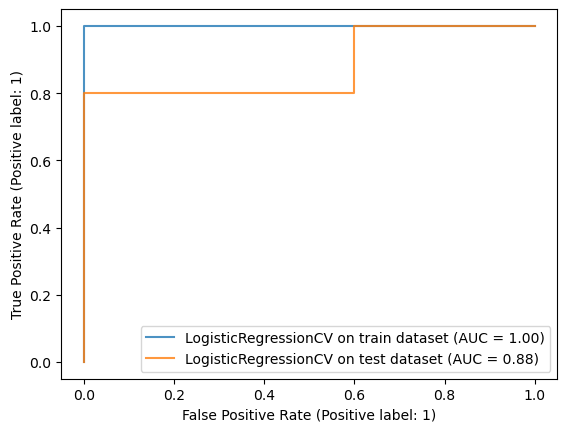

<Figure size 2000x500 with 0 Axes>

Detailed classification report:

The model is trained on the full development set.
The scores are computed on the full evaluation set.

              precision    recall  f1-score   support

           0       0.83      1.00      0.91         5
           1       1.00      0.80      0.89         5

    accuracy                           0.90        10
   macro avg       0.92      0.90      0.90        10
weighted avg       0.92      0.90      0.90        10




In [ ]:
eval_algo_train_and_test(X_test_prep_reduce[select_red],y_test,X_train_prep_reduce[select_red], y_train,log_reg_red)

#### interpreter les résultats...

In [ ]:
verif_reduce = X_test_prep_reduce[select_red].copy()
verif_reduce['y_true'] = y_test['label']
verif_reduce['y_pred'] = log_reg_red.predict(X_test_prep_reduce[select_red])
verif_reduce['y_pred_prob_ben'], verif_reduce['y_pred_prob_mal']= log_reg_red.predict_proba(X_test_prep_reduce[select_red])[:,0], log_reg_red.predict_proba(X_test_prep_reduce[select_red])[:,1]

In [ ]:
verif_reduce

,FeatureAgglomeration_1,FeatureAgglomeration_10,FeatureAgglomeration_13,FeatureAgglomeration_17,FeatureAgglomeration_18,y_true,y_pred,y_pred_prob_ben,y_pred_prob_mal
21,0.059493,0.281973,0.252833,0.204106,-0.030769,1,0,0.919072,0.080928
2,0.096545,0.054166,0.062692,0.141133,0.246154,1,1,0.205460,0.794540
35,0.048436,0.117145,0.054611,0.139435,0.753846,1,1,0.027959,0.972041
16,0.002923,0.110239,0.508708,0.717036,0.569231,0,0,0.896006,0.103994
36,0.040804,0.105417,0.073682,0.060235,0.430769,1,1,0.101899,0.898101
8,0.061693,0.191455,0.192574,0.391856,0.646154,1,1,0.274191,0.725809
18,0.007226,0.170369,0.464495,0.438470,0.630769,0,0,0.692588,0.307412
28,0.006960,0.162546,0.813720,0.450745,0.184615,0,0,0.993303,0.006697
26,0.001839,0.263525,0.749687,0.463884,0.507692,0,0,0.972172,0.027828
22,0.044931,0.070981,0.196959,0.046169,0.000000,0,0,0.607541,0.392459


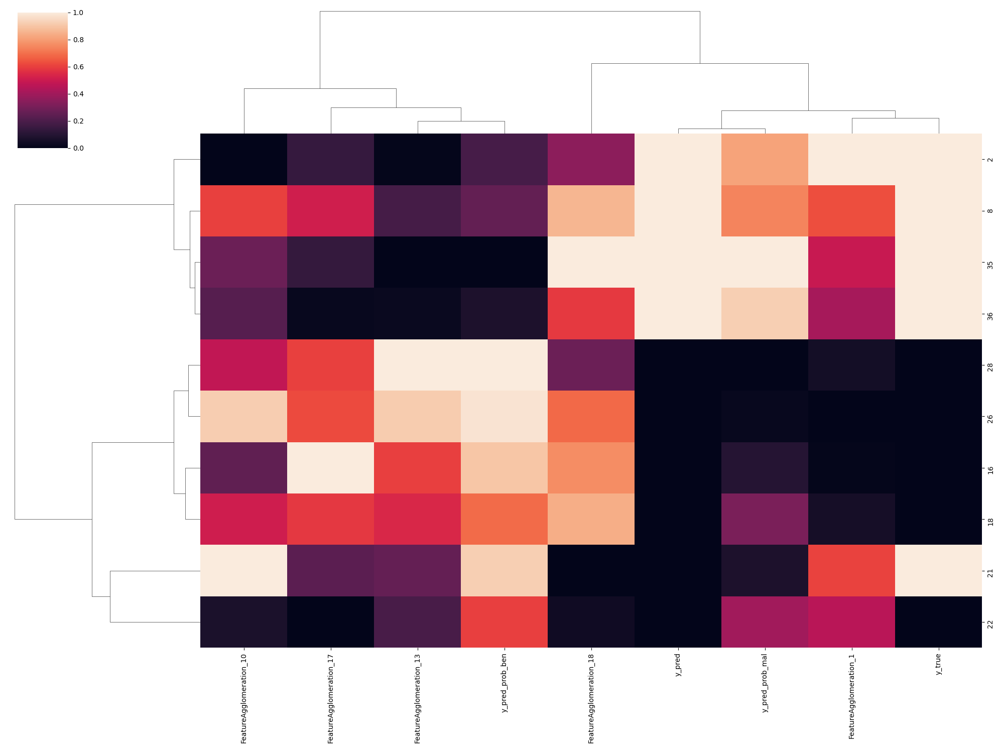

In [ ]:
sns.clustermap(verif_reduce, metric='correlation',standard_scale=1,figsize=(20,15))

NB : on voit bien sur la clustermap que les individus 21 et 22 sont des anomalies au vu des autres mais qu'ils sont quand-même plus proches des individus bénins (ce qui explique la mauvaise classification du 21)

### Naive Bayes Classifier (NB)

Les Naive Bayes sont un ensemble de méthodes de classification bayésienne probabiliste qui se basent sur le théorème de Bayes avec la supposition "naïve" que les variables explicatives sont indépendantes.

NB : Il s'agit d'un classifieur linéaire.

Plus concrétement, le théorème de Bayes établi que, étant donné une variable $y$ et les vecteurs des features dont elle dépend $x_1, ..., x_n$ : 
$P(y|x_1, ..., x_n) =  \frac{P(y) P(x_1, ..., x_n|y)}{P(x_1, ..., x_n)}$

En posant la condition d'indépendance des variables explicatives on a :
$P(x_i|y, x_1, ...x_{i-1},x_{i+1}, x_n) =  P(x_i|y)$

Pour tout $i$, cette relation est simplifiée en : 
$P(y|x_1, ..., x_n) =  \frac{P(y) \prod_{i=1}^{n} P(x_i|y)}{ P(x_1, ..., x_n)}$

De plus, étant donné que $P(x_1, ..., x_n)$ est constant pour des valeurs d'entrée données, on a : 

$P(y|x_1, ..., x_n) \propto P(y) \prod_{i=1}^{n} P(x_i|y)$

on peut utiliser la règle de classification MAP (maximum a posteriori) qui consiste à choisir l'hypothèse la plus probable avec le $argmax$ de $y$ : 

$\hat{y} = argmax\ P(y) \prod_{i=1}^{n} P(x_i|y)$

Principaux paramètres retenus sous scikit-learn : 
- priors - array-like, shape (n_classes,) : probabilité à priori des classes. Si spécifié, les probabilités à priori ne seront pas ajusté en fonction des donées.
- var_smoothing - float, optional (default=1e-9) : portion de la plus grande variance parmis toutes les features qui est ajoutés aux variances pour le calcul de stabilité

In [ ]:
New_X = featureSelect_dataframe(X_train_prep, y_train, chi2, 25)
selected_features = New_X.columns

In [ ]:
from sklearn.naive_bayes import GaussianNB
nb_classifier = GaussianNB()
# fit the model with data
nb_classifier.fit(X_train_prep[selected_features],y_train['label'])

GaussianNB()

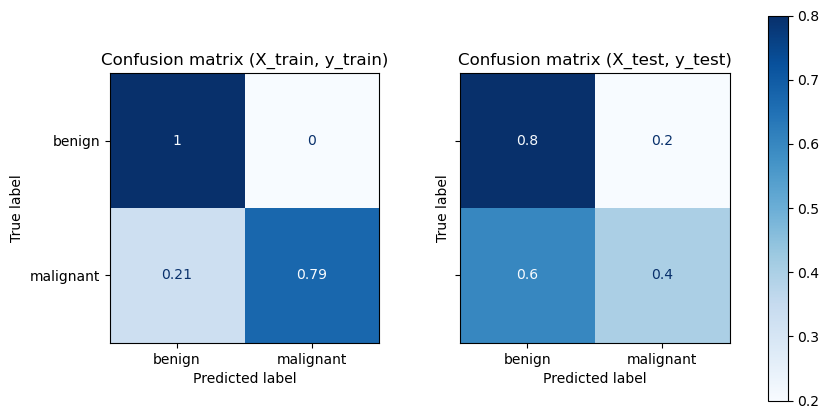

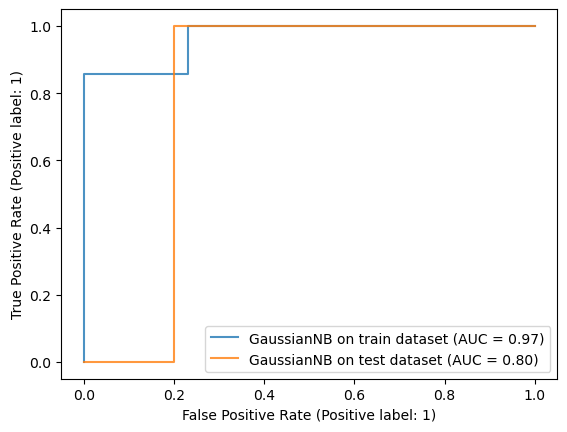

<Figure size 2000x500 with 0 Axes>

Detailed classification report:

The model is trained on the full development set.
The scores are computed on the full evaluation set.

              precision    recall  f1-score   support

           0       0.57      0.80      0.67         5
           1       0.67      0.40      0.50         5

    accuracy                           0.60        10
   macro avg       0.62      0.60      0.58        10
weighted avg       0.62      0.60      0.58        10




In [ ]:
eval_algo_train_and_test(X_test_prep[selected_features],y_test,X_train_prep[selected_features],y_train,nb_classifier)

### K-Nearest Neighbors Classifier (KNN Classifier)

Classifieur non-paramétrique qui se base uniquement sur les données d'entrainement : 
- il repose sur un algo géométrique (distances ou similarités avec les k plus proches voisins) 
- et est dit "memory based" (doit conserver en mémoire l'ensemble de données).

Assez simpliste, la classe de l'individu à prédire est déterminée par vote majoritaire des k plus proches voisins, éventuellement, certaines variantes attribuent un poids à ces votes (selon la distance pour pénaliser des voisins trop éloignés par exemple)

(+) : facile à implémenter et comprendre, rapide à entrainer

(-) : pas efficace si jeu de données large, mauvaise estimation si variables explicatives nombreuses.

Hyperparamètres retenus sous scikit-learn : 
- n_neighbors - int, optional (default = 5) : nombre de voisins utilisés par l'algo
- weights - str or callable, optional (default = 'uniform') : poids des voisins ('uniform', 'distance' - poids inversement proportionnel à la distance, ou une fonction sur-mesure [callable])
- algorithm - {‘auto’, ‘ball_tree’, ‘kd_tree’, ‘brute’}, optional : détermine l'implémentation de l'algo à utiliser
- leaf_size - int, optional (default = 30) : pour KDTree et BallTree, affecte la construction de l'arbre , la mémoire utilisée et le temps requis
- metric - string or callable, default ‘minkowski’ : type de distance utilisée, on peut compléter ce paramètre avec les paramètre 'p' (puissance pour la distance de Minkowski, 1=manhattan, 2=eucliean) 

In [ ]:
from sklearn.neighbors import KNeighborsClassifier

print(KNeighborsClassifier().get_params().keys())
param_grid = {'n_neighbors': np.arange(2, 15), 
             'metric': ['euclidean','cosine','manhattan'],
              'weights': ['uniform', 'distance']
             } # déclaration des hyper paramètres à évaluer
score = 'f1'
param_score = '_weighted'#'_macro'
parametric_score = score + param_score #macro_score = '%s_macro' % score

scoring_grid = {'Accuracy': make_scorer(accuracy_score), 'F1_score': parametric_score} # déclaration des métriques à utiliser
cv_grid = 5 # nombre de fold pour la cross validation
refit_grid = 'Accuracy'

dict_keys(['algorithm', 'leaf_size', 'metric', 'metric_params', 'n_jobs', 'n_neighbors', 'p', 'weights'])


In [ ]:
grid = GridSearchCV(KNeighborsClassifier(), param_grid, cv=cv_grid, scoring=scoring_grid, refit=refit_grid)
grid.fit(X_train_prep_reduce[select_red], y_train['label'])
print(grid.best_estimator_)

KNeighborsClassifier(metric='cosine', n_neighbors=3)


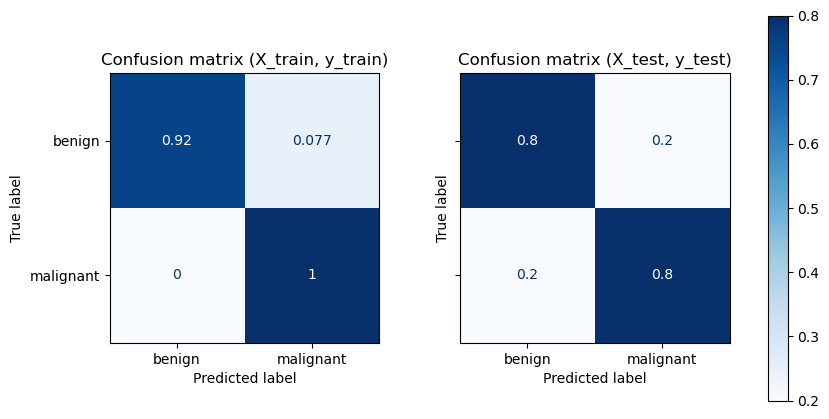

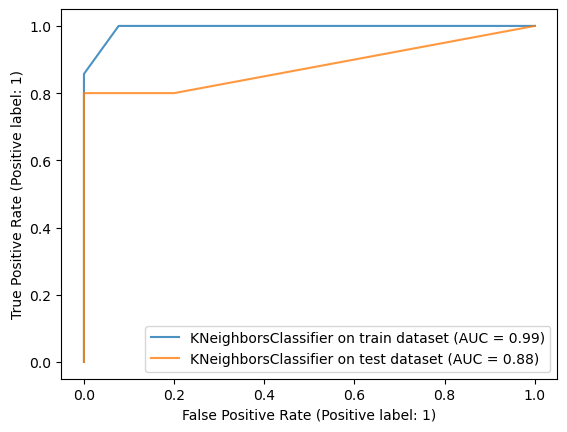

<Figure size 2000x500 with 0 Axes>

Detailed classification report:

The model is trained on the full development set.
The scores are computed on the full evaluation set.

              precision    recall  f1-score   support

           0       0.80      0.80      0.80         5
           1       0.80      0.80      0.80         5

    accuracy                           0.80        10
   macro avg       0.80      0.80      0.80        10
weighted avg       0.80      0.80      0.80        10




In [ ]:
knn_classifier_best = grid.best_estimator_
knn_classifier_best.fit(X_train_prep_reduce[select_red], y_train['label'])

eval_algo_train_and_test(X_test_prep_reduce[select_red],y_test,X_train_prep_reduce[select_red],y_train,knn_classifier_best)

In [ ]:
grid = GridSearchCV(KNeighborsClassifier(), param_grid, cv=cv_grid, scoring=scoring_grid, refit=refit_grid)
grid.fit(X_train_prep[selected_features], y_train['label'])
print(grid.best_estimator_)

KNeighborsClassifier(metric='cosine', n_neighbors=3)


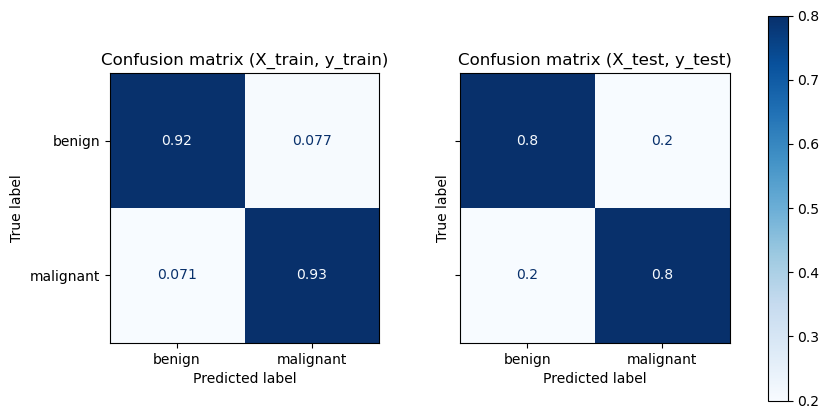

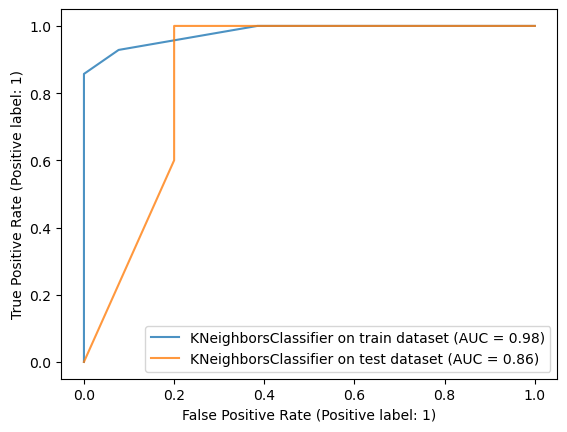

<Figure size 2000x500 with 0 Axes>

Detailed classification report:

The model is trained on the full development set.
The scores are computed on the full evaluation set.

              precision    recall  f1-score   support

           0       0.80      0.80      0.80         5
           1       0.80      0.80      0.80         5

    accuracy                           0.80        10
   macro avg       0.80      0.80      0.80        10
weighted avg       0.80      0.80      0.80        10




In [ ]:
knn_classifier2_best = grid.best_estimator_
knn_classifier2_best.fit(X_train_prep[selected_features], y_train['label'])

eval_algo_train_and_test(X_test_prep[selected_features],y_test,X_train_prep[selected_features],y_train,knn_classifier2_best)

##### verif des résultats

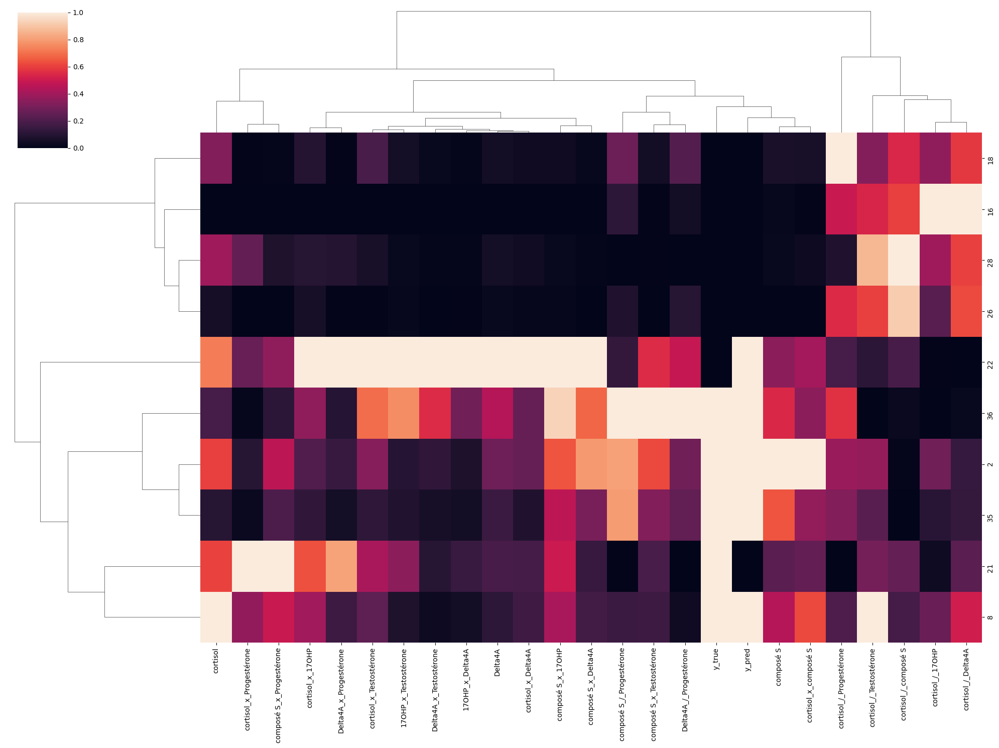

In [ ]:
verif_knn = X_test_prep[selected_features].copy()
verif_knn['y_true'] = y_test
verif_knn['y_pred'] =knn_classifier2_best.predict(X_test_prep[selected_features])
sns.clustermap(verif_knn, metric='correlation',standard_scale=1,figsize=(20,15))

## Decision Tree (DT)

Basiquement, un arbre de décision essaie de déterminer des frontières entre classes par identification de seuils et découpes successives de l'espace des variables explicatives. (Il s'agit d'une approche par dichotomie type "diviser pour reigner")

L'algorithme en charge de la construction de l'arbre converge lorsque : 
1. l'espace des variables explicatives a pu être divisé en classes pures 
2. ou lorsque certains critères établis par le classifieur sont atteints (profondeur de l'arbre, ...)

2 métriques alternatives : coef de Gini de l'impureté d'un noeud & entropie

(1) Le critère d'impureté : 
$H(x) = \sum{p(x) . (1 - p(x) ) }$ 

L'impureté exprime la présence d'éléments d'autres classes au sein de la classe observée, les éléments mal classés donc.
Cela peut-être dû à un nombre insufisant de features pour distinguer les classes entre elles ou à la tolérance d'un pourcentage d'impureté pour accélérer les calculs (compromis entre justesse de prédiction et rapidité). On peut s'arrêter de diviser les classes lorsque l'on atteint un nombre d'éléments restants inférieur à un certain seuil. Il s'agit de l'impureté de Gini.

(2) L'entropie (selon Shannon) : 
$H(x) = \sum{p(x) . \log{\frac{1}{p(x)}} } = - \sum{p(x) . \log{p(x)} }$ 

Mesure l'impureté (plus précisément elle mesure le désordre, une sorte de degré d'incertitude), lorsque l'on divise son jeu de données avec un critère de seuil sur une feature (noeud dans l'arbre), on cherche donc à réduire cette incertitude au maximum. On choisit donc la feature qui minimise l'entropie en premier (la plus déterminante pour "bien classer"/découper nos données de façon intelligente). Cette réduction d'inertie constitue le gain d'information engendré par la division (c'est ce que l'on cherche à maximiser à chaque division).

(3) Le gain d'information : 
$InfoGain(n) = H(x) - \sum_{i=1}^{n}{ w(i) \times H(i) }$ 

où $i$ désigne l'enfant pour la feature choisie, w(i) son poids (ratio du dataset partagé entre chaque enfant) et H(i) son entropie.

NB : si on utilise le coef de gini, il faut réadapter (3) mais le raisonement reste le même...


Tout simplement, en se basant sur ces 3 notions, l'algo va construire l'arbre de décision en maximisant à chaque étape le gain d'information.


(+) : facile à interpréter et visualiser,  non-linéaire, peu de préparation des données requise et pas besoin de normaliser, algo non paramétrique donc pas besoin de faire de supposition à propos de la distribution.

(-) : sensible au bruit donc peut overfeater des données bruitées, une variance faible des données peut donner différents arbres (cela peut être réduit avec des bagging et boosting algos), les arbres de décision peuvent être biaisé par des données non équilibrées, il est recommandé d'équilibre le dataset avant la création de l'arbre (chaque classe doit être suffisamment représentée...) 

Hyperparamètres retenus sous scikit-learn : 
- criterion - {“gini”, “entropy”}, default=”gini” : critère d'impureté
- splitter - {“best”, “random”}, default=”best” : choix de la stratégie de découpe pour sélectionner les features de division à chaque étape
- max_depth - int, default=None : profondeur maximale de l'arbre (critère limittant)
- min_samples_split - int or float, default=2 : nombre de samples minimal pour autoriser une division du dataset
- min_samples_leaf - int or float, default=1 : nombre de samples minimal requis pour chaque feuille (pour autoriser des enfants)
- min_weight_fraction_leaf - float, default=0.0 : la fraction minimal des données autoriser pour le poids d'une feuille
- max_features - int, float or {“auto”, “sqrt”, “log2”}, default=None : nombre de features à considérer lors de la recherche du meilleur critère de division
- max_leaf_nodes - int, default=None : nombre de feuilles maximal autorisé
- min_impurity_decrease - float, default=0.0 : on ne créé des enfants que si le gain d'info dépasse un certain seuil
- class_weight - dict, list of dict or “balanced”, default=None : voir si ça compense des jeu de données déséquilibré avec le 'balanced'

In [ ]:
def dtree_grid_search(X,y,kfolds):
    #create a dictionary of all values we want to test
    param_grid = { 'criterion':['gini','entropy']}
    # decision tree model
    dtree_model=DecisionTreeClassifier()
    #use gridsearch to test all values
    dtree_gscv = GridSearchCV(dtree_model, param_grid, cv=kfolds)
    #fit model to data
    dtree_gscv.fit(X,y)
    return dtree_gscv.best_estimator_

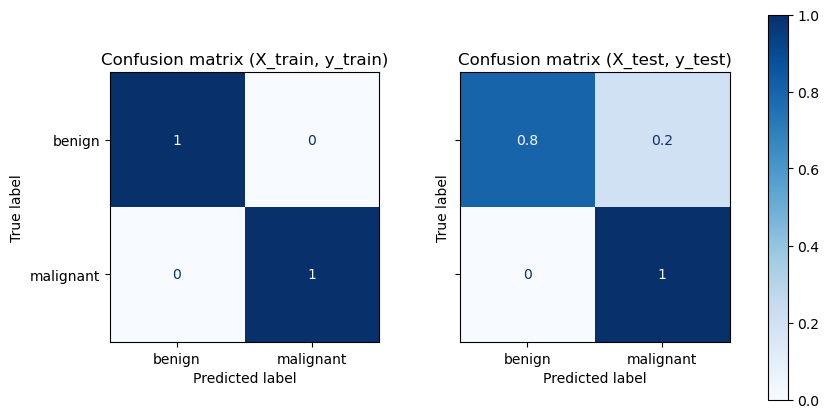

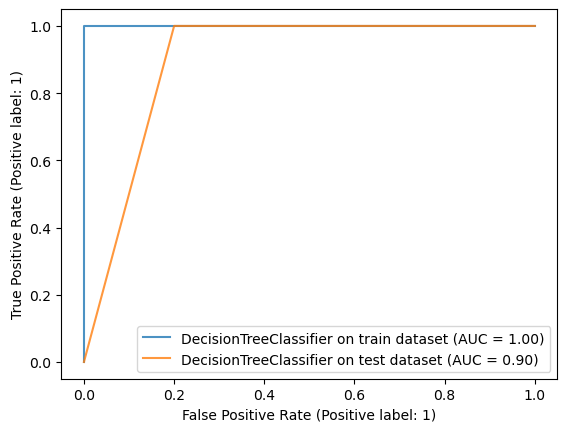

<Figure size 2000x500 with 0 Axes>

Detailed classification report:

The model is trained on the full development set.
The scores are computed on the full evaluation set.

              precision    recall  f1-score   support

           0       1.00      0.80      0.89         5
           1       0.83      1.00      0.91         5

    accuracy                           0.90        10
   macro avg       0.92      0.90      0.90        10
weighted avg       0.92      0.90      0.90        10




In [ ]:
dt_classifier = dtree_grid_search(X_train_prep, y_train,kfolds=5)
eval_algo_train_and_test(X_test_prep, y_test,X_train_prep, y_train, dt_classifier)

In [ ]:
with open('dt_classifier_perfect_recall.pkl', 'wb') as f:
    dump(dt_classifier, f)

#### explication des résultats

[Text(0.6, 0.875, 'composé S <= 5.76\ngini = 0.499\nsamples = 27\nvalue = [13, 14]'),
 Text(0.4, 0.625, 'Delta4A_x_Progestérone <= 1.211\ngini = 0.231\nsamples = 15\nvalue = [13, 2]'),
 Text(0.2, 0.375, 'gini = 0.0\nsamples = 12\nvalue = [12, 0]'),
 Text(0.6, 0.375, 'Delta4A_x_Testostérone <= 1.218\ngini = 0.444\nsamples = 3\nvalue = [1, 2]'),
 Text(0.4, 0.125, 'gini = 0.0\nsamples = 1\nvalue = [1, 0]'),
 Text(0.8, 0.125, 'gini = 0.0\nsamples = 2\nvalue = [0, 2]'),
 Text(0.8, 0.625, 'gini = 0.0\nsamples = 12\nvalue = [0, 12]')]

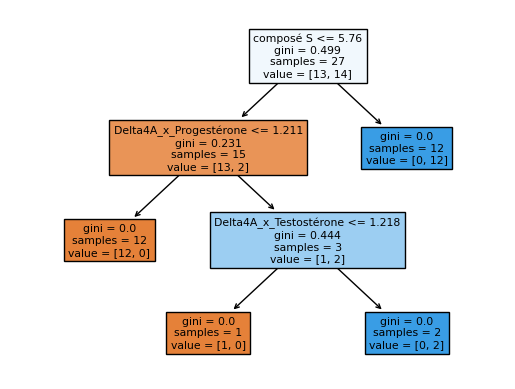

In [ ]:
plot_tree(dt_classifier,feature_names=X_test_prep.columns, filled=True)

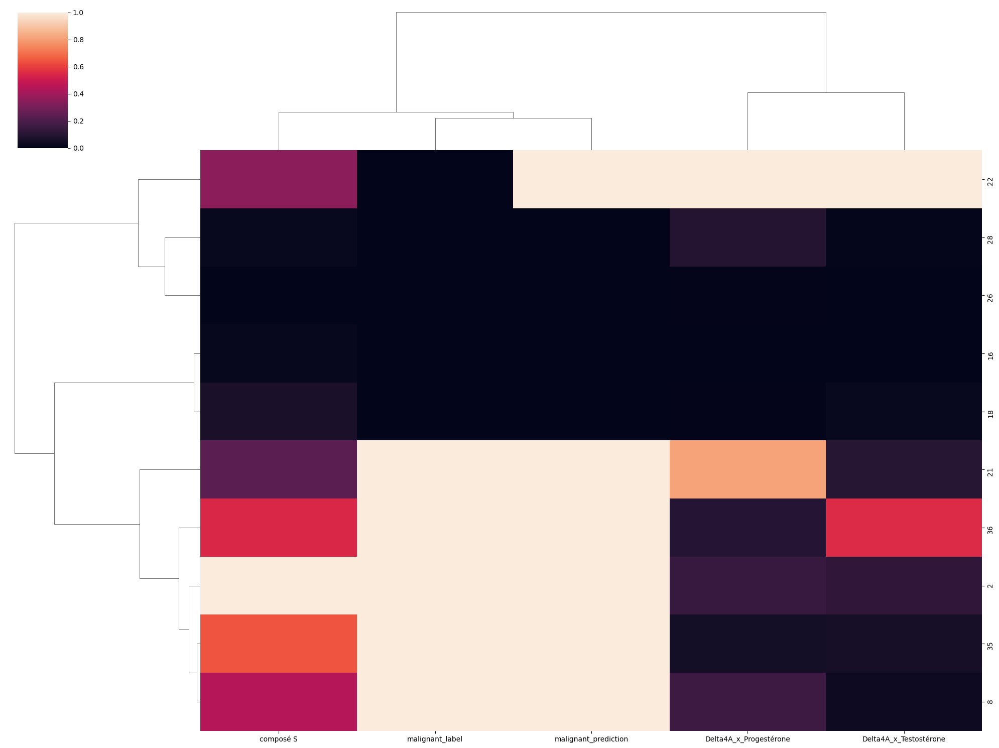

In [ ]:
verif_tree = X_test_prep[['composé S','Delta4A_x_Progestérone','Delta4A_x_Testostérone']].copy()
verif_tree['malignant_label'] = y_test['label']
verif_tree['malignant_prediction'] = dt_classifier.predict(X_test_prep)
sns.clustermap(verif_tree, metric='correlation',standard_scale=1,figsize=(20,15))

## Random Forest (RF) Classifier

Principes généraux :

Méthode ensembliste (ensemble learning) qui combine plusieurs arbres de décisions sur des sous-ensembles de données légèrement différents pour réaliser une tâche de classification. Cet algorithme repose sur les concepts de sous-espaces aléatoires et de bagging (bootstrap + agrégation).

Fonctionnement de l'algorithme : 

1. construit $I$ nouveaux ensemble d'apprentissage en se basant sur un double processus d'échantillonage
    1. tire aléatoirement $N$ enregistrements du dataset (tirage avec remise / bootstrap)
    2. en ne retenant qu'une portion des variables explicatives $X_1, .., X_n$ (généralement de taille $m < \sqrt{n}$) 
2. Construit un arbre de décision sur chacun des $I$ ensembles d'apprentissage (en limitant sa taille par validation croisée).
3. Stocke les $I$ prédiction de la variable cible $Y$
4. La valeur de $Y$ est alors déterminée par vote majoritaire (donnée par l'ensemble des $I$ prédictions)

(+) : biais réduit (grâce à l'aspect ensembliste -> bootstrap), stabilité accrue (l'insertion d'un nouvel enregistrement dans le dataset a peu de chances d'affecter tous les arbres), gère les données qualitatives et numériques, gère les données manquantes et non régularisées, parallélisable.

(-) : compléxité élevée ($\propto I$, le nb d'arbres votants), temps d'apprentissage plus élevé que celui des algos plus simples à ressources égales, perte du pouvoir explicatif des arbres de décision.

hyperparamètres retenus : 
- n_estimators - integer, optional (default=100) : nombre d'arbres de décisions à construire
- criterion - string, optional (default=”gini”) : fonction pour mesurer la qualité de division des arbres 'gini' ou 'entropy' 
- max_depth - integer or None, optional (default=None) : profondeur maximale autorisée
- min_samples_split - int, float, optional (default=2) : nb d'enregistrements minimal pour autoriser la division du noeud
- min_samples_leaf - int, float, optional (default=1) : nb d'enregistrements minimal par feuille
- min_weight_fraction_leaf - float, optional (default=0.) : nb d'enregistrements minimal par feuille en proportion du total d'enregistrement
- max_leaf_nodes - int or None, optional (default=None) : limite le nombre de feuilles max des arbres
- min_impurity_decrease - float, optional (default=0.) : limite la division si l réduction d'impureté n'est pas suffisante.
- bootstrap - boolean, optional (default=True) : création des sous-ensembles d'apprentissage par bootstrap pour la construction des arbres liés, si False on utilise le même ensemble d'apprentissage pour tous les arbres.
- class_weight - dict, list of dicts, “balanced”, “balanced_subsample” or None, optional (default=None) : pondère les classes
- max_samples - int or float, default=None : si bootstrap actif, cela correspond au nombre $N$ d'éléments retenus pour chaque sous-ensemble d'apprentissage. 

In [ ]:
from sklearn.ensemble import RandomForestClassifier

In [ ]:
def rf_grid_search(X,y,kfolds):
    #create a dictionary of all values we want to test
    param_grid = { 'n_estimators':np.arange(1, 20), 'max_depth':np.arange(1, 4)}
    # decision tree model
    rf_model=RandomForestClassifier()
    #use gridsearch to test all values
    rf_gscv = GridSearchCV(rf_model, param_grid, cv=kfolds)
    #fit model to data
    rf_gscv.fit(X,y)
    print(rf_gscv.best_params_)
    return rf_gscv.best_estimator_

In [ ]:
rf_classifier = rf_grid_search(X_train_prep,y_train['label'],3)

{'max_depth': 1, 'n_estimators': 18}


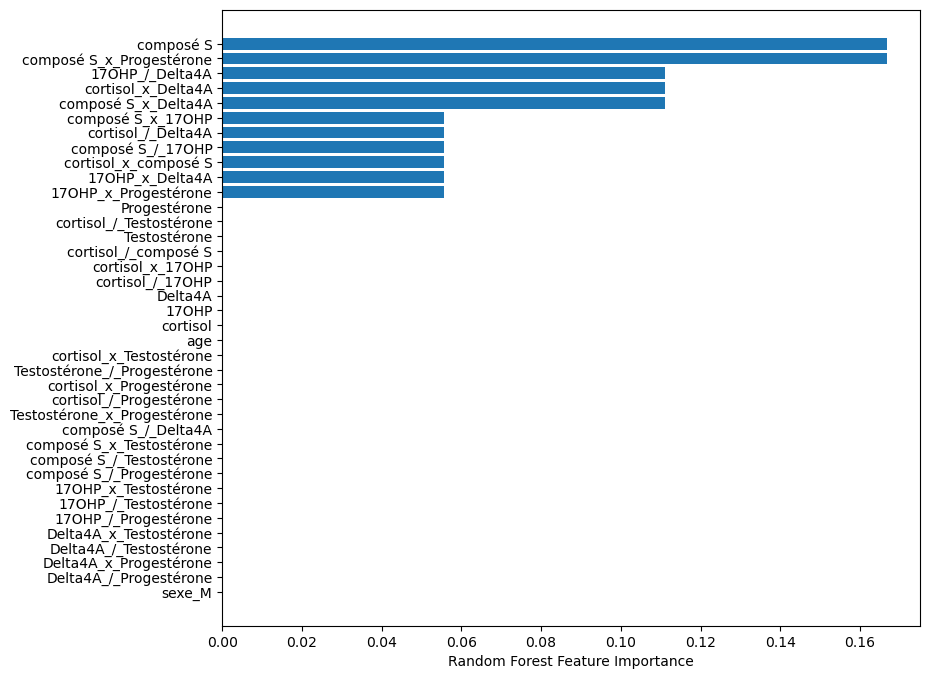

In [ ]:
sorted_idx = rf_classifier.feature_importances_.argsort()
plt.figure(figsize=(9,8))
plt.barh(X_train_prep.columns[sorted_idx],rf_classifier.feature_importances_[sorted_idx])
plt.xlabel("Random Forest Feature Importance")
plt.show()

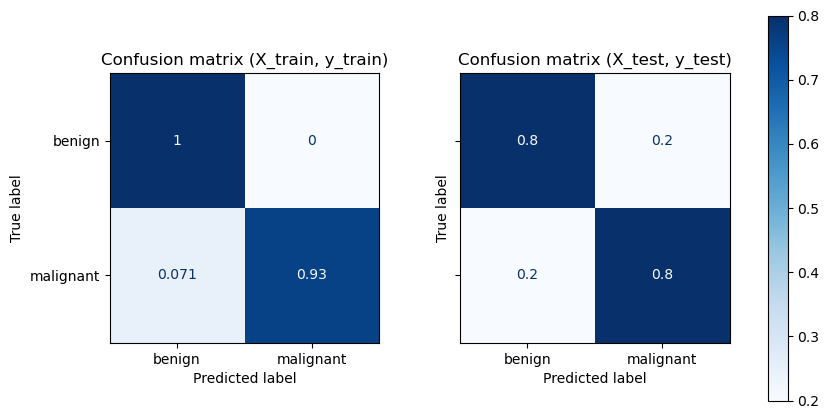

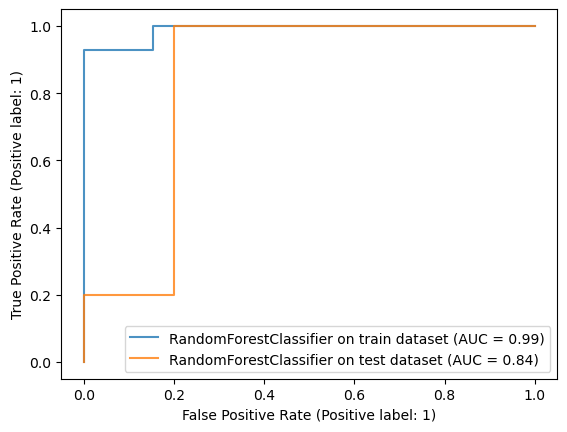

<Figure size 2000x500 with 0 Axes>

Detailed classification report:

The model is trained on the full development set.
The scores are computed on the full evaluation set.

              precision    recall  f1-score   support

           0       0.80      0.80      0.80         5
           1       0.80      0.80      0.80         5

    accuracy                           0.80        10
   macro avg       0.80      0.80      0.80        10
weighted avg       0.80      0.80      0.80        10




In [ ]:
eval_algo_train_and_test(X_test_prep, y_test,X_train_prep, y_train, rf_classifier)

NB : 
- optimisation du random forest tbd.
- xgboot
- au vu des erreurs faites qui ressemblent plus à des anomalies qu'autre chose, ça ne se jouera pas au niveau de l'algo mais plus au niveau de surcouche pour les cas particuliers
- le code a été réalisé de façon suffisamment générique pour que l'on puisse modifier l'entrée en ajoutant les traitements supplémentaires des phases (2) et (3) de l'entrée, on peaufinera les algos à ce moment

## XGBoost Classifier

In [ ]:
import xgboost as xgb

In [ ]:
import xgboost as xgb

xgb_classif = xgb.XGBClassifier(
    objective= 'binary:logistic',
    nthread=4,
)

parameters = {
    'max_depth': range (2, 10, 1),
    'n_estimators': range(60, 220, 40),
    'learning_rate': [0.1, 0.05, 0.01 ]
}

grid_search = GridSearchCV(
    estimator=xgb_classif,
    param_grid=parameters,
    scoring = 'roc_auc',
    n_jobs = 10,
    cv = 5,
    verbose=True
)

In [ ]:
grid_search.fit(X_train_prep[selected_features], y_train)
xgb_classifier_best = grid_search.best_estimator_

Fitting 5 folds for each of 96 candidates, totalling 480 fits


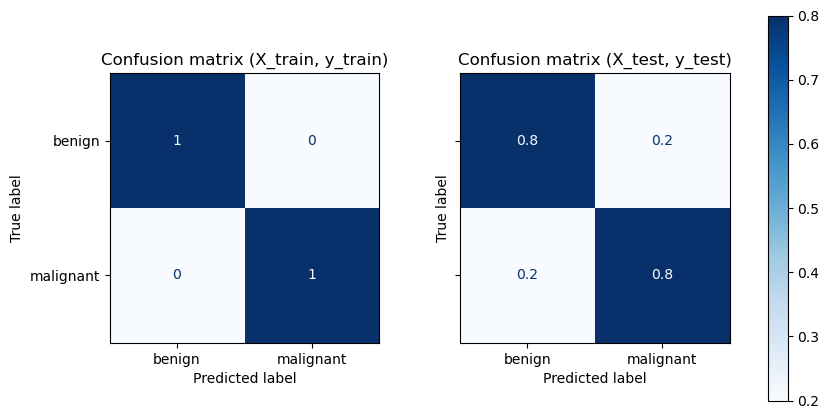

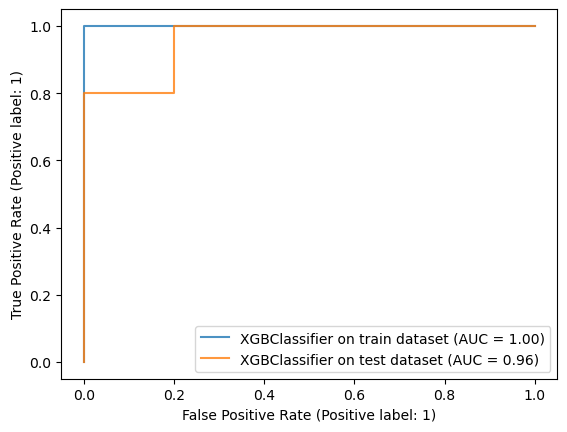

<Figure size 2000x500 with 0 Axes>

Detailed classification report:

The model is trained on the full development set.
The scores are computed on the full evaluation set.

              precision    recall  f1-score   support

           0       0.80      0.80      0.80         5
           1       0.80      0.80      0.80         5

    accuracy                           0.80        10
   macro avg       0.80      0.80      0.80        10
weighted avg       0.80      0.80      0.80        10




In [ ]:
xgb_classifier_best
eval_algo_train_and_test(X_test_prep[selected_features],y_test,X_train_prep[selected_features], y_train,xgb_classifier_best)

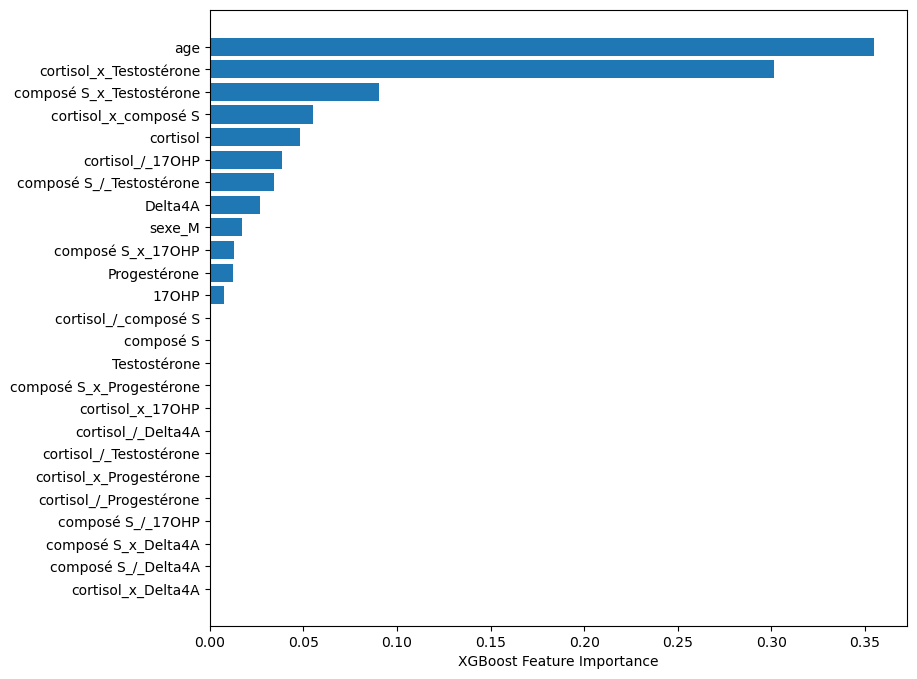

In [ ]:
sorted_idx = xgb_classifier_best.feature_importances_.argsort()
plt.figure(figsize=(9,8))
plt.barh(X_train_prep.columns[sorted_idx],xgb_classifier_best.feature_importances_[sorted_idx])
plt.xlabel("XGBoost Feature Importance")
plt.show()

In [ ]:
grid_search_mm = GridSearchCV(
    estimator=xgb_classif,
    param_grid=parameters,
    scoring = 'roc_auc',
    n_jobs = 10,
    cv = 5,
    verbose=True
)

In [ ]:
grid_search_mm.fit(X_train_prep_minmax, y_train)
xgb_classifier_mm_best = grid_search_mm.best_estimator_

Fitting 5 folds for each of 96 candidates, totalling 480 fits


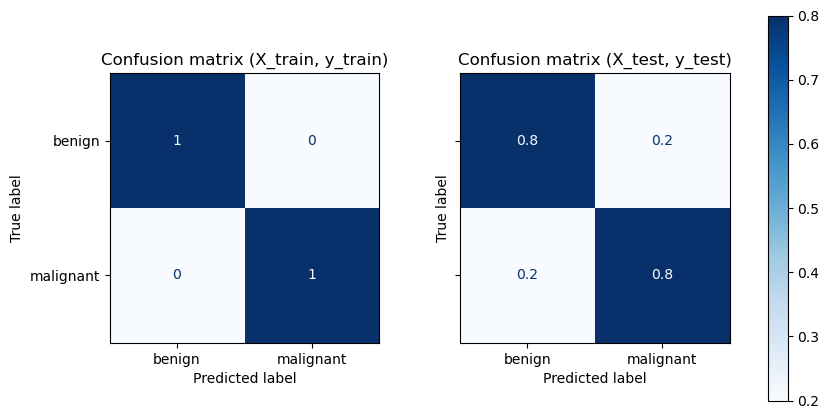

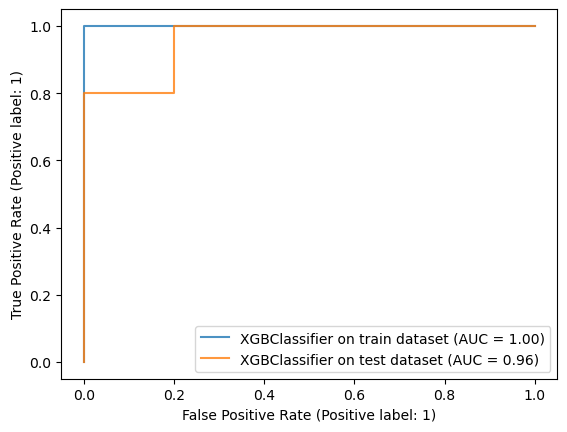

<Figure size 2000x500 with 0 Axes>

Detailed classification report:

The model is trained on the full development set.
The scores are computed on the full evaluation set.

              precision    recall  f1-score   support

           0       0.80      0.80      0.80         5
           1       0.80      0.80      0.80         5

    accuracy                           0.80        10
   macro avg       0.80      0.80      0.80        10
weighted avg       0.80      0.80      0.80        10




In [ ]:
xgb_classifier_mm_best.fit(X_train_prep_minmax, y_train['label'])
eval_algo_train_and_test(X_test_prep_minmax,y_test,X_train_prep_minmax, y_train,xgb_classifier_mm_best)

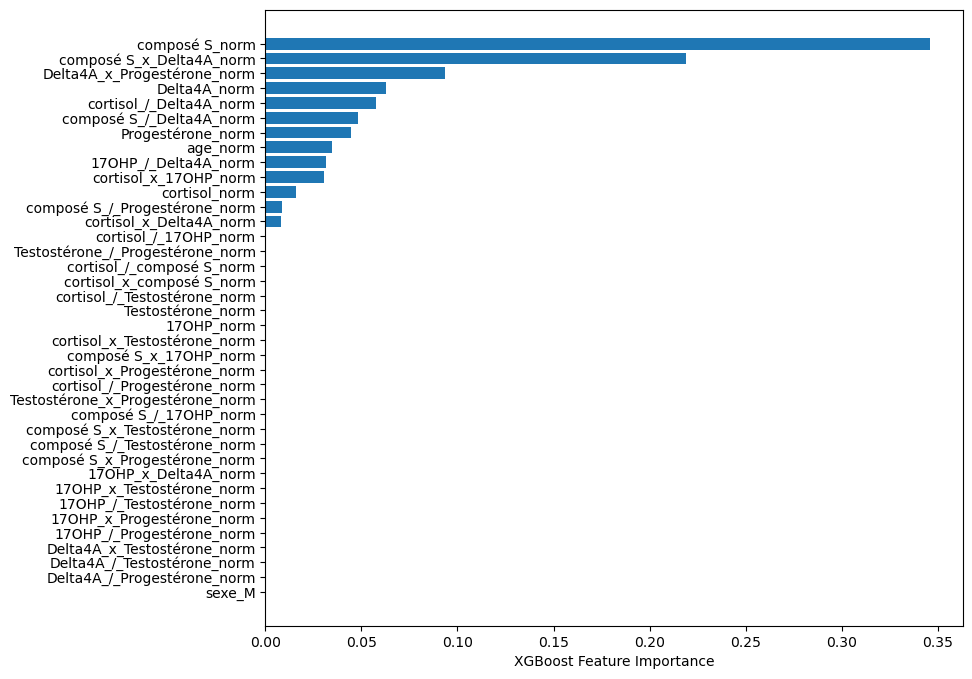

In [ ]:
sorted_idx = xgb_classifier_mm_best.feature_importances_.argsort()
plt.figure(figsize=(9,8))
plt.barh(X_train_prep_minmax.columns[sorted_idx],xgb_classifier_mm_best.feature_importances_[sorted_idx])
plt.xlabel("XGBoost Feature Importance")
plt.show()

#### XAI explainer xgb

In [ ]:
explainer = shap.Explainer(xgb_classifier_mm_best.predict, X_test_prep_minmax, feature_names=X_test_prep_minmax.columns)
shap_values_prep_minmax = explainer(X_test_prep_minmax)
print(f"Shap values length: {len(shap_values_prep_minmax)}\n")
print(f"Sample shap value:\n{shap_values_prep_minmax[0]}")

Shap values length: 10

Sample shap value:
.values =
array([ 0.        , -0.025     ,  0.00833333, -0.25      ,  0.        ,
        0.00833333,  0.        ,  0.        ,  0.        ,  0.        ,
        0.00833333,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
       -0.31666667,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.06666667,
        0.        ,  0.        ,  0.        ])

.base_values =
0.5

.data =
array([ 0.00000000e+00, -3.07692308e-02,  3.38192114e-01,  2.96892436e-02,
        1.05072464e-01,  7.35646889e-03,  9.03361345e-03,  1.10163447e+00,
        3.14753515e-02,  2.52833099e-01,  1.27686304e-01,  1.20298319e-01,
        8.67326163e-03,  2.04106264e-01,  1.01321185e-02,  1.90330325e-01,
        1.36250928e+00,  3.55125365e-03,  4.96331215e-03,  3.508794

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


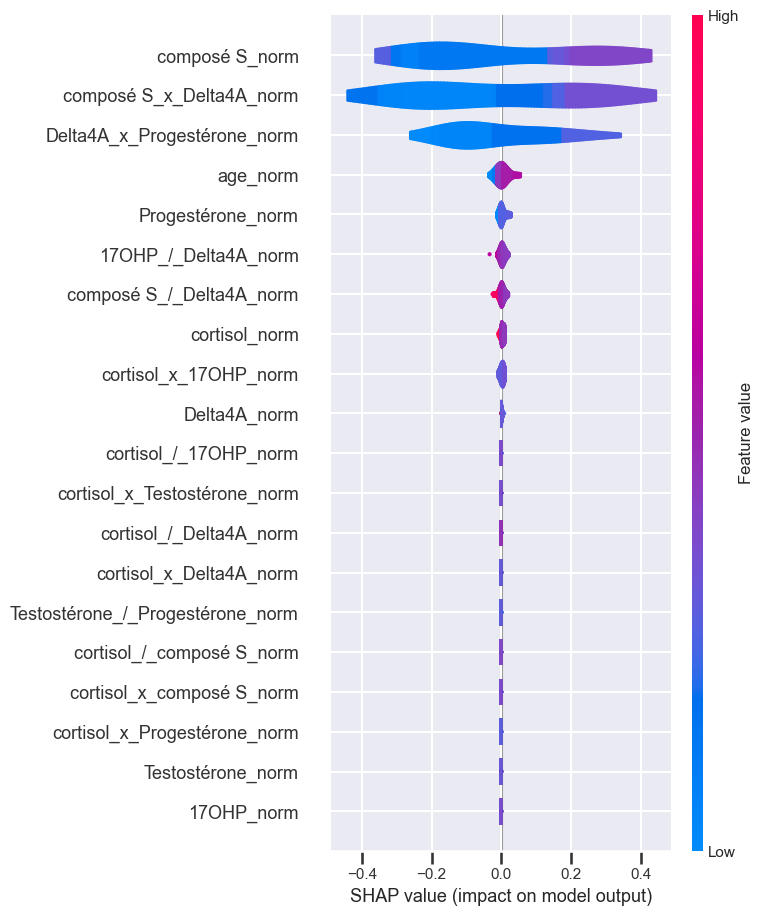

In [ ]:
shap.summary_plot(shap_values_prep_minmax, plot_type='violin')

### XGB classifier with norm

In [ ]:
grid_search_norm = GridSearchCV(
    estimator=xgb_classif,
    param_grid=parameters,
    scoring = 'roc_auc',
    n_jobs = 10,
    cv = 10,
    verbose=True
)

In [ ]:
grid_search_norm.fit(X_train_prep_norm, y_train)
xgb_classifier_norm_best = grid_search_norm.best_estimator_

Fitting 10 folds for each of 96 candidates, totalling 960 fits


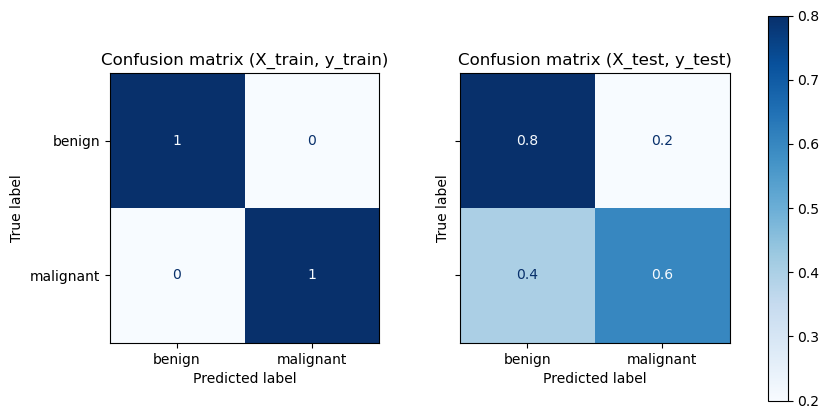

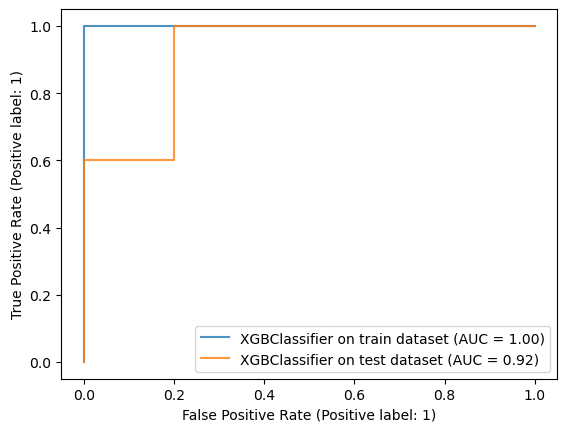

<Figure size 2000x500 with 0 Axes>

Detailed classification report:

The model is trained on the full development set.
The scores are computed on the full evaluation set.

              precision    recall  f1-score   support

           0       0.67      0.80      0.73         5
           1       0.75      0.60      0.67         5

    accuracy                           0.70        10
   macro avg       0.71      0.70      0.70        10
weighted avg       0.71      0.70      0.70        10




In [ ]:
xgb_classifier_norm_best.fit(X_train_prep_norm, y_train['label'])
eval_algo_train_and_test(X_test_prep_norm,y_test,X_train_prep_norm, y_train,xgb_classifier_norm_best)

# Sauver & charger les prépocesseurs et modèles
Nb : utilisation de pickle

## Pipeline avec min-max scaling, réduction de dimensions, Features selection et Régression logistique

In [ ]:
mycols = [0,9,12,16,17] #décal d'un indice à gauche

col_select = Pipeline([
    ("selector", ColumnTransformer([
        ("selector", "passthrough", mycols)
    ], remainder="drop"))
])

In [ ]:
test = preprocred.transform(X_test)

In [ ]:
pd.DataFrame(col_select.fit_transform(test))

,0,1,2,3,4
0,0.059493,0.281973,0.252833,0.204106,-0.030769
1,0.096545,0.054166,0.062692,0.141133,0.246154
2,0.048436,0.117145,0.054611,0.139435,0.753846
3,0.002923,0.110239,0.508708,0.717036,0.569231
4,0.040804,0.105417,0.073682,0.060235,0.430769
5,0.061693,0.191455,0.192574,0.391856,0.646154
6,0.007226,0.170369,0.464495,0.438470,0.630769
7,0.006960,0.162546,0.813720,0.450745,0.184615
8,0.001839,0.263525,0.749687,0.463884,0.507692
9,0.044931,0.070981,0.196959,0.046169,0.000000


In [ ]:
pd.DataFrame(test)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
0,0.059493,0.016576,1.232072,0.579709,0.001837,0.049218,0.041413,0.003551,0.120298,0.281973,0.818635,0.0,0.252833,0.338192,0.364596,0.190330,0.204106,-0.030769,0.127686,0.000169
1,0.096545,0.008928,0.131916,0.024070,0.007040,0.261160,0.013896,0.221471,0.365150,0.054166,0.318889,0.0,0.062692,0.335885,0.619346,0.223505,0.141133,0.246154,0.036210,0.103047
2,0.048436,0.005229,0.053789,0.017143,0.010451,0.204534,0.012349,0.189369,0.188796,0.117145,0.437207,0.0,0.054611,0.122064,0.445301,0.158765,0.139435,0.753846,0.018632,0.101235
3,0.002923,0.000349,0.016902,-0.000528,0.001975,0.112470,-0.003664,0.282079,1.068694,0.110239,0.131352,0.0,0.508708,0.078282,0.161295,0.300772,0.717036,0.569231,-0.008779,0.014676
4,0.040804,0.018864,0.030491,0.028950,0.041706,0.064385,0.046363,0.324852,0.083961,0.105417,0.284598,0.0,0.073682,0.158242,0.327948,0.050321,0.060235,0.430769,0.069421,0.126985
5,0.061693,0.004317,0.399751,0.079410,0.002999,0.157445,0.016704,0.119972,0.351620,0.191455,0.807836,0.0,0.192574,0.507131,0.516535,0.516281,0.391856,0.646154,0.077537,0.018896
6,0.007226,0.003110,0.015487,0.003159,0.013503,0.062165,0.006773,0.567128,0.440061,0.170369,0.236986,0.0,0.464495,0.219117,0.181218,0.205546,0.438470,0.630769,0.011560,0.034711
7,0.006960,0.001946,0.350865,0.041846,-0.000176,0.039287,0.003808,0.051408,0.472681,0.162546,0.521118,0.0,0.813720,0.247903,0.393335,0.453252,0.450745,0.184615,0.013336,-0.000639
8,0.001839,0.001246,0.018633,0.004507,0.008663,0.035574,0.003074,0.311806,0.308572,0.263525,0.576709,0.0,0.749687,0.103083,0.276823,0.329725,0.463884,0.507692,0.004405,0.010058
9,0.044931,0.030777,0.317665,0.213071,0.014392,0.024202,0.068623,0.108115,0.090583,0.070981,0.574401,0.0,0.196959,0.391149,0.872032,0.104743,0.046169,0.000000,0.206642,0.016662


In [ ]:
with open('preprocred.pkl', 'wb') as f:
    dump(preprocred, f)

In [ ]:
with open('preprocred.pkl', 'rb') as f:
    preprocred = load(f)

In [ ]:
preprocred.transform(X_test)

array([[ 5.94925075e-02,  1.65755473e-02,  1.23207187e+00,
         5.79709162e-01,  1.83660289e-03,  4.92184419e-02,
         4.14127319e-02,  3.55125365e-03,  1.20298319e-01,
         2.81972661e-01,  8.18635321e-01,  0.00000000e+00,
         2.52833099e-01,  3.38192114e-01,  3.64595531e-01,
         1.90330325e-01,  2.04106264e-01, -3.07692308e-02,
         1.27686304e-01,  1.69439060e-04],
       [ 9.65449549e-02,  8.92797396e-03,  1.31916077e-01,
         2.40702915e-02,  7.03995576e-03,  2.61160407e-01,
         1.38959997e-02,  2.21470548e-01,  3.65149869e-01,
         5.41659792e-02,  3.18888801e-01,  0.00000000e+00,
         6.26918908e-02,  3.35885067e-01,  6.19346106e-01,
         2.23505376e-01,  1.41133155e-01,  2.46153846e-01,
         3.62095470e-02,  1.03046705e-01],
       [ 4.84359255e-02,  5.22918111e-03,  5.37885280e-02,
         1.71427442e-02,  1.04505938e-02,  2.04533905e-01,
         1.23486506e-02,  1.89369138e-01,  1.88796068e-01,
         1.17145229e-01,  4.3

In [ ]:
process_model = Pipeline(steps=[('prepocessor',preprocred),("selector", col_select),("model",log_reg_red)])

In [ ]:
set_config(display="diagram")
process_model

Pipeline(steps=[('prepocessor',
                 Pipeline(steps=[('prepocessor',
                                  ColumnTransformer(remainder='passthrough',
                                                    transformers=[('drop',
                                                                   FunctionTransformer(func=<function columns_drop at 0x0000020C88B2A9D0>),
                                                                   ['id']),
                                                                  ('categorical',
                                                                   Pipeline(steps=[('imp_mode',
                                                                                    SimpleImputer(strategy='most_frequent')),
                                                                                   ('one_hot',
                                                                                    OneHotEncoder(drop='if_binary',
                                                                                                  handle_unknown='ignor...
                                                                                    Pipeline(steps=[('norm',
                                                                                                     MinMaxScaler())]))]),
                                                                   ['cortisol',
                                                                    'composé S',
                                                                    '17OHP',
                                                                    'Delta4A',
                                                                    'Testostérone',
                                                                    'Progestérone'])])),
                                 ('reduce_dim',
                                  FeatureAgglomeration(n_clusters=20))])),
                ('selector',
                 Pipeline(steps=[('selector',
                                  ColumnTransformer(transformers=[('selector',
                                                                   'passthrough',
                                                                   [0, 9, 12,
                                                                    16,
                                                                    17])]))])),
                ('model',
                 LogisticRegressionCV(class_weight='balanced', cv=5,
                                      max_iter=500))])

In [ ]:
process_model.fit(X_train,y_train['label'])

Pipeline(steps=[('prepocessor',
                 Pipeline(steps=[('prepocessor',
                                  ColumnTransformer(remainder='passthrough',
                                                    transformers=[('drop',
                                                                   FunctionTransformer(func=<function columns_drop at 0x0000020C88B2A9D0>),
                                                                   ['id']),
                                                                  ('categorical',
                                                                   Pipeline(steps=[('imp_mode',
                                                                                    SimpleImputer(strategy='most_frequent')),
                                                                                   ('one_hot',
                                                                                    OneHotEncoder(drop='if_binary',
                                                                                                  handle_unknown='ignor...
                                                                                    Pipeline(steps=[('norm',
                                                                                                     MinMaxScaler())]))]),
                                                                   ['cortisol',
                                                                    'composé S',
                                                                    '17OHP',
                                                                    'Delta4A',
                                                                    'Testostérone',
                                                                    'Progestérone'])])),
                                 ('reduce_dim',
                                  FeatureAgglomeration(n_clusters=20))])),
                ('selector',
                 Pipeline(steps=[('selector',
                                  ColumnTransformer(transformers=[('selector',
                                                                   'passthrough',
                                                                   [0, 9, 12,
                                                                    16,
                                                                    17])]))])),
                ('model',
                 LogisticRegressionCV(class_weight='balanced', cv=5,
                                      max_iter=500))])

In [ ]:
disp_pred_true = y_test.copy()
disp_pred_true['pred'] = process_model.predict(X_test)
disp_pred_true

,label,pred
21,1,0
2,1,1
35,1,1
16,0,0
36,1,1
8,1,1
18,0,0
28,0,0
26,0,0
22,0,0


In [ ]:
X_test

,id,sexe,age,cortisol,composé S,17OHP,Delta4A,Testostérone,Progestérone
21,21-033,F,24,495.30,3.920,2.33,1.940,0.63,3.83
2,19-035,F,42,493.10,14.290,0.82,2.780,0.535,0.495
35,22-026,F,75,289.20,9.450,0.9,1.650,0.44,0.333
16,21-003,F,63,247.45,0.990,0.144,0.278,<0.2,<0.2
36,22-xxx,F,54,323.70,8.130,2.09,4.190,1.51,0.23
8,20-002,F,68,656.40,6.750,1.132,1.346,0.31,1.108
18,21-018,F,67,381.75,1.670,<0.53,0.700,0.45,0.161
28,21-043,F,38,409.20,1.030,<0.53,0.730,0.22,1.28
26,21-041,F,59,271.10,0.740,<0.53,0.470,<0.2,<0.2
22,21-031,F,26,545.80,5.493,3.30,9.120,1.25,1.001


In [ ]:
process_model

Pipeline(steps=[('prepocessor',
                 Pipeline(steps=[('prepocessor',
                                  ColumnTransformer(remainder='passthrough',
                                                    transformers=[('drop',
                                                                   FunctionTransformer(func=<function columns_drop at 0x0000020C88B2A9D0>),
                                                                   ['id']),
                                                                  ('categorical',
                                                                   Pipeline(steps=[('imp_mode',
                                                                                    SimpleImputer(strategy='most_frequent')),
                                                                                   ('one_hot',
                                                                                    OneHotEncoder(drop='if_binary',
                                                                                                  handle_unknown='ignor...
                                                                                    Pipeline(steps=[('norm',
                                                                                                     MinMaxScaler())]))]),
                                                                   ['cortisol',
                                                                    'composé S',
                                                                    '17OHP',
                                                                    'Delta4A',
                                                                    'Testostérone',
                                                                    'Progestérone'])])),
                                 ('reduce_dim',
                                  FeatureAgglomeration(n_clusters=20))])),
                ('selector',
                 Pipeline(steps=[('selector',
                                  ColumnTransformer(transformers=[('selector',
                                                                   'passthrough',
                                                                   [0, 9, 12,
                                                                    16,
                                                                    17])]))])),
                ('model',
                 LogisticRegressionCV(class_weight='balanced', cv=5,
                                      max_iter=500))])

In [ ]:
with open('predict_red.pkl', 'wb') as f:
    dump(process_model, f)

In [ ]:
with open('predict_red.pkl', 'rb') as f:
    process_model_l = load(f)

In [ ]:
process_model_l.predict(X_test)

array([0, 1, 1, 0, 1, 1, 0, 0, 0, 0], dtype=int64)

## Pipeline avec arbre de décision

In [ ]:
process_dt = Pipeline(steps=[('preprocf',preprocf),("model",dt_classifier)])

In [ ]:
process_dt

Pipeline(steps=[('preprocf',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('drop',
                                                  FunctionTransformer(func=<function columns_drop at 0x0000020C88B2A9D0>),
                                                  ['id']),
                                                 ('categorical',
                                                  Pipeline(steps=[('imp_mode',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('one_hot',
                                                                   OneHotEncoder(drop='if_binary',
                                                                                 handle_unknown='ignore'))]),
                                                  ['sexe']),
                                                 ('numerical',
                                                  Pipe...
                                                  Pipeline(steps=[('numerize',
                                                                   Pipeline(steps=[('num',
                                                                                    FunctionTransformer(func=<function num_encoder at 0x0000020C8A2DB8B0>)),
                                                                                   ('imputer',
                                                                                    SimpleImputer())])),
                                                                  ('cross_features',
                                                                   <__main__.DataframeFunctionTransformer object at 0x0000020C88B93070>)]),
                                                  ['cortisol', 'composé S',
                                                   '17OHP', 'Delta4A',
                                                   'Testostérone',
                                                   'Progestérone'])])),
                ('model', DecisionTreeClassifier())])

In [ ]:
process_dt.predict(X_test)

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\base.py:439: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(


array([1, 1, 1, 0, 1, 1, 0, 0, 0, 1], dtype=int64)

In [ ]:
with open('predict_dtc.pkl', 'wb') as f:
    dump(process_dt, f)

In [ ]:
with open('predict_dtc.pkl', 'rb') as f:
    process_dt_l = load(f)

In [ ]:
 process_dt_l.predict(X_test)

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\base.py:439: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(


array([1, 1, 1, 0, 1, 1, 0, 0, 0, 1], dtype=int64)

## Pipeline avec XGBoost Classifier

In [ ]:
feat_select = featureSelect_dataframe(X_train_prep, y_train, chi2, 25).columns
feat_select_ind = X_train_prep.columns.get_indexer(featureSelect_dataframe(X_train_prep, y_train, chi2, 25).columns)

feat_selector = Pipeline([
    ("selector", ColumnTransformer([
        ("selector", "passthrough", feat_select_ind)
    ], remainder="drop"))
])

In [ ]:
test_selec_input = preprocf.transform(X_test)

In [ ]:
xgb_classifier_best.predict(feat_selector.fit_transform(test_selec_input))

array([0, 1, 1, 0, 1, 1, 0, 0, 0, 1])

In [ ]:
process_xgb = Pipeline(steps=[('prepocessor',preprocf),("chi2 features selector", feat_selector),("XGB model",xgb_classifier_best)])

In [ ]:
process_xgb.predict(X_test)

array([0, 1, 1, 0, 1, 1, 0, 0, 0, 1])

In [ ]:
with open('predict_xgb.pkl', 'wb') as f:
    dump(process_xgb, f)

In [ ]:
with open('predict_xgb.pkl', 'rb') as f:
    process_xgb_l = load(f)

In [ ]:
process_xgb_l.predict(X_test)

array([0, 1, 1, 0, 1, 1, 0, 0, 0, 1])

In [ ]:
process_xgb_l

Pipeline(steps=[('prepocessor',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('drop',
                                                  FunctionTransformer(func=<function columns_drop at 0x0000020C88B2A9D0>),
                                                  ['id']),
                                                 ('categorical',
                                                  Pipeline(steps=[('imp_mode',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('one_hot',
                                                                   OneHotEncoder(drop='if_binary',
                                                                                 handle_unknown='ignore'))]),
                                                  ['sexe']),
                                                 ('numerical',
                                                  P...
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_policy=None, importance_type=None,
                               interaction_constraints=None, learning_rate=0.05,
                               max_bin=None, max_cat_threshold=None,
                               max_cat_to_onehot=None, max_delta_step=None,
                               max_depth=2, max_leaves=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, n_estimators=60,
                               n_jobs=None, nthread=4, num_parallel_tree=None,
                               predictor=None, ...))])

# Charger le fichier de test sans label dans un .csv

In [ ]:
X_test

,id,sexe,age,cortisol,composé S,17OHP,Delta4A,Testostérone,Progestérone
21,21-033,F,24,495.30,3.920,2.33,1.940,0.63,3.83
2,19-035,F,42,493.10,14.290,0.82,2.780,0.535,0.495
35,22-026,F,75,289.20,9.450,0.9,1.650,0.44,0.333
16,21-003,F,63,247.45,0.990,0.144,0.278,<0.2,<0.2
36,22-xxx,F,54,323.70,8.130,2.09,4.190,1.51,0.23
8,20-002,F,68,656.40,6.750,1.132,1.346,0.31,1.108
18,21-018,F,67,381.75,1.670,<0.53,0.700,0.45,0.161
28,21-043,F,38,409.20,1.030,<0.53,0.730,0.22,1.28
26,21-041,F,59,271.10,0.740,<0.53,0.470,<0.2,<0.2
22,21-031,F,26,545.80,5.493,3.30,9.120,1.25,1.001


In [ ]:
X_test.to_csv('export_X_test_metabo.csv', index=False, header=True, sep=';')

In [ ]:
X_test.iloc[1]

id              19-035
sexe                 F
age                 42
cortisol         493.1
composé S        14.29
17OHP             0.82
Delta4A           2.78
Testostérone     0.535
Progestérone     0.495
Name: 2, dtype: object

In [ ]:
process_model_l.predict_proba(X_test)[:,1]*100

array([ 8.09283899, 79.45398018, 97.20406353, 10.3994351 , 89.81007883,
       72.58089759, 30.7411813 ,  0.66966876,  2.78283616, 39.24591891])

In [ ]:
process_model_l.predict(X_test)

array([0, 1, 1, 0, 1, 1, 0, 0, 0, 0], dtype=int64)

In [ ]:
y_test

,label
21,1
2,1
35,1
16,0
36,1
8,1
18,0
28,0
26,0
22,0


# Conclusion rapide
- L'arbre de décision a un recall à 1 (on ne loupera pas de tumeurs malignes et une bonne précision, de plus il possède un bon pouvoir explicatif et a un auc de 0.90) --> Très bon candidat
- XGBoost est pas mal est a un auc élevé (0.96) malgré ses 2 erreurs de classification, à verif, pouvoir explicatif élevé également mais légèrement moins qu'un arbre de décision
- la régression logistique avec réduction de dimension et sélection de features donne un résultat intéressant  et une erreur de classification sur l'individu "outlier", auc plus bas..., pouvoir explicatif faible niveau métier.

Les 3 modèles s'appuient sur des variables et philosophies différentes donc il peut-être intéressant de conserver les 3 et de les faire agir en consensus pour nos prédictions (quelque soit le modèle, l'individu "outlier" est toujours mal classé. Le classifieur le plus abouti compilera les 3 modèles directement dans notre application en laissant les cas qui ne font pas consensus aux mains des praticiens.